In [1]:
import pandas as pd
import numpy as np
import sklearn
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import LabelEncoder

import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.font_manager as fm
font_name = fm.FontProperties(fname = 'C:\\Windows\\Fonts\\malgun.ttf').get_name()
plt.rc('font', family = font_name)
mpl.rcParams['axes.unicode_minus'] = False

### 1) 데이터 수집, 컬럼 확인

In [2]:
train= pd.read_csv("data/new_train.csv")
train.head()

,Unnamed: 0,REG_YYMM,CARD_SIDO_NM,CARD_CCG_NM,STD_CLSS_NM,HOM_SIDO_NM,HOM_CCG_NM,AGE,SEX_CTGO_CD,FLC,CSTMR_CNT,AMT,CNT,user
0,0,201901,강원,강릉시,건강보조식품 소매업,강원,강릉시,20s,1,1,4,311200,4,20s1
1,1,201901,강원,강릉시,건강보조식품 소매업,강원,강릉시,30s,1,2,7,1374500,8,30s1
2,2,201901,강원,강릉시,건강보조식품 소매업,강원,강릉시,30s,2,2,6,818700,6,30s2
3,3,201901,강원,강릉시,건강보조식품 소매업,강원,강릉시,40s,1,3,4,1717000,5,40s1
4,4,201901,강원,강릉시,건강보조식품 소매업,강원,강릉시,40s,1,4,3,1047300,3,40s1


In [3]:
test4=pd.read_csv("data/202004.csv")
test4.head()

,REG_YYMM,CARD_SIDO_NM,CARD_CCG_NM,STD_CLSS_NM,HOM_SIDO_NM,HOM_CCG_NM,AGE,SEX_CTGO_CD,FLC,CSTMR_CNT,AMT,CNT
0,202004,강원,강릉시,건강보조식품 소매업,강원,강릉시,40s,1,3,3,779600,4
1,202004,강원,강릉시,건강보조식품 소매업,강원,강릉시,40s,2,3,14,2427700,15
2,202004,강원,강릉시,건강보조식품 소매업,강원,강릉시,50s,1,4,18,2184600,18
3,202004,강원,강릉시,건강보조식품 소매업,강원,강릉시,50s,2,4,21,3653100,23
4,202004,강원,강릉시,건강보조식품 소매업,강원,강릉시,60s,1,5,15,2765500,18


In [67]:
td4 = test4[["CARD_SIDO_NM","STD_CLSS_NM","AMT"]].groupby(["CARD_SIDO_NM","STD_CLSS_NM"]).sum()
td4.loc["인천"].loc["호텔업"]

#td4 =td4.reset_index()
#td4.sort_values(by="AMT", ascending=False)

AMT    1021700
Name: 호텔업, dtype: int64

In [16]:
td4.loc["택시 운송업"]

AMT    87229031655
Name: 택시 운송업, dtype: int64

In [30]:
td3 =train[["REG_YYMM","CARD_SIDO_NM","STD_CLSS_NM","AMT"]].groupby(["REG_YYMM","CARD_SIDO_NM","STD_CLSS_NM"]).sum()
td3

AMT
REG_YYMM CARD_SIDO_NM STD_CLSS_NM                       
201901   강원           건강보조식품 소매업               148354746
                      골프장 운영업                 1229200312
                      과실 및 채소 소매업             1286979106
                      관광 민예품 및 선물용품 소매업         30656770
                      그외 기타 스포츠시설 운영업           13101500
...                                                  ...
202003   충북           피자 햄버거 샌드위치 및 유사 음식점업   1315245299
                      한식 음식점업                16152482704
                      호텔업                       15248550
                      화장품 및 방향제 소매업            428881434
                      휴양콘도 운영업                  12733490

[9438 rows x 1 columns]

In [42]:
td3.loc[201912].loc["제주"]

,AMT
STD_CLSS_NM,
건강보조식품 소매업,76101850
골프장 운영업,1378487844
과실 및 채소 소매업,985810272
관광 민예품 및 선물용품 소매업,282185199
그외 기타 분류안된 오락관련 서비스업,396000
그외 기타 스포츠시설 운영업,452900
그외 기타 종합 소매업,1994679850
기타 대형 종합 소매업,5443154670
기타 수상오락 서비스업,2254300


In [ ]:
##################################################### 전처리까지 완료된 데이터 ############################################

In [36]:
mc4 = test4[["REG_YYMM","AMT"]].groupby("REG_YYMM").sum()
mc4=mc4.reset_index()
mc4

,REG_YYMM,AMT
0,202004,3542539370072


In [19]:
mc = train[["REG_YYMM","AMT"]].groupby("REG_YYMM").sum()
mc=mc.reset_index()
mc

,REG_YYMM,AMT
0,201901,4052317259025
1,201902,3634345832156
2,201903,4105409759731
3,201904,4006698507386
4,201905,4345471235813
5,201906,4122105394194
6,201907,4187299694709
7,201908,4268655968810
8,201909,4123348058794
9,201910,4176583723584


In [22]:
mc["AMT"][4]

4345471235813

In [28]:
for i in range(len(mc["REG_YYMM"])) :
    if i == 0 :  
        mc["rate"][0] = 0
    else :
        mc["rate"][i] = (mc["AMT"][i]-mc["AMT"][i-1])/mc["AMT"][i-1] * 100
        
mc        

C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """


,REG_YYMM,AMT,rate
0,201901,4052317259025,0.000000
1,201902,3634345832156,-10.314381
2,201903,4105409759731,12.961450
3,201904,4006698507386,-2.404419
4,201905,4345471235813,8.455159
5,201906,4122105394194,-5.140198
6,201907,4187299694709,1.581578
7,201908,4268655968810,1.942929
8,201909,4123348058794,-3.404067
9,201910,4176583723584,1.291079


In [137]:
# train= pd.read_csv("data/201901-202003.csv")
# train.head()

,REG_YYMM,CARD_SIDO_NM,CARD_CCG_NM,STD_CLSS_NM,HOM_SIDO_NM,HOM_CCG_NM,AGE,SEX_CTGO_CD,FLC,CSTMR_CNT,AMT,CNT
0,201901,강원,강릉시,건강보조식품 소매업,강원,강릉시,20s,1,1,4,311200,4
1,201901,강원,강릉시,건강보조식품 소매업,강원,강릉시,30s,1,2,7,1374500,8
2,201901,강원,강릉시,건강보조식품 소매업,강원,강릉시,30s,2,2,6,818700,6
3,201901,강원,강릉시,건강보조식품 소매업,강원,강릉시,40s,1,3,4,1717000,5
4,201901,강원,강릉시,건강보조식품 소매업,강원,강릉시,40s,1,4,3,1047300,3


In [3]:
train.isnull().sum()

REG_YYMM             0
CARD_SIDO_NM         0
CARD_CCG_NM      87213
STD_CLSS_NM          0
HOM_SIDO_NM          0
HOM_CCG_NM      147787
AGE                  0
SEX_CTGO_CD          0
FLC                  0
CSTMR_CNT            0
AMT                  0
CNT                  0
dtype: int64

In [4]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24697792 entries, 0 to 24697791
Data columns (total 12 columns):
 #   Column        Dtype 
---  ------        ----- 
 0   REG_YYMM      int64 
 1   CARD_SIDO_NM  object
 2   CARD_CCG_NM   object
 3   STD_CLSS_NM   object
 4   HOM_SIDO_NM   object
 5   HOM_CCG_NM    object
 6   AGE           object
 7   SEX_CTGO_CD   int64 
 8   FLC           int64 
 9   CSTMR_CNT     int64 
 10  AMT           int64 
 11  CNT           int64 
dtypes: int64(6), object(6)
memory usage: 2.2+ GB


In [4]:

# 지수표현식을 실수로 표현
pd.options.display.float_format = '{:.5f}'.format


In [6]:
# train.groupby["SEX_CTGO_CD","AGE","AMT"](["AGE"]).sum()

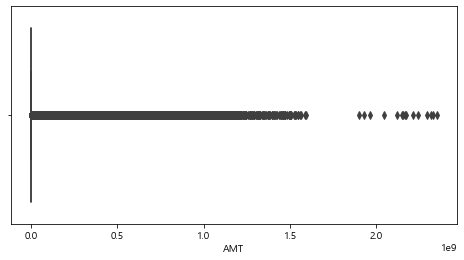

In [7]:


plt.figure(figsize=(8, 4))
sns.boxplot(train['AMT'])

In [8]:
pd.options.display.float_format = '{:.5f}'.format


In [9]:
#이용금액 (원)
train['AMT'].describe()

count     24697792.00000
mean       2441352.93750
std       17260959.04056
min             20.00000
25%          90200.00000
50%         252680.00000
75%         843337.25000
max     2349523701.00000
Name: AMT, dtype: float64

In [10]:
#이용고객수 (명)
train['CSTMR_CNT'].describe()

count   24697792.00000
mean          61.96855
std          355.91754
min            3.00000
25%            4.00000
50%            8.00000
75%           24.00000
max        32813.00000
Name: CSTMR_CNT, dtype: float64

In [11]:
#이용건수 (건)
train['CNT'].describe()

count   24697792.00000
mean         126.04497
std          966.93871
min            1.00000
25%            5.00000
50%           12.00000
75%           40.00000
max       120357.00000
Name: CNT, dtype: float64

In [12]:
#가구생애주기 
#1: 1인가구, 2: 영유아자녀가구, 3: 중고생자녀가구, 4: 성인자녀가구, 5: 노년가구
train['FLC'].describe()

count   24697792.00000
mean           2.80443
std            1.37546
min            1.00000
25%            2.00000
50%            3.00000
75%            4.00000
max            5.00000
Name: FLC, dtype: float64

In [13]:
print(len(train['FLC'].unique()))
train['FLC'].value_counts()

5


2    6188801
1    5526140
4    5445320
3    4054741
5    3482790
Name: FLC, dtype: int64

In [14]:
Q = train[["AGE",'SEX_CTGO_CD','AMT']].groupby(['AGE','SEX_CTGO_CD']).sum()

In [15]:
Q

AMT
AGE SEX_CTGO_CD               
10s 1              80118335986
    2              76556970587
20s 1            3917928860231
    2            3062600980517
30s 1            6997919172435
    2            4521430384037
40s 1            9064874458542
    2            5849532650837
50s 1            9695710427724
    2            6127202030817
60s 1            5463590604979
    2            3301433023375
70s 1            1333422145385
    2             803707003554

In [16]:
Q1 = train[["CARD_SIDO_NM",'SEX_CTGO_CD','AMT']].groupby(['CARD_SIDO_NM','SEX_CTGO_CD']).sum()
Q1

AMT
CARD_SIDO_NM SEX_CTGO_CD               
강원           1            1019422567091
             2             570188732828
경기           1            8661794600756
             2            5540090634113
경남           1            2304178777303
             2            1180951252561
경북           1            1877196231321
             2             890424363927
광주           1            1023179710022
             2             682470650912
대구           1            1694554554632
             2            1325509797972
대전           1             694241163056
             2             434672297660
부산           1            2578969699475
             2            1912336332066
서울           1            8190687845791
             2            6486443203240
세종           1             129540371792
             2              74505445556
울산           1             837354436562
             2             417859169178
인천           1            1848771565416
             2            1207475897497
전남           1            1263550774461
             2             576210002678
전북           1            1242817889230
             2             718412296111
제주           1             797625219172
             2             545957005596
충남           1            1418238579560
             2             684958795548
충북           1             971440019642
             2             493997166281

In [5]:
to=train[["CARD_SIDO_NM",'AMT']].groupby(['CARD_SIDO_NM']).sum().sort_values(by="AMT")
to = to.reset_index()
to.sort_values(by='AMT', ascending=False)

,CARD_SIDO_NM,AMT
16,서울,14677131049031
15,경기,14201885234869
14,부산,4491306031541
13,경남,3485130029864
12,인천,3056247462913
11,대구,3020064352604
10,경북,2767620595248
9,충남,2103197375108
8,전북,1961230185341
7,전남,1839760777139


In [18]:
#pd.reset_option('display.float_format') 다시 지수표현으로

In [19]:
#REG_YYMM 년월
print(len(train['REG_YYMM'].unique()))
train['REG_YYMM'].value_counts()


15


201908    1880296
201905    1772237
201910    1751005
201909    1734914
201907    1721353
201906    1712696
201912    1674381
202001    1672889
201903    1668675
201904    1655655
201911    1652905
201901    1607032
201902    1594266
202002    1338980
202003    1260508
Name: REG_YYMM, dtype: int64

In [20]:
#CARD_SIDO_NM  카드이용지역_시도 (가맹점 주소 기준)
print(len(train['CARD_SIDO_NM'].unique()))
train['CARD_SIDO_NM'].value_counts()

17


서울    6259502
경기    5188230
부산    2030810
인천    1278410
강원    1230355
경남    1222818
경북    1204831
충남    1178159
충북     834707
전북     829466
전남     819291
대구     758424
대전     523121
제주     497503
광주     432150
울산     322802
세종      87213
Name: CARD_SIDO_NM, dtype: int64

In [21]:
# CARD_CCG_NM  카드이용지역_시군구 (가맹점 주소 기준)
print(len(train['CARD_CCG_NM'].unique()))
train['CARD_CCG_NM'].value_counts()

227


중구     1185474
남구      512319
동구      509407
서구      501952
강서구     490111
        ...   
청양군      13894
신안군      10296
울릉군      10210
봉화군       9841
영양군       5728
Name: CARD_CCG_NM, Length: 226, dtype: int64

In [22]:
#STD_CLSS_NM   업종명
print(len(train['STD_CLSS_NM'].unique()))
train['STD_CLSS_NM'].value_counts()
# 제출데이터 : 시도별로 41개씩 (04,07월) 총 82개 다 채워져 있음.

41


한식 음식점업                  3697166
체인화 편의점                  3210466
슈퍼마켓                     1630700
차량용 주유소 운영업              1613476
비알콜 음료점업                 1586120
기타 대형 종합 소매업             1495163
서양식 음식점업                 1404839
피자 햄버거 샌드위치 및 유사 음식점업    1351478
빵 및 과자류 소매업               989794
중식 음식점업                   698803
기타음식료품위주종합소매업             558716
기타 외국식 음식점업               556813
일식 음식점업                   539071
과실 및 채소 소매업               504479
스포츠 및 레크레이션 용품 임대업        466533
화장품 및 방향제 소매업             383713
택시 운송업                    381993
그외 기타 종합 소매업              351817
여관업                       334994
전시 및 행사 대행업               330569
육류 소매업                    327160
욕탕업                       259567
수산물 소매업                   255488
골프장 운영업                   236554
차량용 가스 충전업                218242
버스 운송업                    192281
일반유흥 주점업                  174081
호텔업                       155309
면세점                       144349
정기 항공 운송업                 115914
휴양콘도 운영업  

In [23]:
#HOM_SIDO_NM   거주지역_시도 (고객 집주소 기준)
print(len(train['HOM_SIDO_NM'].unique()))
train['HOM_SIDO_NM'].value_counts()

17


경기    6614016
서울    5387540
부산    1960951
경남    1463499
인천    1350921
대구    1077209
경북    1068082
충남     909568
전남     765499
전북     741515
충북     687090
광주     667626
강원     602004
대전     586938
울산     502297
제주     165250
세종     147787
Name: HOM_SIDO_NM, dtype: int64

In [24]:
# HOM_CCG_NM  거주지역_시군구 (고객 집주소 기준)
print(len(train['HOM_CCG_NM'].unique()))
train['HOM_CCG_NM'].value_counts()

227


서구     707806
남구     659294
북구     593152
동구     503304
중구     500592
        ...  
장수군     11529
군위군     10114
청송군     10015
영양군      7661
울릉군      5919
Name: HOM_CCG_NM, Length: 226, dtype: int64

In [25]:
#AGE 나이

print(len(train['AGE'].unique()))
train['AGE'].value_counts()

7


40s    5802447
30s    5550519
20s    5091675
50s    4455687
60s    2606168
70s     876622
10s     314674
Name: AGE, dtype: int64

In [26]:
#SEX_CTGO_CD 성별 (1: 남성, 2: 여성)
print(len(train['SEX_CTGO_CD'].unique()))
train['SEX_CTGO_CD'].value_counts()

2


1    14506378
2    10191414
Name: SEX_CTGO_CD, dtype: int64

In [27]:
print(len(train['FLC'].unique()))
train['FLC'].value_counts()

5


2    6188801
1    5526140
4    5445320
3    4054741
5    3482790
Name: FLC, dtype: int64

In [28]:
print(len(train['CSTMR_CNT'].unique()))
train['CSTMR_CNT'].value_counts()

12794


3        5642751
4        2451346
6        1415534
5        1296443
7        1126747
          ...   
10446          1
10441          1
10440          1
10443          1
16376          1
Name: CSTMR_CNT, Length: 12794, dtype: int64

In [29]:
# 업종별로 년-월별 매출 합 계산
std_class_ym=train[['REG_YYMM','STD_CLSS_NM','AMT']].groupby(['STD_CLSS_NM','REG_YYMM']).sum() 

In [30]:
std_class_ym.head(30)

AMT
STD_CLSS_NM REG_YYMM             
건강보조식품 소매업  201901     8605074944
            201902     7695979668
            201903     6307887107
            201904     6189621059
            201905     7930621122
            201906     6235724774
            201907     5812021661
            201908     5825692808
            201909     9824964625
            201910     7243896123
            201911     6148728199
            201912     5831396872
            202001    10380995655
            202002     5340082879
            202003     5753676884
골프장 운영업     201901    11968748603
            201902    16172821771
            201903    42108966385
            201904    51594105911
            201905    61560857446
            201906    60816504109
            201907    51603437320
            201908    47137504416
            201909    47971421728
            201910    60274503432
            201911    50676272989
            201912    22775041883
            202001    13414089759
            202002    18228841136
            202003    39398851940

In [31]:
trainh=train.pivot_table(index="REG_YYMM",columns="STD_CLSS_NM",values="AMT",aggfunc="sum")
trainh

STD_CLSS_NM,건강보조식품 소매업,골프장 운영업,과실 및 채소 소매업,관광 민예품 및 선물용품 소매업,그외 기타 분류안된 오락관련 서비스업,그외 기타 스포츠시설 운영업,그외 기타 종합 소매업,기타 대형 종합 소매업,기타 수상오락 서비스업,기타 외국식 음식점업,...,중식 음식점업,차량용 가스 충전업,차량용 주유소 운영업,체인화 편의점,택시 운송업,피자 햄버거 샌드위치 및 유사 음식점업,한식 음식점업,호텔업,화장품 및 방향제 소매업,휴양콘도 운영업
REG_YYMM,,,,,,,,,,,,,,,,,,,,,
201901,8605074944,11968748603,44453112689,955750428,1017500,305925950,73748981612,538843857358,127107192,45665083827,...,62665004697,16846765168,483447902660,316314464923,107747926483,75362999290,944187262326,19810557915,49431741234,8224321688
201902,7695979668,16172821771,41217254299,836063298,2171200,261992400,65240336771,484343025141,106949630,38572881680,...,59172364534,14862983953,420183533685,283482039151,100387649746,68454177238,828212673196,15695213582,42678743429,6104431321
201903,6307887107,42108966385,38415185909,1018056196,2005500,231791910,63325621140,517323547314,112604480,45944677941,...,67840648226,16468348269,499290480565,343297549867,112410966348,75701534533,979787456428,13817431974,48695291945,3378598195
201904,6189621059,51594105911,37929318326,1132707516,1945000,146125100,61642072463,494817697752,109081230,43459624678,...,63756965708,15366221250,500426190266,339368118284,119090676693,75046904161,929119635382,13639159307,46289777960,2854341346
201905,7930621122,61560857446,40109803493,1227161510,2431000,179603820,68730852590,524741382417,141142205,43973488460,...,68027851961,16826179031,554833565580,377219352474,123211255186,79222053101,1015171813989,16165528501,48756280366,4357229972
201906,6235724774,60816504109,37596533926,1078516132,3294000,198211860,63218879351,470795799066,138045750,40876110018,...,65109670937,16217769932,521482750657,381391802266,115315039720,77478178376,960618569071,13652917977,45758001314,4185033466
201907,5812021661,51603437320,34722470972,947813541,3229370,180582528,63769792145,504817794698,147046573,41933644755,...,67091569114,15490004307,516825325346,386928614266,130881819332,80015933980,981571628843,14091286013,43701126839,7140818167
201908,5825692808,47137504416,39038864865,1209506009,6102670,242269649,67608321538,491858368373,174004536,42239281833,...,65797678657,16117616604,559073100080,393665691278,123702244107,79914002567,1010730528577,18614699092,42823670953,13121845211
201909,9824964625,47971421728,49636213189,888723804,4345650,159768830,75869764181,513691411678,129194820,40153057754,...,61776234983,14773738361,515931587383,379784587604,125292165688,73474585461,889663829822,12732299741,40055857449,3764060856


In [32]:
trainh.isnull().sum()

STD_CLSS_NM
건강보조식품 소매업               0
골프장 운영업                  0
과실 및 채소 소매업              0
관광 민예품 및 선물용품 소매업        0
그외 기타 분류안된 오락관련 서비스업     0
그외 기타 스포츠시설 운영업          0
그외 기타 종합 소매업             0
기타 대형 종합 소매업             0
기타 수상오락 서비스업             0
기타 외국식 음식점업              0
기타 주점업                   0
기타음식료품위주종합소매업            0
내항 여객 운송업                0
마사지업                     0
면세점                      0
버스 운송업                   0
비알콜 음료점업                 0
빵 및 과자류 소매업              0
서양식 음식점업                 0
수산물 소매업                  0
슈퍼마켓                     0
스포츠 및 레크레이션 용품 임대업       0
여관업                      0
여행사업                     0
욕탕업                      0
육류 소매업                   0
일반유흥 주점업                 0
일식 음식점업                  0
자동차 임대업                  0
전시 및 행사 대행업              0
정기 항공 운송업                0
중식 음식점업                  0
차량용 가스 충전업               0
차량용 주유소 운영업              0
체인화 편의점                  0
택시 운송업                   0
피자 햄버거 샌드위치 및 유사

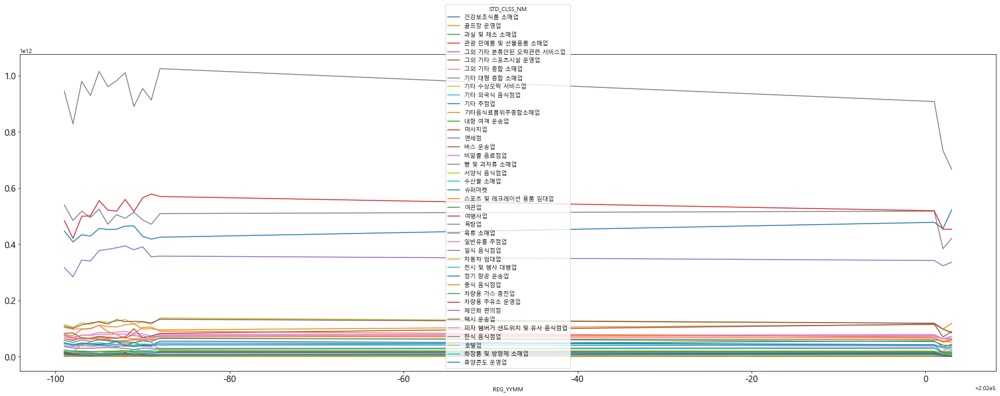

In [33]:
pd.options.display.float_format = '{:.5f}'.format
trainh.plot(kind="line",figsize=(30,10),fontsize=15)

In [34]:
std_class_ym1=train[['STD_CLSS_NM','AMT']].groupby(['STD_CLSS_NM']).sum() 

In [35]:
std_class_ym1.sort_values(by='AMT',ascending=False)
# 자료 갯수도 한식 음식점업,체인화 편의점,슈퍼마켓,차량용 주유소 운영업 순서로 많음

,AMT
STD_CLSS_NM,
한식 음식점업,13737489719551
차량용 주유소 운영업,7708652073883
기타 대형 종합 소매업,7328854819388
슈퍼마켓,6730329364274
체인화 편의점,5303958703193
서양식 음식점업,1748358904526
택시 운송업,1733409541974
기타음식료품위주종합소매업,1569246626978
스포츠 및 레크레이션 용품 임대업,1245725426753


## 2. 전처리 (null값 처리)

In [36]:
train.isnull().sum()

REG_YYMM             0
CARD_SIDO_NM         0
CARD_CCG_NM      87213
STD_CLSS_NM          0
HOM_SIDO_NM          0
HOM_CCG_NM      147787
AGE                  0
SEX_CTGO_CD          0
FLC                  0
CSTMR_CNT            0
AMT                  0
CNT                  0
dtype: int64

In [37]:
# for i in train['CARD_SIDO_NM'].unique():
#     print(i)
#     print(train.loc[train['CARD_SIDO_NM'] == i].isnull().sum())
#     print('')

In [38]:
#  CARD_CCG_NM 의 null값 모두 sido 세종. 따라서 세종시로 채우기

In [138]:
# train['CARD_CCG_NM'].fillna('세종시', inplace=True)

In [40]:
# train.isnull().sum()

REG_YYMM             0
CARD_SIDO_NM         0
CARD_CCG_NM          0
STD_CLSS_NM          0
HOM_SIDO_NM          0
HOM_CCG_NM      147787
AGE                  0
SEX_CTGO_CD          0
FLC                  0
CSTMR_CNT            0
AMT                  0
CNT                  0
dtype: int64

In [41]:
# for i in train['HOM_SIDO_NM'].unique():
#     print(i)
#     print(train.loc[train['HOM_SIDO_NM'] == i].isnull().sum())
#     print('')

In [139]:
# train['HOM_CCG_NM'].fillna('세종시', inplace=True)

## 3. 시각화(기본)

#### x=업종, y=이용 건수 (CNT 의 SUM)

In [43]:
cnt_clss=train[['STD_CLSS_NM','CNT']].groupby("STD_CLSS_NM").sum()
cnt_clss

,CNT
STD_CLSS_NM,
건강보조식품 소매업,1097627
골프장 운영업,4951383
과실 및 채소 소매업,24497628
관광 민예품 및 선물용품 소매업,593750
그외 기타 분류안된 오락관련 서비스업,1410
그외 기타 스포츠시설 운영업,140173
그외 기타 종합 소매업,21529262
기타 대형 종합 소매업,231338754
기타 수상오락 서비스업,50765


In [44]:
cnt_clss = cnt_clss.reset_index()
cnt_clss=cnt_clss.sort_values(by="CNT",ascending=False)
cnt_clss

,STD_CLSS_NM,CNT
34,체인화 편의점,786933354
37,한식 음식점업,459130888
20,슈퍼마켓,422258631
7,기타 대형 종합 소매업,231338754
35,택시 운송업,231011553
16,비알콜 음료점업,164698712
33,차량용 주유소 운영업,138163614
18,서양식 음식점업,116457610
36,피자 햄버거 샌드위치 및 유사 음식점업,111352234
17,빵 및 과자류 소매업,88422041


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40]),
 <a list of 41 Text xticklabel objects>)

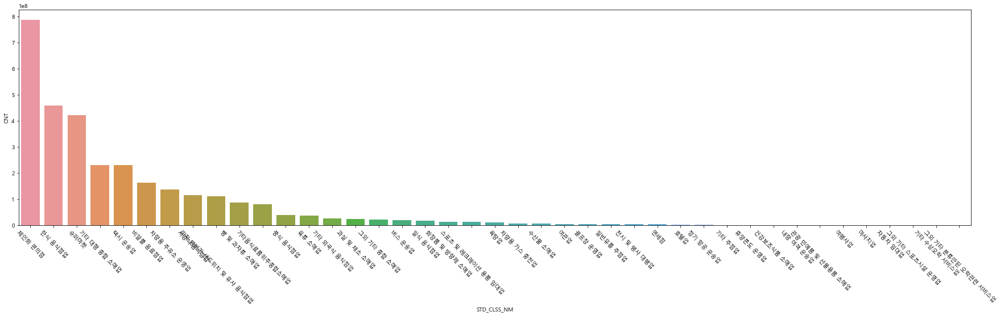

In [45]:
plt.figure(figsize=(30,7))
# amt_clss.plot(kind="bar",figsize=(30,10),fontsize=15)
sns.barplot(data=cnt_clss , x='STD_CLSS_NM', y='CNT')
plt.rc('font', size=15)
plt.xticks(rotation = -45 )

#### x=시도, y=이용 건수

In [46]:
cnt_sido=train[['CARD_SIDO_NM','CNT']].groupby("CARD_SIDO_NM").sum()
cnt_sido


,CNT
CARD_SIDO_NM,
강원,64382529
경기,701143788
경남,149370331
경북,113078004
광주,82758813
대구,164232841
대전,60900956
부산,228178463
서울,994077624


In [47]:

cnt_sido= cnt_sido.reset_index()
cnt_sido=cnt_sido.sort_values(by="CNT",ascending=False)
cnt_sido

,CARD_SIDO_NM,CNT
8,서울,994077624
1,경기,701143788
7,부산,228178463
5,대구,164232841
2,경남,149370331
11,인천,147173793
3,경북,113078004
15,충남,91093453
4,광주,82758813
13,전북,80723851


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16]),
 <a list of 17 Text xticklabel objects>)

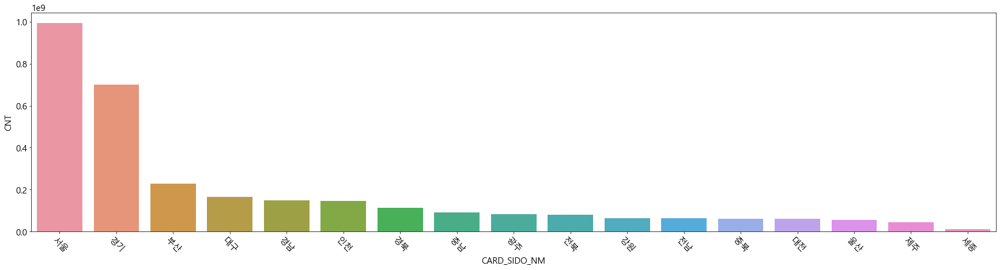

In [48]:
plt.figure(figsize=(30,7))
# amt_clss.plot(kind="bar",figsize=(30,10),fontsize=15)
sns.barplot(data=cnt_sido , x='CARD_SIDO_NM', y='CNT')
plt.rc('font', size=15)
plt.xticks(rotation = -45 )

#### 업종별 x=시도, y=CNT 이용건수

In [4]:
# 업종별로 시도 
std_class_sido=train[['CARD_SIDO_NM','STD_CLSS_NM','CNT']].groupby(['STD_CLSS_NM','CARD_SIDO_NM']).sum()

In [5]:
std_class_sido

CNT
STD_CLSS_NM CARD_SIDO_NM        
건강보조식품 소매업  강원             16170
            경기            227521
            경남             52310
            경북             28506
            광주             28428
...                          ...
휴양콘도 운영업    전남             73010
            전북             92415
            제주            107836
            충남             67556
            충북             40731

[650 rows x 1 columns]

In [6]:
std_class_sido.loc["면세점"]

,CNT
CARD_SIDO_NM,
강원,88
대구,42376
부산,319279
서울,289795
울산,47
인천,1977457
전남,10204
제주,1554261
충북,786


In [51]:
# std_class_sido = std_class_sido.reset_index()
# std_class_sido

In [52]:
# std_class_sido.set_index("STD_CLSS_NM",inplace=True)
# std_class_sido

In [36]:
CLSS_NM_uniq=train['STD_CLSS_NM'].unique()

In [54]:
CLSS_NM_uniq[0]

'건강보조식품 소매업'

## 업종별 시도 cnt 시각화

C:\Users\noeul\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


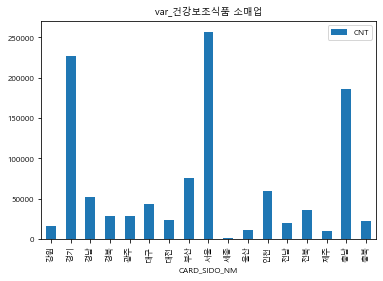

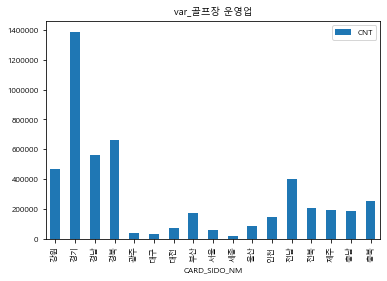

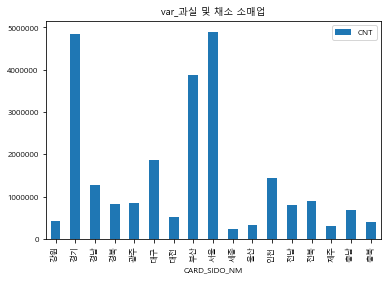

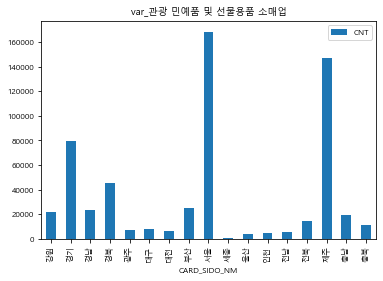

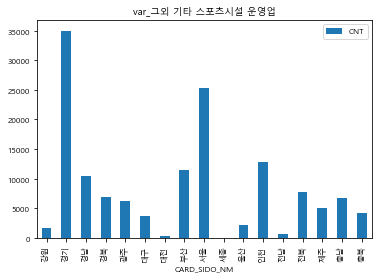

...

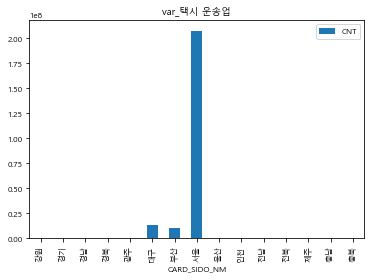

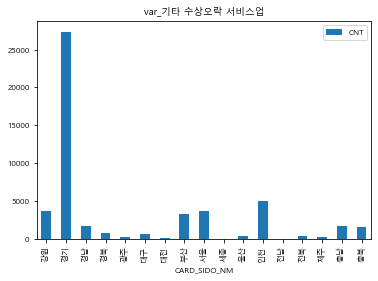

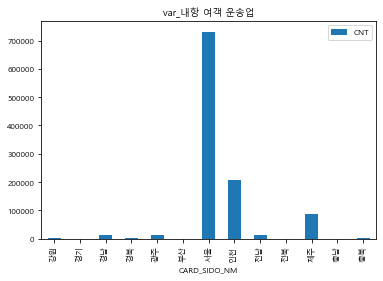

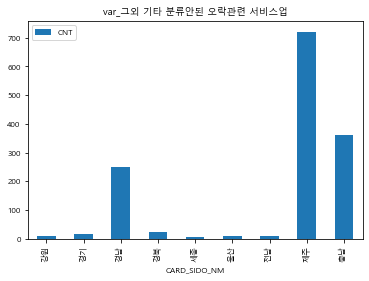

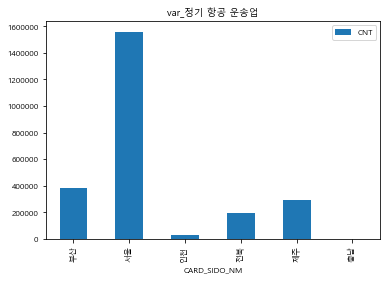

In [55]:
a=[]
b=[]
for i in CLSS_NM_uniq :
#     print('var_{}'.format(i))
    a.append('var_{}'.format(i))
    b.append('var_{}'.format(i))

for i in range(len(CLSS_NM_uniq)) :
    c=b[i]    
    a[i]=std_class_sido.loc[CLSS_NM_uniq[i]]
    
    plt.rc('font', size=8)
    a[i].plot(kind='bar')
    
    plt.title(c)

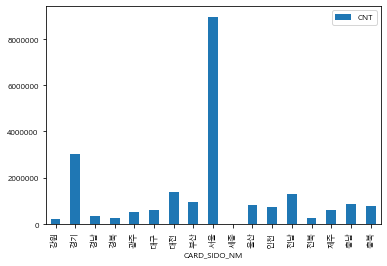

In [56]:
#확인
ch=std_class_sido.loc["그외 기타 종합 소매업"]
plt.rc('font', size=8)
ch.plot(kind='bar')

In [57]:
train.loc[train["CSTMR_CNT"]] == 4

,REG_YYMM,CARD_SIDO_NM,CARD_CCG_NM,STD_CLSS_NM,HOM_SIDO_NM,HOM_CCG_NM,AGE,SEX_CTGO_CD,FLC,CSTMR_CNT,AMT,CNT
4,False,False,False,False,False,False,False,False,True,False,False,False
7,False,False,False,False,False,False,False,False,True,False,False,False
6,False,False,False,False,False,False,False,False,True,False,False,False
4,False,False,False,False,False,False,False,False,True,False,False,False
3,False,False,False,False,False,False,False,False,False,True,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...
3,False,False,False,False,False,False,False,False,False,True,False,False
3,False,False,False,False,False,False,False,False,False,True,False,False
4,False,False,False,False,False,False,False,False,True,False,False,False
4,False,False,False,False,False,False,False,False,True,False,False,False


In [58]:
train.head()

,REG_YYMM,CARD_SIDO_NM,CARD_CCG_NM,STD_CLSS_NM,HOM_SIDO_NM,HOM_CCG_NM,AGE,SEX_CTGO_CD,FLC,CSTMR_CNT,AMT,CNT
0,201901,강원,강릉시,건강보조식품 소매업,강원,강릉시,20s,1,1,4,311200,4
1,201901,강원,강릉시,건강보조식품 소매업,강원,강릉시,30s,1,2,7,1374500,8
2,201901,강원,강릉시,건강보조식품 소매업,강원,강릉시,30s,2,2,6,818700,6
3,201901,강원,강릉시,건강보조식품 소매업,강원,강릉시,40s,1,3,4,1717000,5
4,201901,강원,강릉시,건강보조식품 소매업,강원,강릉시,40s,1,4,3,1047300,3


In [59]:
train.loc[(train["CSTMR_CNT"].max())&(train["STD_CLSS_NM"]=="건강보조식품 소매업")&(train["CARD_SIDO_NM"]=="강원"),["REG_YYMM","CARD_SIDO_NM","STD_CLSS_NM","SEX_CTGO_CD","AGE","CSTMR_CNT","FLC"]]

,REG_YYMM,CARD_SIDO_NM,STD_CLSS_NM,SEX_CTGO_CD,AGE,CSTMR_CNT,FLC
0,201901,강원,건강보조식품 소매업,1,20s,4,1
1,201901,강원,건강보조식품 소매업,1,30s,7,2
2,201901,강원,건강보조식품 소매업,2,30s,6,2
3,201901,강원,건강보조식품 소매업,1,40s,4,3
4,201901,강원,건강보조식품 소매업,1,40s,3,4
...,...,...,...,...,...,...,...
23482159,202003,강원,건강보조식품 소매업,2,60s,4,5
23482160,202003,강원,건강보조식품 소매업,2,70s,3,5
23487240,202003,강원,건강보조식품 소매업,1,50s,13,4
23487241,202003,강원,건강보조식품 소매업,2,50s,3,4


In [60]:
train[["REG_YYMM","CARD_SIDO_NM","STD_CLSS_NM","CSTMR_CNT","SEX_CTGO_CD","FLC","AGE"]]

,REG_YYMM,CARD_SIDO_NM,STD_CLSS_NM,CSTMR_CNT,SEX_CTGO_CD,FLC,AGE
0,201901,강원,건강보조식품 소매업,4,1,1,20s
1,201901,강원,건강보조식품 소매업,7,1,2,30s
2,201901,강원,건강보조식품 소매업,6,2,2,30s
3,201901,강원,건강보조식품 소매업,4,1,3,40s
4,201901,강원,건강보조식품 소매업,3,1,4,40s
...,...,...,...,...,...,...,...
24697787,202003,충북,휴양콘도 운영업,3,1,2,30s
24697788,202003,충북,휴양콘도 운영업,3,1,3,40s
24697789,202003,충북,휴양콘도 운영업,4,1,4,50s
24697790,202003,충북,휴양콘도 운영업,4,2,4,50s


In [61]:
train[train["CSTMR_CNT"] == 4][["CARD_SIDO_NM","STD_CLSS_NM","CSTMR_CNT"]]

,CARD_SIDO_NM,STD_CLSS_NM,CSTMR_CNT
0,강원,건강보조식품 소매업,4
3,강원,건강보조식품 소매업,4
26,강원,골프장 운영업,4
30,강원,골프장 운영업,4
51,강원,과실 및 채소 소매업,4
...,...,...,...
24697755,충북,호텔업,4
24697763,충북,호텔업,4
24697764,충북,호텔업,4
24697789,충북,휴양콘도 운영업,4


In [62]:
# 시도별로 이용고객수
train[['STD_CLSS_NM','CARD_SIDO_NM','CSTMR_CNT']].groupby(['CARD_SIDO_NM','STD_CLSS_NM']).sum()

CSTMR_CNT
CARD_SIDO_NM STD_CLSS_NM                     
강원           건강보조식품 소매업                 15343
             골프장 운영업                   326003
             과실 및 채소 소매업               318132
             관광 민예품 및 선물용품 소매업          18764
             그외 기타 분류안된 오락관련 서비스업           6
...                                       ...
충북           피자 햄버거 샌드위치 및 유사 음식점업    1409428
             한식 음식점업                  7966615
             호텔업                         7970
             화장품 및 방향제 소매업             191560
             휴양콘도 운영업                   24493

[650 rows x 1 columns]

In [63]:
# 시도별로 업종
std_sido_class=train[['STD_CLSS_NM','CARD_SIDO_NM','CNT']].groupby(['CARD_SIDO_NM','STD_CLSS_NM']).sum()

In [64]:
clss_sido_amt_sum = train.groupby(['STD_CLSS_NM','CARD_SIDO_NM'])['AMT'].sum()
clss_sido_amt_sum = pd.DataFrame(clss_sido_amt_sum)
clss_sido_amt_sum

AMT
STD_CLSS_NM CARD_SIDO_NM             
건강보조식품 소매업  강원             1820824382
            경기            21313151258
            경남             5406038964
            경북             3564454980
            광주             3619007849
...                               ...
휴양콘도 운영업    전남             4192316889
            전북             6346178051
            제주             7475474469
            충남             3967138248
            충북             2414736980

[650 rows x 1 columns]

In [65]:
std_sido_class

CNT
CARD_SIDO_NM STD_CLSS_NM                    
강원           건강보조식품 소매업                16170
             골프장 운영업                  465266
             과실 및 채소 소매업              428427
             관광 민예품 및 선물용품 소매업         22012
             그외 기타 분류안된 오락관련 서비스업         10
...                                      ...
충북           피자 햄버거 샌드위치 및 유사 음식점업   2004621
             한식 음식점업                11522939
             호텔업                       11641
             화장품 및 방향제 소매업            224483
             휴양콘도 운영업                  40731

[650 rows x 1 columns]

In [66]:
std_sido_class.loc["강원"]

,CNT
STD_CLSS_NM,
건강보조식품 소매업,16170
골프장 운영업,465266
과실 및 채소 소매업,428427
관광 민예품 및 선물용품 소매업,22012
그외 기타 분류안된 오락관련 서비스업,10
그외 기타 스포츠시설 운영업,1639
그외 기타 종합 소매업,206236
기타 대형 종합 소매업,3023973
기타 수상오락 서비스업,3698


In [4]:
SIDO_NM_uniq=train['CARD_SIDO_NM'].unique()
SIDO_NM_uniq

array(['강원', '경기', '경남', '경북', '광주', '대구', '대전', '부산', '서울', '세종', '울산',
       '인천', '전남', '전북', '제주', '충남', '충북'], dtype=object)

In [68]:
range(len(SIDO_NM_uniq))

range(0, 17)

In [69]:
SIDO_NM_uniq[0]

'강원'

In [70]:
a=[]
b=[]
for i in SIDO_NM_uniq :
#     print('var_{}'.format(i))
    a.append('var_{}'.format(i))
    b.append('var_{}'.format(i))
    

In [71]:

c=b[2] 
c

'var_경남'

## 시도별 업종 cnt 시각화 

C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  del sys.path[0]
C:\Users\noeul\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


<Figure size 3600x504 with 0 Axes>

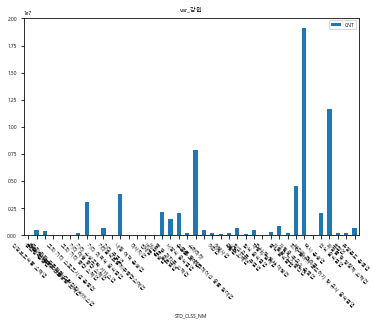

<Figure size 3600x504 with 0 Axes>

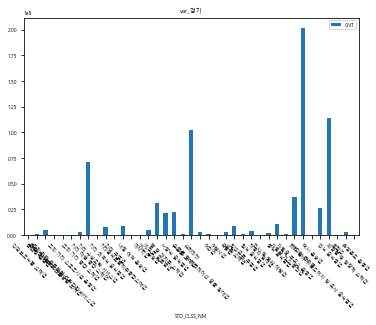

<Figure size 3600x504 with 0 Axes>

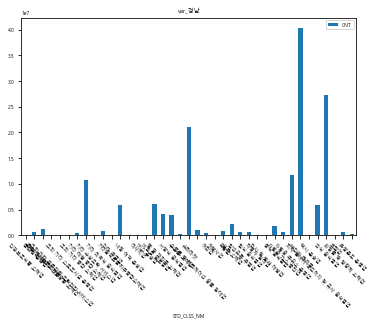

<Figure size 3600x504 with 0 Axes>

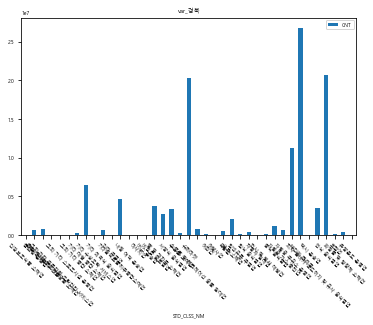

<Figure size 3600x504 with 0 Axes>

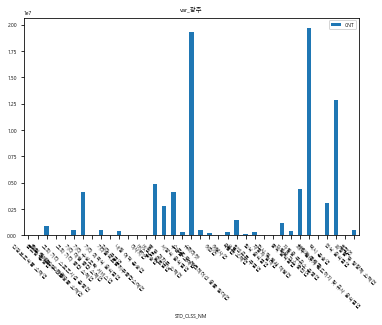

<Figure size 3600x504 with 0 Axes>

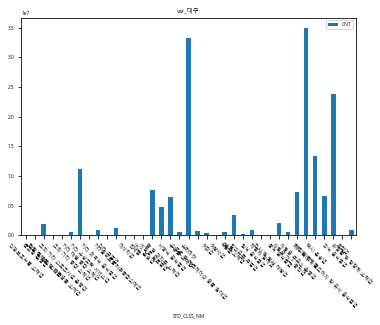

<Figure size 3600x504 with 0 Axes>

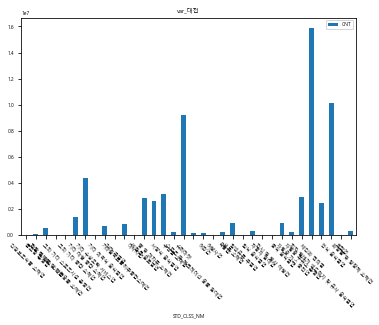

<Figure size 3600x504 with 0 Axes>

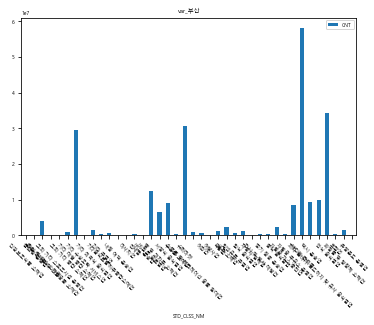

<Figure size 3600x504 with 0 Axes>

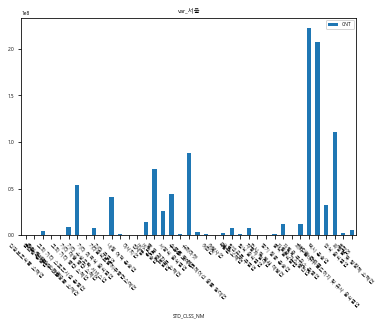

<Figure size 3600x504 with 0 Axes>

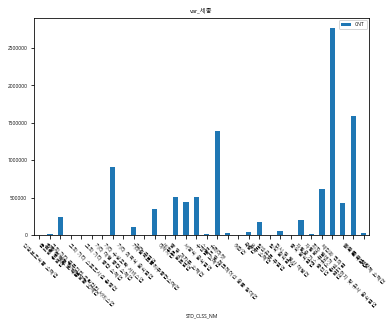

<Figure size 3600x504 with 0 Axes>

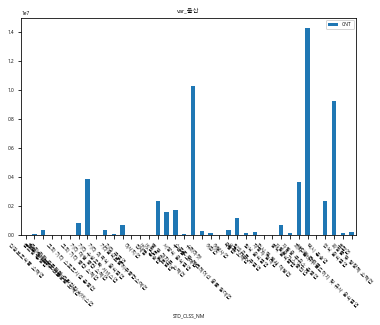

<Figure size 3600x504 with 0 Axes>

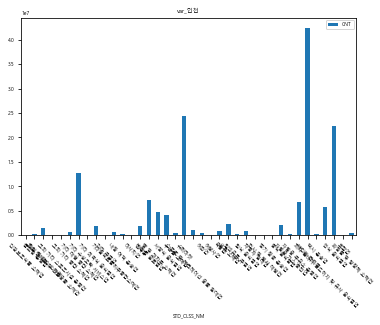

<Figure size 3600x504 with 0 Axes>

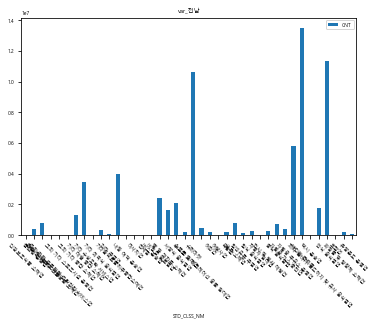

<Figure size 3600x504 with 0 Axes>

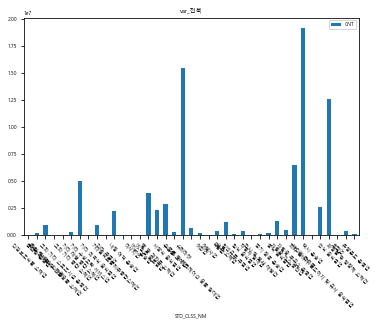

<Figure size 3600x504 with 0 Axes>

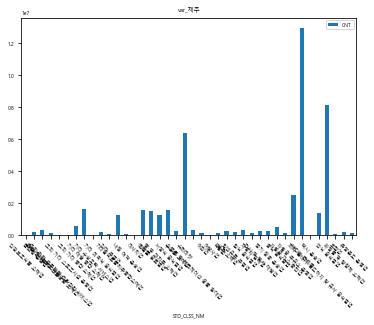

<Figure size 3600x504 with 0 Axes>

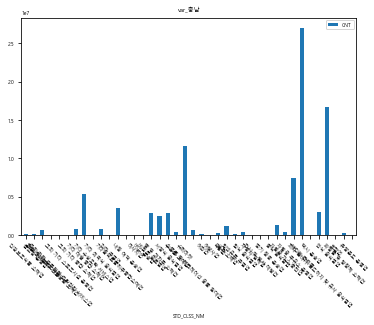

<Figure size 3600x504 with 0 Axes>

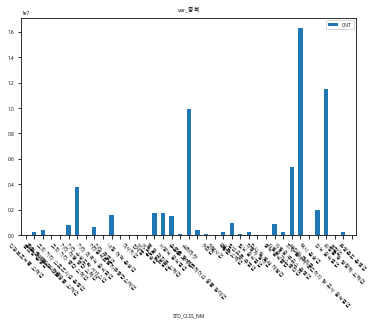

In [72]:
a=[]
b=[]
for i in SIDO_NM_uniq :
#     print('var_{}'.format(i))
    a.append('var_{}'.format(i))
    b.append('var_{}'.format(i))
    

for i in range(len(SIDO_NM_uniq)) :
    c=b[i]    
    a[i]=std_sido_class.loc[SIDO_NM_uniq[i]]
    
    plt.figure(figsize=(50,7))
    plt.rc('font', size=5)
    a[i].plot(kind='bar')
    
    plt.title(c)
    plt.xticks(rotation = - 45 )

## 시도, 업종별 AMT 합계 평균 시각화

In [73]:
sido_amt_sum = train.groupby(['CARD_SIDO_NM'])['AMT'].sum()
sido_amt_mean = train.groupby(['CARD_SIDO_NM'])['AMT'].mean()
clss_amt_sum = train.groupby(['STD_CLSS_NM'])['AMT'].sum()
clss_amt_mean = train.groupby(['STD_CLSS_NM'])['AMT'].mean()

In [74]:
sido_amt_sum

CARD_SIDO_NM
강원     1589611299919
경기    14201885234869
경남     3485130029864
경북     2767620595248
광주     1705650360934
대구     3020064352604
대전     1128913460716
부산     4491306031541
서울    14677131049031
세종      204045817348
울산     1255213605740
인천     3056247462913
전남     1839760777139
전북     1961230185341
제주     1343582224768
충남     2103197375108
충북     1465437185923
Name: AMT, dtype: int64

In [75]:
clss_amt_sum

STD_CLSS_NM
건강보조식품 소매업                 105126364380
골프장 운영업                    595701968828
과실 및 채소 소매업                618928801283
관광 민예품 및 선물용품 소매업           15129406137
그외 기타 분류안된 오락관련 서비스업           37246490
그외 기타 스포츠시설 운영업              2731915234
그외 기타 종합 소매업              1025691118171
기타 대형 종합 소매업              7328854819388
기타 수상오락 서비스업                 1671308986
기타 외국식 음식점업                623167678948
기타 주점업                     164753620805
기타음식료품위주종합소매업             1569246626978
내항 여객 운송업                   42015061681
마사지업                        20199890964
면세점                        404512192532
버스 운송업                     230236675997
비알콜 음료점업                  1143497863742
빵 및 과자류 소매업                893591674917
서양식 음식점업                  1748358904526
수산물 소매업                    297031773253
슈퍼마켓                      6730329364274
스포츠 및 레크레이션 용품 임대업        1245725426753
여관업                        258904036530
여행사업                       109016697282
욕탕업                        1

## 시도별 AMT 합계 평균 시각화

In [76]:
sido_amt_sum = pd.DataFrame(sido_amt_sum)
sido_amt_mean = pd.DataFrame(sido_amt_mean)
clss_amt_sum = pd.DataFrame(clss_amt_sum)
clss_amt_mean = pd.DataFrame(clss_amt_mean)

In [77]:
sido_amt_sum.sort_values(by = 'AMT',ascending=False, inplace=True)
sido_amt_mean.sort_values(by = 'AMT',ascending=False, inplace=True)
clss_amt_sum.sort_values(by = 'AMT',ascending=False, inplace=True)
clss_amt_mean.sort_values(by = 'AMT',ascending=False, inplace=True)

Text(0.5, 1.0, '시도별 전체 거래가의 합')

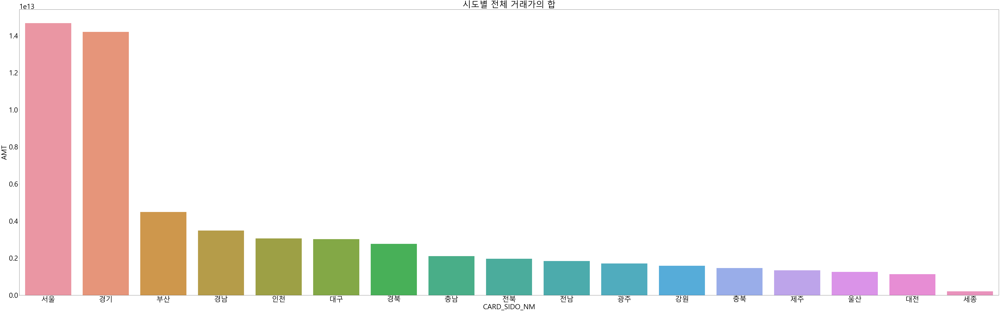

In [78]:
"""sido_amt_sum.plot.bar()
sido_amt_mean.plot.bar()
clss_amt_sum.plot.bar()
clss_amt_mean.plot.bar()
"""
plt.figure(figsize = (100,30))
plt.rcParams.update({'font.size': 40})
b = sns.barplot(data= sido_amt_sum,x= sido_amt_sum.index, y= 'AMT')
plt.title("시도별 전체 거래가의 합")

Text(0.5, 1.0, '시도별 전체 거래가의 평균')

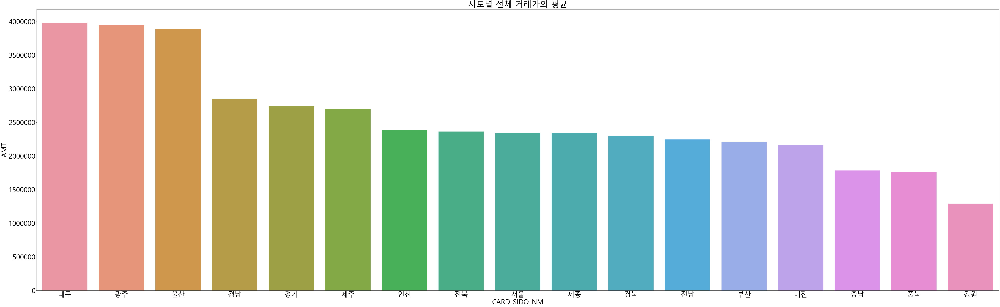

In [79]:
plt.figure(figsize = (100,30))
plt.rcParams.update({'font.size': 40})
b = sns.barplot(data= sido_amt_mean,x= sido_amt_mean.index, y= 'AMT')
plt.title("시도별 전체 거래가의 평균")

Text(0.5, 1.0, '업종별 전체 거래가의 합')

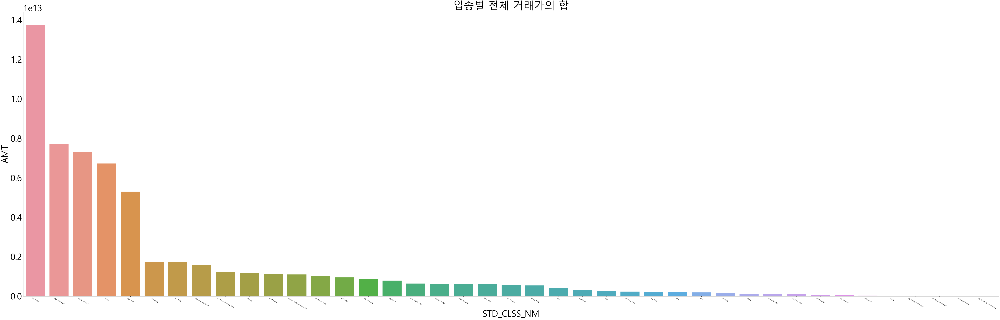

In [80]:
plt.figure(figsize = (100,30))
plt.rcParams.update({'font.size': 50})
b = sns.barplot(data= clss_amt_sum,x= clss_amt_sum.index, y= 'AMT')
b.set_xticklabels(b.get_xticklabels(), fontsize=7)
plt.xticks(rotation = -30 )
plt.title("업종별 전체 거래가의 합")

Text(0.5, 1.0, '업종별 전체 거래가의 평균')

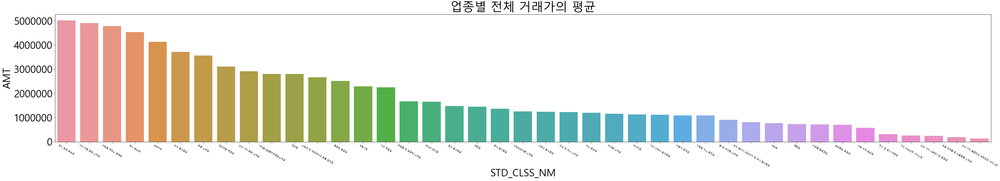

In [81]:
plt.figure(figsize = (50,7))
plt.rcParams.update({'font.size': 30})
b = sns.barplot(data= clss_amt_mean,x= clss_amt_mean.index, y= 'AMT')
b.set_xticklabels(b.get_xticklabels(), fontsize=7)
plt.xticks(rotation = -30 )

plt.title("업종별 전체 거래가의 평균")

## 업종별을 시도로 나눠서 AMT 합계 평균

In [82]:
# 업종추출
clss = train['STD_CLSS_NM']

clss = list(clss)
clss = set(clss)
clss = list(clss)
clss

['여관업',
 '그외 기타 종합 소매업',
 '육류 소매업',
 '면세점',
 '중식 음식점업',
 '그외 기타 스포츠시설 운영업',
 '내항 여객 운송업',
 '기타 주점업',
 '관광 민예품 및 선물용품 소매업',
 '체인화 편의점',
 '골프장 운영업',
 '건강보조식품 소매업',
 '과실 및 채소 소매업',
 '서양식 음식점업',
 '한식 음식점업',
 '기타 수상오락 서비스업',
 '슈퍼마켓',
 '버스 운송업',
 '여행사업',
 '택시 운송업',
 '정기 항공 운송업',
 '호텔업',
 '자동차 임대업',
 '기타음식료품위주종합소매업',
 '빵 및 과자류 소매업',
 '화장품 및 방향제 소매업',
 '휴양콘도 운영업',
 '피자 햄버거 샌드위치 및 유사 음식점업',
 '욕탕업',
 '차량용 가스 충전업',
 '일식 음식점업',
 '일반유흥 주점업',
 '기타 대형 종합 소매업',
 '전시 및 행사 대행업',
 '마사지업',
 '비알콜 음료점업',
 '차량용 주유소 운영업',
 '그외 기타 분류안된 오락관련 서비스업',
 '수산물 소매업',
 '기타 외국식 음식점업',
 '스포츠 및 레크레이션 용품 임대업']

In [83]:
clss_sido_amt_sum = train.groupby(['STD_CLSS_NM','CARD_SIDO_NM'])['AMT'].sum()
clss_sido_amt_sum = pd.DataFrame(clss_sido_amt_sum)

In [84]:
#clss_sido_amt_mean.loc[clss[0]]
#np.argsort(clss_sido_amt_mean.loc[clss[0]]['AMT'])

In [85]:
clss_sido_amt_sum.loc[clss[1]].sort_values(by = 'AMT', ascending = False)

,AMT
CARD_SIDO_NM,
서울,575867310193
경기,136696693790
전남,43262442057
제주,35584260566
울산,33187415700
충남,28416258930
부산,27903263440
충북,27661251727
대구,25510547460


C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may cons

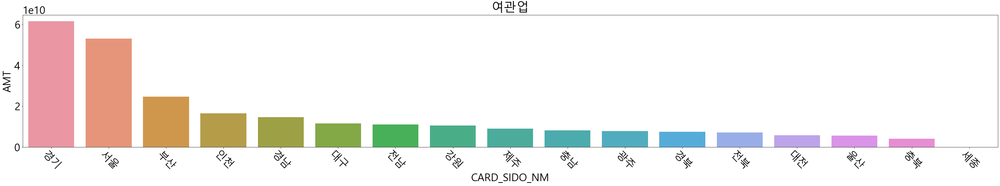

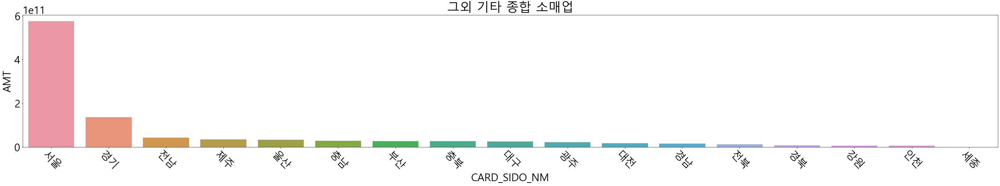

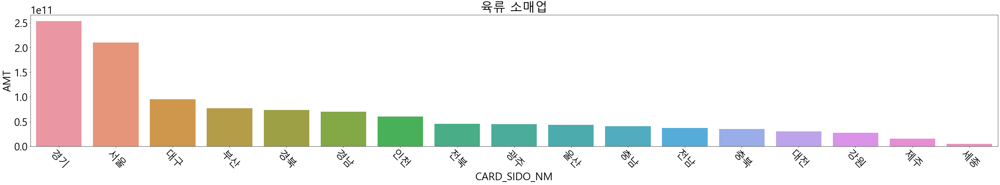

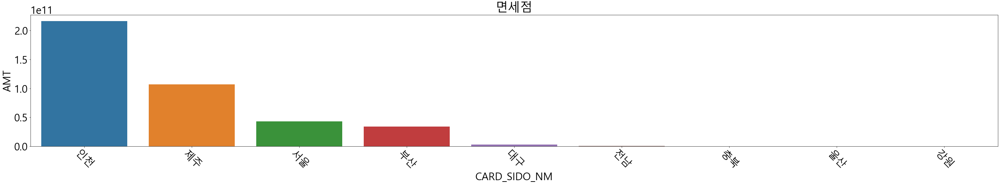

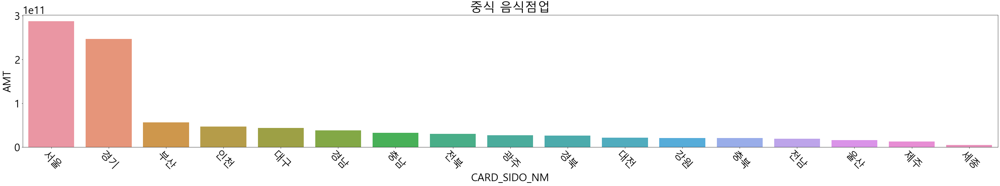

...

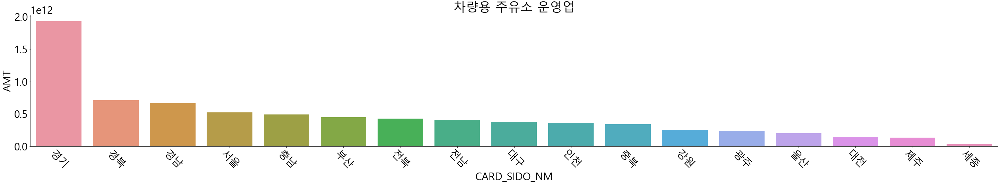

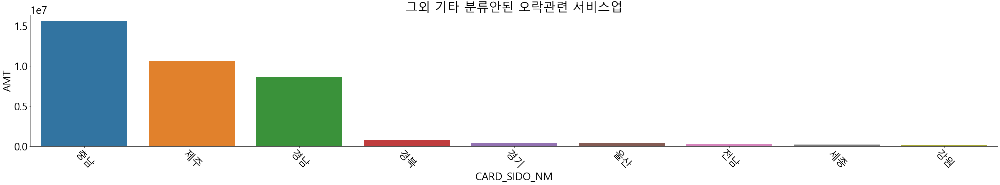

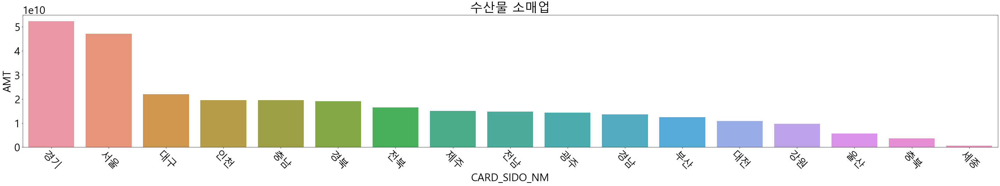

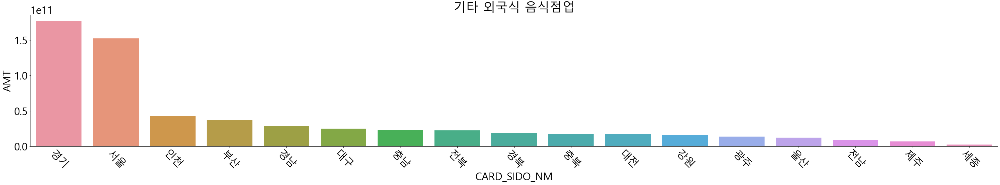

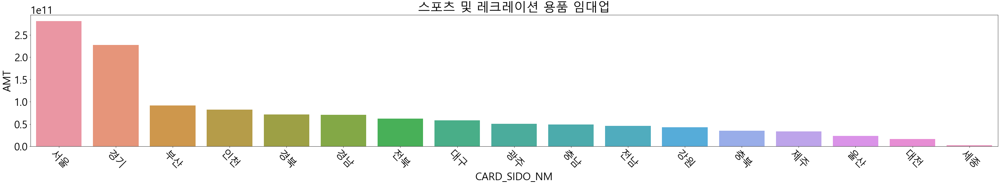

In [86]:
a = 0
for i in clss:
    data = clss_sido_amt_sum.loc[clss[a]].sort_values(by = 'AMT', ascending = False)
    plt.figure(figsize = (50,7))
    plt.rcParams.update({'font.size': 30})
    plt.xticks(rotation = - 45 )
    b = sns.barplot(data= data, x= data.index, y= 'AMT')
    plt.title(i)
    a+=1

In [87]:
clss_sido_amt_mean = train.groupby(['STD_CLSS_NM','CARD_SIDO_NM'])['AMT'].mean()
clss_sido_amt_mean = pd.DataFrame(clss_sido_amt_mean)

C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may cons

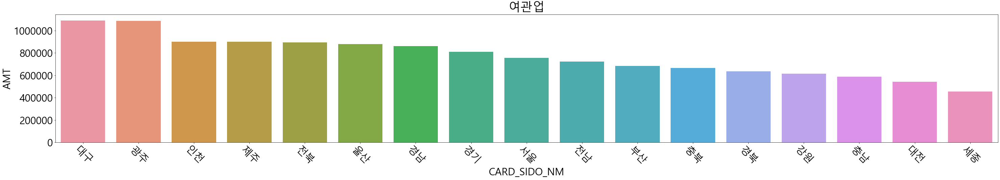

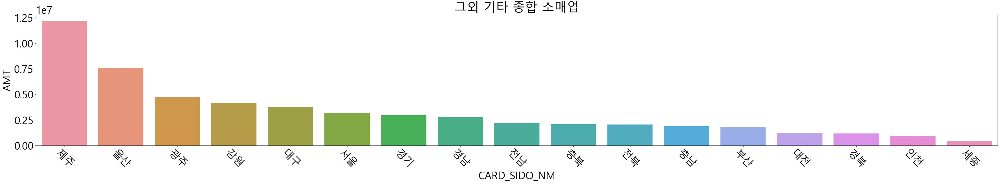

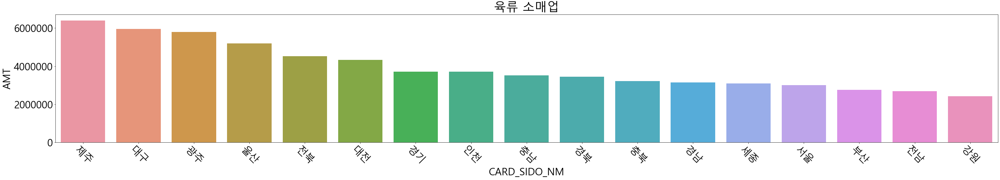

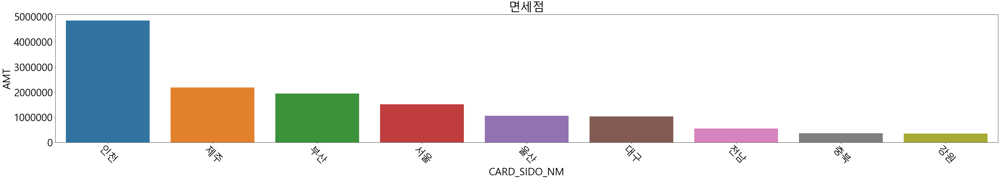

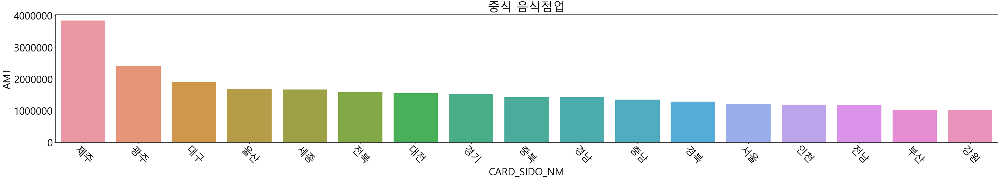

...

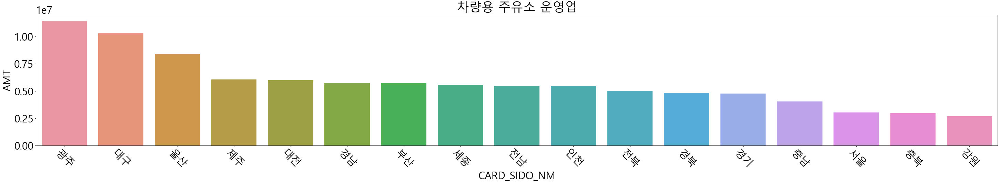

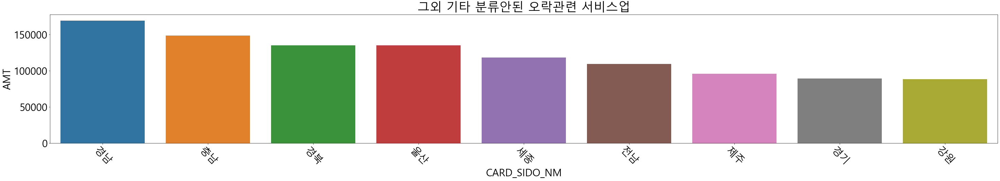

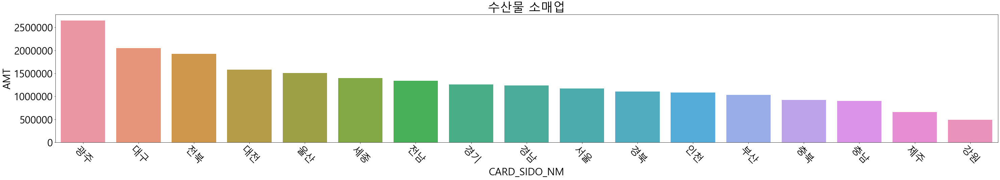

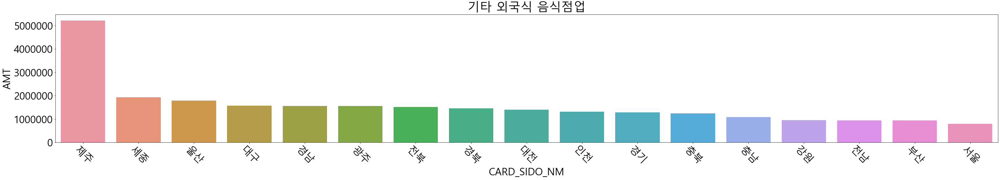

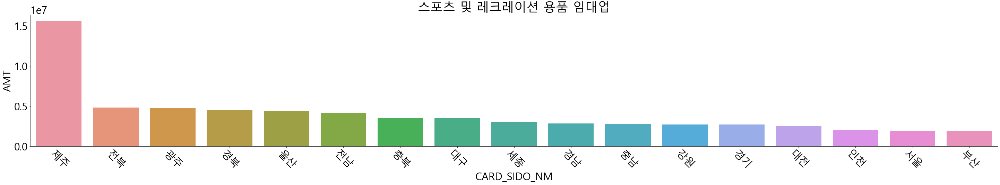

In [88]:
a = 0
for i in clss:
    data = clss_sido_amt_mean.loc[clss[a]].sort_values(by = 'AMT', ascending = False)
    plt.figure(figsize = (50,7))
    plt.rcParams.update({'font.size': 30})
    plt.xticks(rotation = - 45 )
    b = sns.barplot(data= data, x= data.index, y= 'AMT')
    plt.title(i)
    a+=1

In [89]:
# 시도추출
sido = train['CARD_SIDO_NM']

sido = list(sido)
sido = set(sido)
sido = list(sido)
sido

['충북',
 '강원',
 '서울',
 '경기',
 '울산',
 '제주',
 '인천',
 '전남',
 '경북',
 '경남',
 '대구',
 '부산',
 '광주',
 '충남',
 '세종',
 '전북',
 '대전']

In [90]:
sido_clss_amt_mean = train.groupby(['CARD_SIDO_NM','STD_CLSS_NM'])['AMT'].mean()
sido_clss_amt_mean = pd.DataFrame(sido_clss_amt_mean)

In [91]:
sido_clss_amt_mean.loc[sido[1]].sort_values(by = 'AMT', ascending = False)

,AMT
STD_CLSS_NM,
일반유흥 주점업,5006574.80891
그외 기타 종합 소매업,4168893.31532
스포츠 및 레크레이션 용품 임대업,2741550.90605
기타음식료품위주종합소매업,2699431.89091
차량용 주유소 운영업,2688746.72127
기타 주점업,2471958.83012
육류 소매업,2424611.04964
기타 대형 종합 소매업,2270330.43856
한식 음식점업,1821660.98078


## 시도별을 업종으로 나눠서 AMT 합계 평균

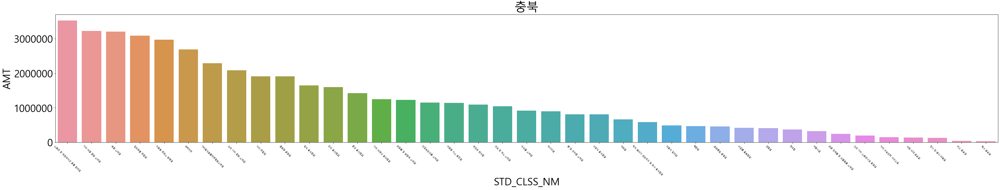

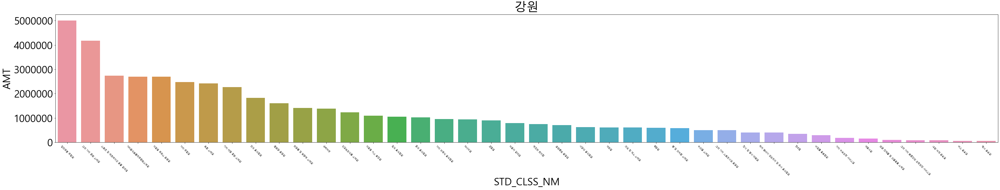

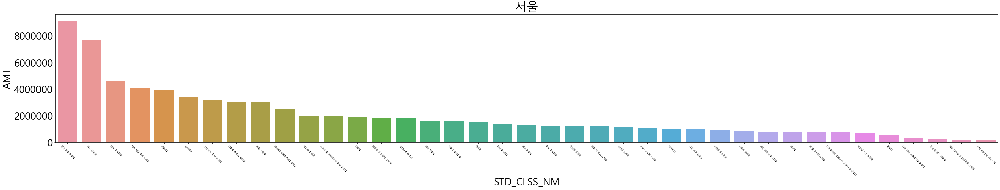

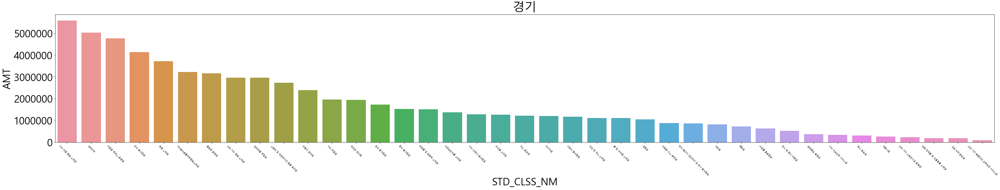

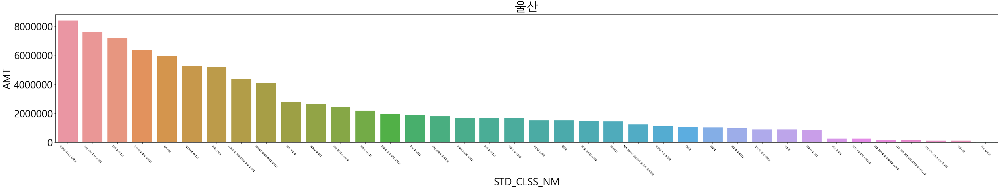

...

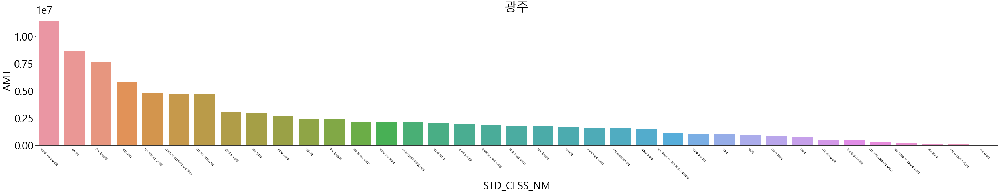

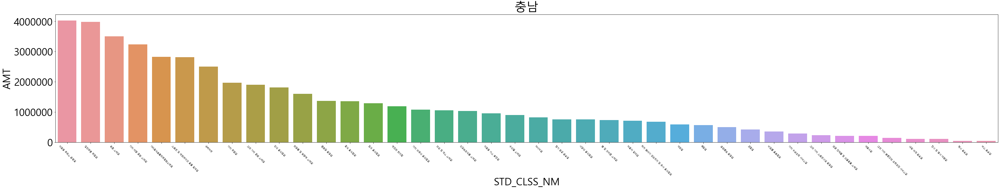

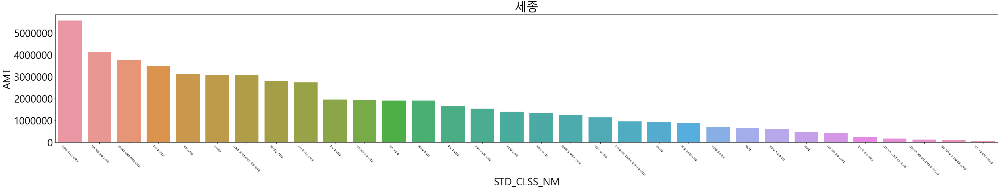

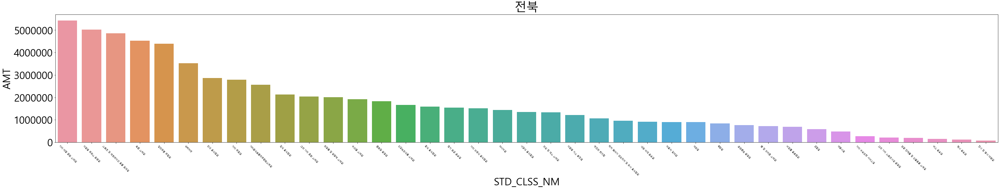

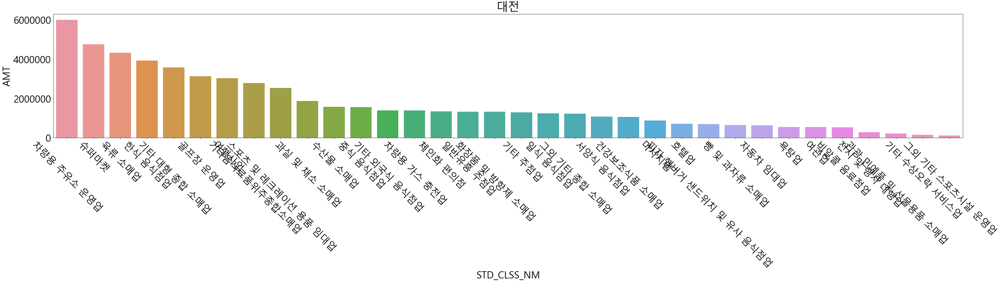

In [92]:
#평균
a = 0
for i in sido:
    data = sido_clss_amt_mean.loc[sido[a]].sort_values(by = 'AMT', ascending = False)
    plt.figure(figsize = (50,7))
    b.set_xticklabels(b.get_xticklabels(), fontsize=7)
    plt.xticks(rotation = - 45 )
    b = sns.barplot(data= data, x= data.index, y= 'AMT')
    plt.title(i)
    a+=1

In [93]:
sido_clss_amt_sum = train.groupby(['CARD_SIDO_NM','STD_CLSS_NM'])['AMT'].sum()
sido_clss_amt_sum = pd.DataFrame(sido_clss_amt_sum)

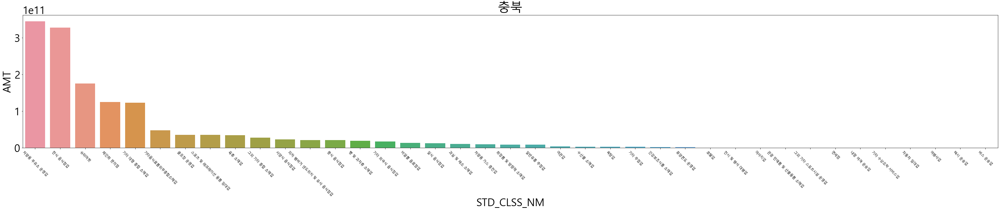

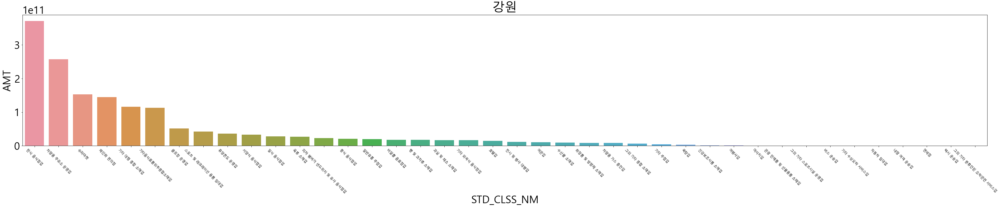

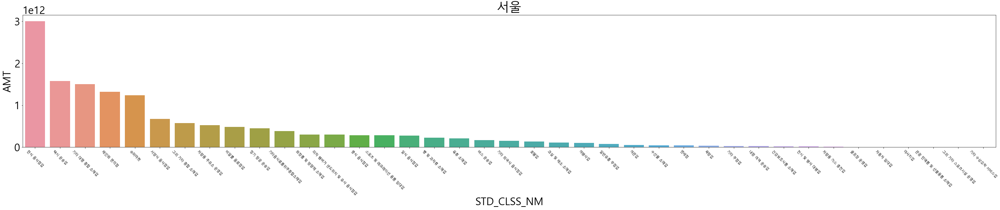

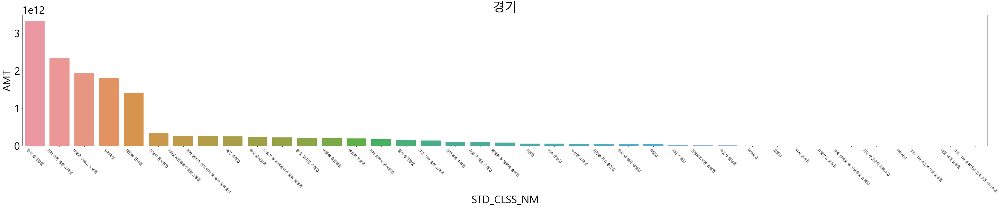

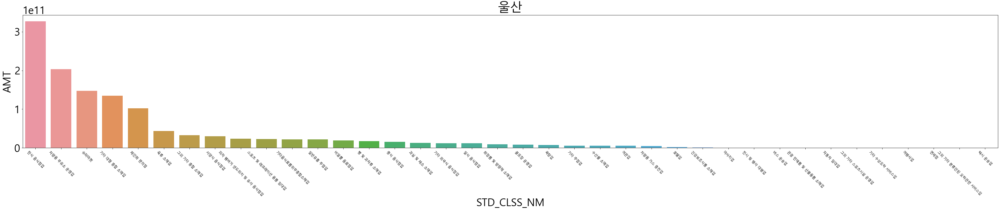

...

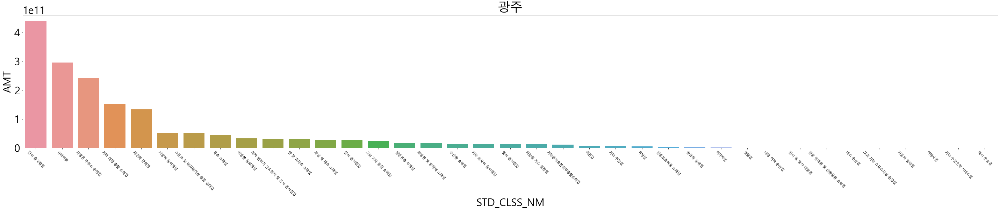

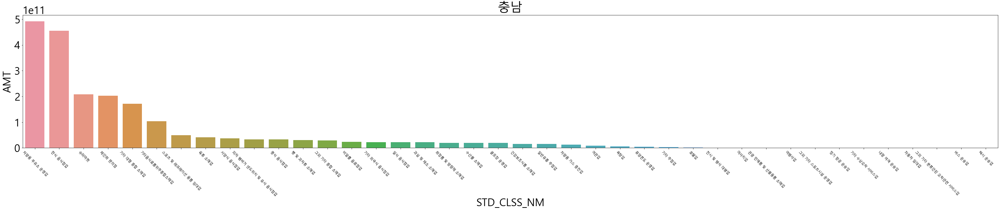

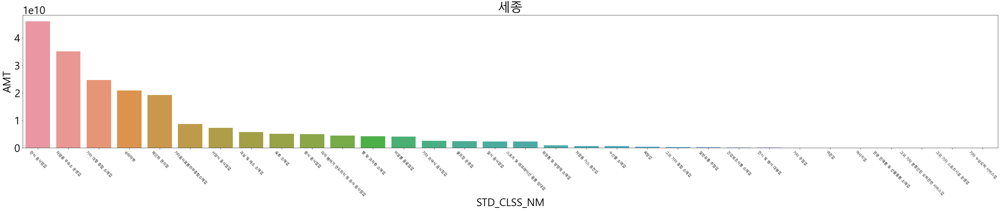

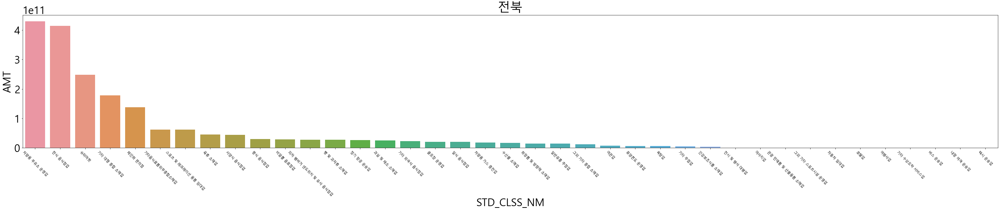

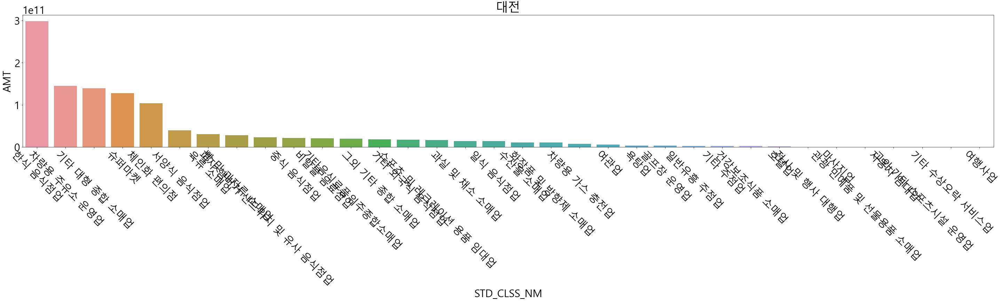

In [94]:
#합계
a = 0
for i in sido:
    data = sido_clss_amt_sum.loc[sido[a]].sort_values(by = 'AMT', ascending = False)
    plt.figure(figsize = (50,7))
    b.set_xticklabels(b.get_xticklabels(), fontsize=10)
    plt.xticks(rotation = - 45 )
    b = sns.barplot(data= data, x= data.index, y= 'AMT')
    plt.title(i)
    a+=1

## AMT MEAN 다시

In [95]:
amt_sido=train[['CARD_SIDO_NM','AMT']].groupby("CARD_SIDO_NM").sum()


amt_sido= amt_sido.reset_index()
amt_sido=amt_sido.sort_values(by="AMT",ascending=False)
amt_sido

,CARD_SIDO_NM,AMT
8,서울,14677131049031
1,경기,14201885234869
7,부산,4491306031541
2,경남,3485130029864
11,인천,3056247462913
5,대구,3020064352604
3,경북,2767620595248
15,충남,2103197375108
13,전북,1961230185341
12,전남,1839760777139


In [96]:
cnt_sido

,CARD_SIDO_NM,CNT
8,서울,994077624
1,경기,701143788
7,부산,228178463
5,대구,164232841
2,경남,149370331
11,인천,147173793
3,경북,113078004
15,충남,91093453
4,광주,82758813
13,전북,80723851


In [97]:
amt_cnt_sido = pd.merge(amt_sido, cnt_sido)
amt_cnt_sido 

,CARD_SIDO_NM,AMT,CNT
0,서울,14677131049031,994077624
1,경기,14201885234869,701143788
2,부산,4491306031541,228178463
3,경남,3485130029864,149370331
4,인천,3056247462913,147173793
5,대구,3020064352604,164232841
6,경북,2767620595248,113078004
7,충남,2103197375108,91093453
8,전북,1961230185341,80723851
9,전남,1839760777139,63787592


In [98]:
# train[['CARD_SIDO_NM','CNT']]

In [99]:
amt_cnt_sido["sido_mean"]= amt_cnt_sido["AMT"]/amt_cnt_sido["CNT"]
amt_cnt_sido=amt_cnt_sido.sort_values(by="sido_mean",ascending=False)
amt_cnt_sido

,CARD_SIDO_NM,AMT,CNT,sido_mean
13,제주,1343582224768,45168708,29745.86355
9,전남,1839760777139,63787592,28841.98509
11,강원,1589611299919,64382529,24690.10343
6,경북,2767620595248,113078004,24475.32232
8,전북,1961230185341,80723851,24295.54786
12,충북,1465437185923,61076110,23993.62346
3,경남,3485130029864,149370331,23332.14372
7,충남,2103197375108,91093453,23088.34835
14,울산,1255213605740,55429028,22645.41976
4,인천,3056247462913,147173793,20766.24785


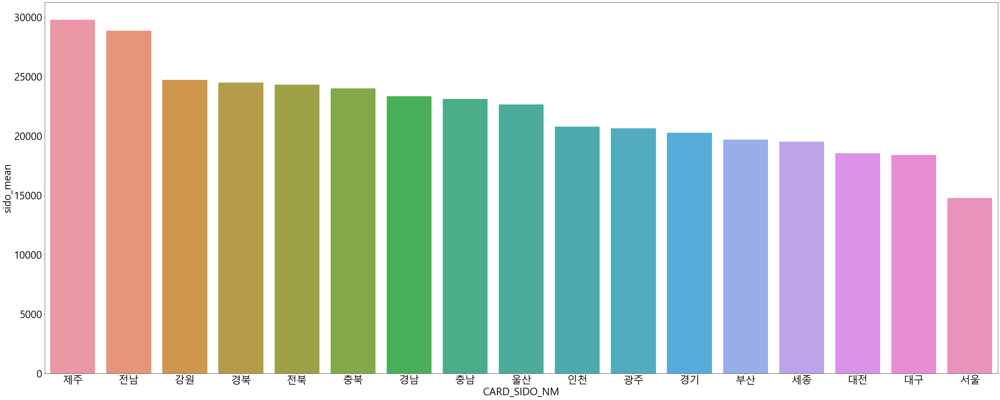

In [100]:
plt.figure(figsize = (50,20))
plt.rcParams.update({'font.size': 30})
sns.barplot(data=amt_cnt_sido,x= "CARD_SIDO_NM", y= 'sido_mean')

In [101]:
amt_clss=train[['STD_CLSS_NM','AMT']].groupby("STD_CLSS_NM").sum()


amt_clss= amt_clss.reset_index()
amt_clss=amt_clss.sort_values(by="AMT",ascending=False)
amt_clss

,STD_CLSS_NM,AMT
37,한식 음식점업,13737489719551
33,차량용 주유소 운영업,7708652073883
7,기타 대형 종합 소매업,7328854819388
20,슈퍼마켓,6730329364274
34,체인화 편의점,5303958703193
18,서양식 음식점업,1748358904526
35,택시 운송업,1733409541974
11,기타음식료품위주종합소매업,1569246626978
21,스포츠 및 레크레이션 용품 임대업,1245725426753
25,육류 소매업,1166039087386


In [102]:
cnt_clss

,STD_CLSS_NM,CNT
34,체인화 편의점,786933354
37,한식 음식점업,459130888
20,슈퍼마켓,422258631
7,기타 대형 종합 소매업,231338754
35,택시 운송업,231011553
16,비알콜 음료점업,164698712
33,차량용 주유소 운영업,138163614
18,서양식 음식점업,116457610
36,피자 햄버거 샌드위치 및 유사 음식점업,111352234
17,빵 및 과자류 소매업,88422041


In [103]:
amt_cnt_clss = pd.merge(amt_clss, cnt_clss)
amt_cnt_clss 

,STD_CLSS_NM,AMT,CNT
0,한식 음식점업,13737489719551,459130888
1,차량용 주유소 운영업,7708652073883,138163614
2,기타 대형 종합 소매업,7328854819388,231338754
3,슈퍼마켓,6730329364274,422258631
4,체인화 편의점,5303958703193,786933354
5,서양식 음식점업,1748358904526,116457610
6,택시 운송업,1733409541974,231011553
7,기타음식료품위주종합소매업,1569246626978,81708225
8,스포츠 및 레크레이션 용품 임대업,1245725426753,14194845
9,육류 소매업,1166039087386,36744934


In [104]:
amt_cnt_clss["clss_mean"]= amt_cnt_clss["AMT"]/amt_cnt_clss["CNT"]
amt_cnt_clss=amt_cnt_clss.sort_values(by="clss_mean",ascending=False)
amt_cnt_clss

,STD_CLSS_NM,AMT,CNT,clss_mean
30,여행사업,109016697282,296628,367519.91478
20,정기 항공 운송업,581098689779,2453445,236850.09844
35,자동차 임대업,28378647000,178093,159347.34661
19,골프장 운영업,595701968828,4951383,120310.21814
21,일반유흥 주점업,541315173187,4907804,110296.81976
36,마사지업,20199890964,190516,106027.26786
29,기타 주점업,164753620805,1641765,100351.52461
22,면세점,404512192532,4194293,96443.47511
31,건강보조식품 소매업,105126364380,1097627,95776.03720
8,스포츠 및 레크레이션 용품 임대업,1245725426753,14194845,87759.00172


## AMT 평균 수정 시각화

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40]),
 <a list of 41 Text xticklabel objects>)

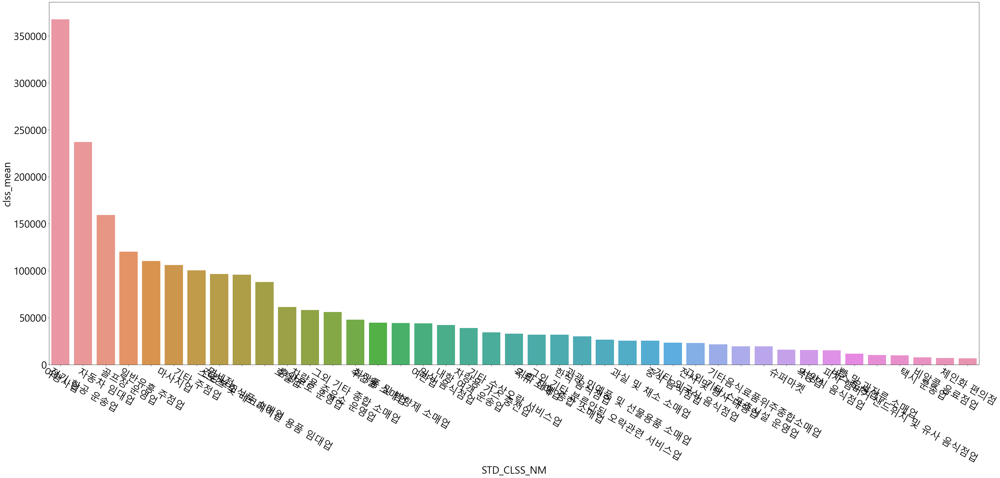

In [105]:
plt.figure(figsize = (50,20))
sns.barplot(data=amt_cnt_clss,x= "STD_CLSS_NM", y= 'clss_mean')
plt.rc('font', size=15)
plt.xticks(rotation = -30)

In [7]:
clss_g = train.groupby(['STD_CLSS_NM','CARD_SIDO_NM'])['AMT','CNT'].sum()
clss_g = pd.DataFrame(clss_g)
clss_g

C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  """Entry point for launching an IPython kernel.


AMT     CNT
STD_CLSS_NM CARD_SIDO_NM                     
건강보조식품 소매업  강원             1820824382   16170
            경기            21313151258  227521
            경남             5406038964   52310
            경북             3564454980   28506
            광주             3619007849   28428
...                               ...     ...
휴양콘도 운영업    전남             4192316889   73010
            전북             6346178051   92415
            제주             7475474469  107836
            충남             3967138248   67556
            충북             2414736980   40731

[650 rows x 2 columns]

In [8]:
clss_g["clss_g_mean"]=clss_g["AMT"]/clss_g["CNT"]
clss_g

AMT     CNT    clss_g_mean
STD_CLSS_NM CARD_SIDO_NM                                    
건강보조식품 소매업  강원             1820824382   16170  112605.094743
            경기            21313151258  227521   93675.534381
            경남             5406038964   52310  103346.185509
            경북             3564454980   28506  125042.271101
            광주             3619007849   28428  127304.342514
...                               ...     ...            ...
휴양콘도 운영업    전남             4192316889   73010   57421.132571
            전북             6346178051   92415   68670.432841
            제주             7475474469  107836   69322.623883
            충남             3967138248   67556   58723.699568
            충북             2414736980   40731   59284.991284

[650 rows x 3 columns]

In [68]:
clss_g.loc["자동차 임대업"]

,AMT,CNT,clss_g_mean
CARD_SIDO_NM,,,
강원,56786937,363,156437.842975
경기,15240775734,32066,475293.947920
경남,64207614,338,189963.355030
경북,48779271,298,163688.828859
광주,75413412,431,174973.113689
대구,73156926,596,122746.520134
대전,21351647,151,141401.635762
부산,201408067,1666,120893.197479
서울,4770657611,28972,164664.421200


In [108]:
CLSS_NM_uniq

array(['건강보조식품 소매업', '골프장 운영업', '과실 및 채소 소매업', '관광 민예품 및 선물용품 소매업',
       '그외 기타 스포츠시설 운영업', '그외 기타 종합 소매업', '기타 대형 종합 소매업', '기타 외국식 음식점업',
       '기타 주점업', '기타음식료품위주종합소매업', '마사지업', '비알콜 음료점업', '빵 및 과자류 소매업',
       '서양식 음식점업', '수산물 소매업', '슈퍼마켓', '스포츠 및 레크레이션 용품 임대업', '여관업', '욕탕업',
       '육류 소매업', '일반유흥 주점업', '일식 음식점업', '전시 및 행사 대행업', '중식 음식점업',
       '차량용 가스 충전업', '차량용 주유소 운영업', '체인화 편의점', '피자 햄버거 샌드위치 및 유사 음식점업',
       '한식 음식점업', '호텔업', '화장품 및 방향제 소매업', '휴양콘도 운영업', '여행사업', '자동차 임대업',
       '면세점', '버스 운송업', '택시 운송업', '기타 수상오락 서비스업', '내항 여객 운송업',
       '그외 기타 분류안된 오락관련 서비스업', '정기 항공 운송업'], dtype=object)

In [109]:
clss_g.loc[CLSS_NM_uniq[3]]

,AMT,CNT,clss_g_mean
CARD_SIDO_NM,,,
강원,457212008,22012,20771.03434
경기,1918411391,79575,24108.21729
경남,746296081,23213,32149.91948
경북,786397642,45459,17299.05282
광주,194631290,7242,26875.35073
대구,380096905,8061,47152.57474
대전,238234991,6232,38227.69432
부산,997758961,24683,40422.92108
서울,3346798725,168440,19869.38212


In [110]:
clss_g.loc[CLSS_NM_uniq[2]]

,AMT,CNT,clss_g_mean
CARD_SIDO_NM,,,
강원,16675489268,428427,38922.59187
경기,104789326737,4847063,21619.13859
경남,42281889072,1270009,33292.59011
경북,29057027933,833145,34876.31557
광주,27007077534,846938,31887.90388
대구,36395145714,1875995,19400.44921
대전,13882801638,518035,26798.96462
부산,69244220590,3878885,17851.57863
서울,110331062192,4899447,22519.08474


C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max

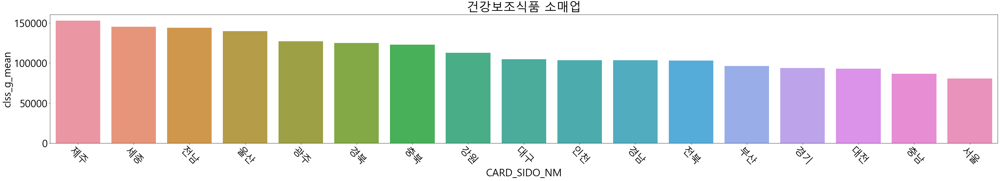

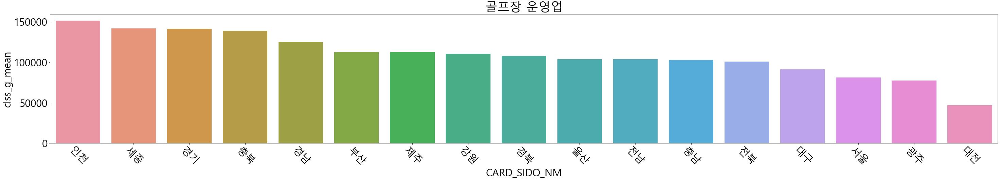

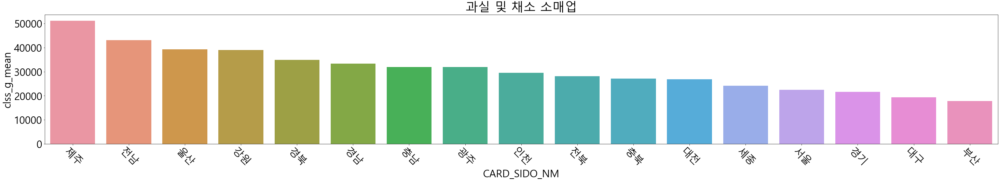

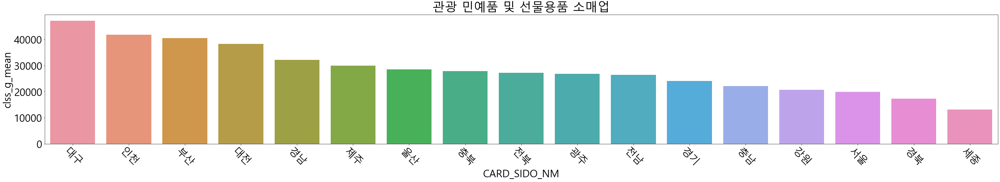

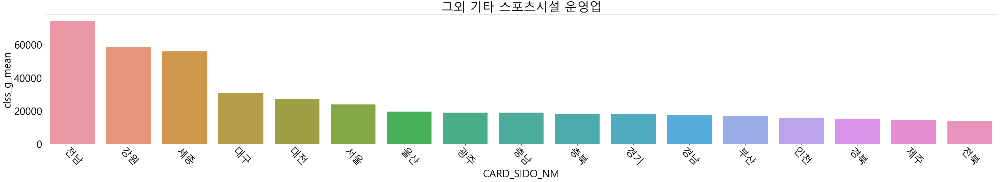

...

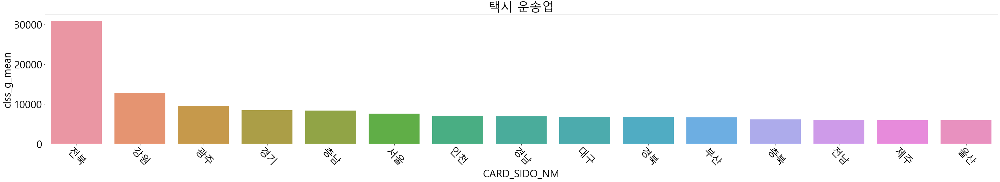

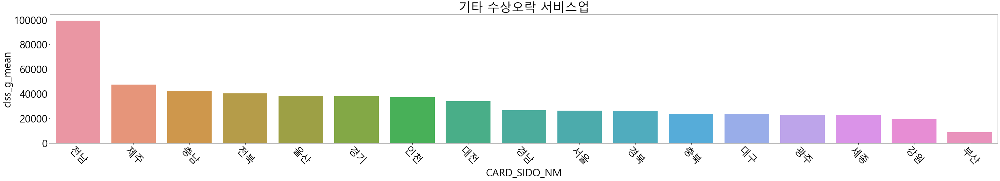

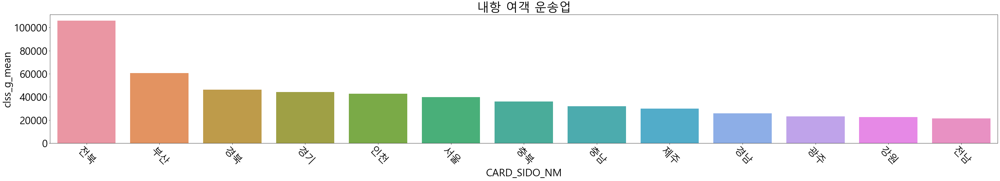

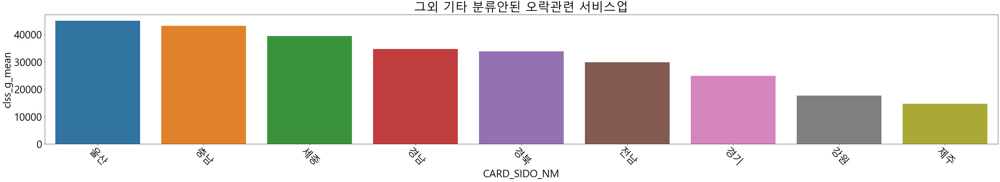

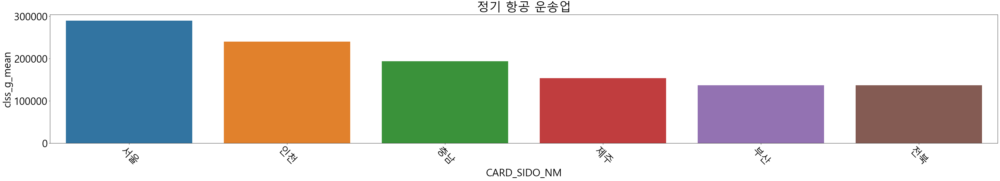

In [111]:
a = 0
for i in CLSS_NM_uniq :
#     c=b[i]    
    
    data = clss_g.loc[CLSS_NM_uniq[a]].sort_values(by = 'clss_g_mean', ascending = False)
    plt.figure(figsize = (50,7))
    plt.rcParams.update({'font.size': 30})
    plt.xticks(rotation = - 45 )
    b = sns.barplot(data= data, x= data.index, y= 'clss_g_mean')
    plt.title(i)
    a+=1
    
#  업종별로 인당 -지역에서 얼마나 돈을 많이 쓰는지 확인 가능

In [112]:
sido_g = train.groupby(['CARD_SIDO_NM','STD_CLSS_NM'])['AMT','CNT'].sum()
sido_g = pd.DataFrame(sido_g)
sido_g

C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  """Entry point for launching an IPython kernel.


AMT       CNT
CARD_SIDO_NM STD_CLSS_NM                                  
강원           건강보조식품 소매업               1820824382     16170
             골프장 운영업                 51290887138    465266
             과실 및 채소 소매업             16675489268    428427
             관광 민예품 및 선물용품 소매업         457212008     22012
             그외 기타 분류안된 오락관련 서비스업         177000        10
...                                          ...       ...
충북           피자 햄버거 샌드위치 및 유사 음식점업   21294163365   2004621
             한식 음식점업                327145423793  11522939
             호텔업                       530914357     11641
             화장품 및 방향제 소매업            9175488855    224483
             휴양콘도 운영업                 2414736980     40731

[650 rows x 2 columns]

In [113]:
sido_g["sido_g_mean"]=sido_g["AMT"]/sido_g["CNT"]
sido_g

AMT       CNT  sido_g_mean
CARD_SIDO_NM STD_CLSS_NM                                               
강원           건강보조식품 소매업               1820824382     16170 112605.09474
             골프장 운영업                 51290887138    465266 110239.92112
             과실 및 채소 소매업             16675489268    428427  38922.59187
             관광 민예품 및 선물용품 소매업         457212008     22012  20771.03434
             그외 기타 분류안된 오락관련 서비스업         177000        10  17700.00000
...                                          ...       ...          ...
충북           피자 햄버거 샌드위치 및 유사 음식점업   21294163365   2004621  10622.53831
             한식 음식점업                327145423793  11522939  28390.79716
             호텔업                       530914357     11641  45607.28090
             화장품 및 방향제 소매업            9175488855    224483  40873.86954
             휴양콘도 운영업                 2414736980     40731  59284.99128

[650 rows x 3 columns]

In [114]:
SIDO_NM_uniq

array(['강원', '경기', '경남', '경북', '광주', '대구', '대전', '부산', '서울', '세종', '울산',
       '인천', '전남', '전북', '제주', '충남', '충북'], dtype=object)

## 시도별 업종으로 수정 AMT 평균 시각화

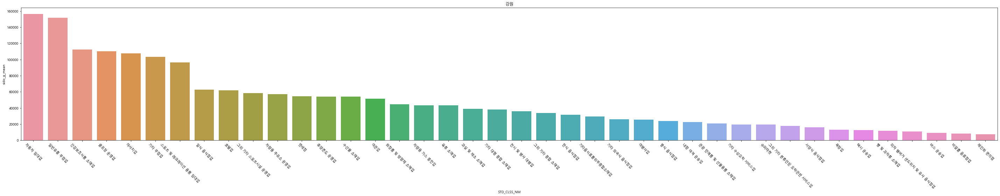

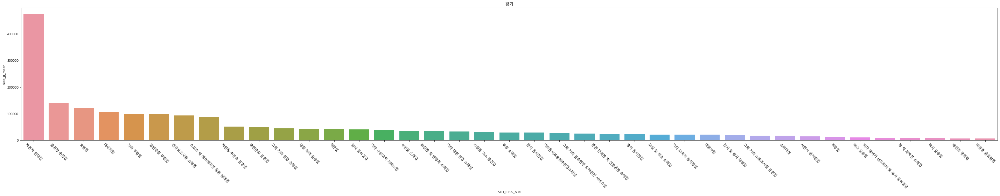

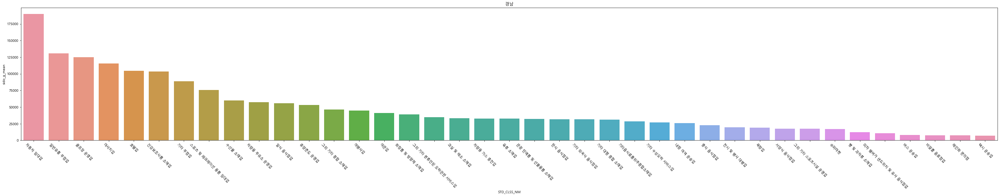

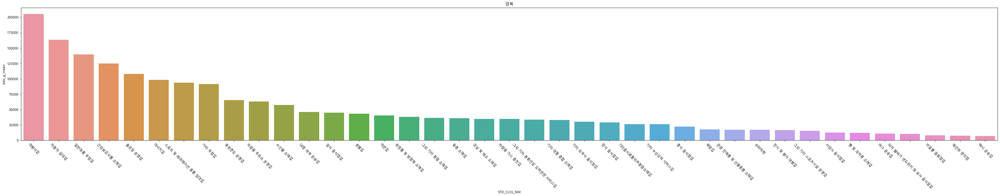

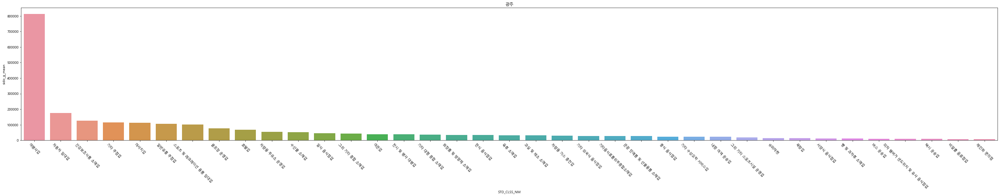

...

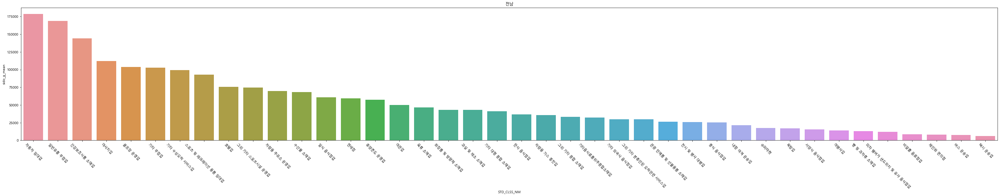

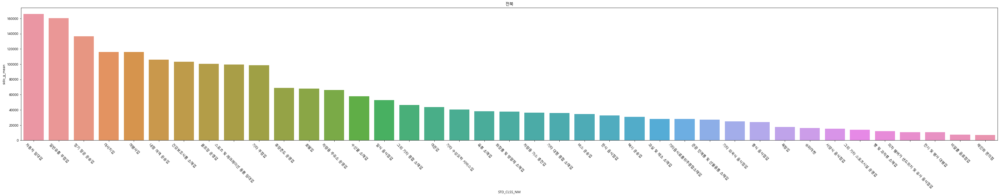

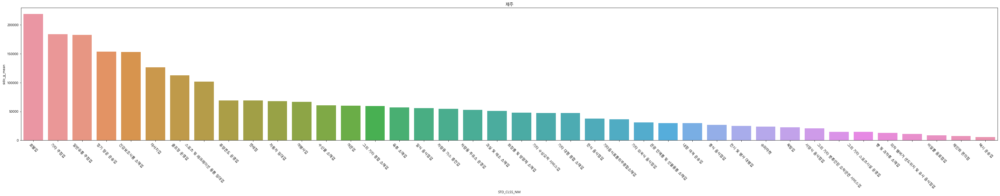

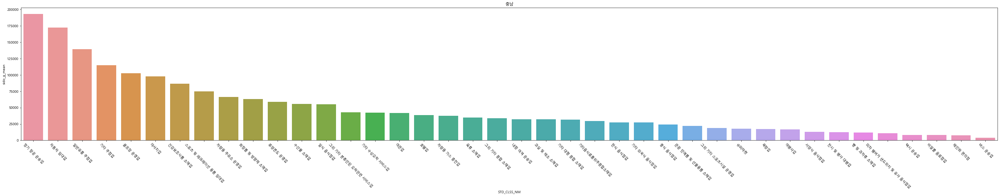

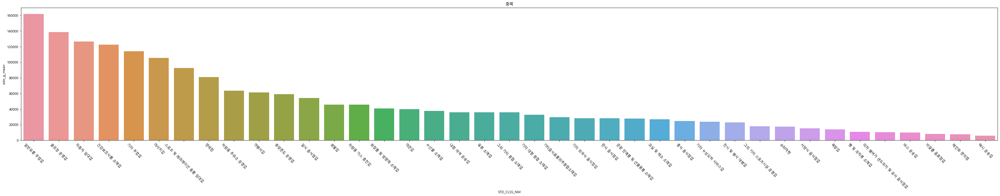

In [115]:
a = 0
for i in SIDO_NM_uniq :
#     c=b[i]    
    
    data = sido_g.loc[SIDO_NM_uniq[a]].sort_values(by = 'sido_g_mean', ascending = False)
    plt.figure(figsize = (50,7))
    plt.rcParams.update({'font.size': 10})
    plt.xticks(rotation = - 45 )
    b = sns.barplot(data= data, x= data.index, y= 'sido_g_mean')
    plt.title(i)
    a+=1
    
#  시도별로 인당 -업종에서 얼마나 돈을 많이 쓰는지 확인 가능

### 사용자 정보(연령, 성별, FLC)에 따른 업종별 분석 

In [6]:
train.head()

,Unnamed: 0,REG_YYMM,CARD_SIDO_NM,CARD_CCG_NM,STD_CLSS_NM,HOM_SIDO_NM,HOM_CCG_NM,AGE,SEX_CTGO_CD,FLC,CSTMR_CNT,AMT,CNT,user
0,0,201901,강원,강릉시,건강보조식품 소매업,강원,강릉시,20s,1,1,4,311200,4,20s1
1,1,201901,강원,강릉시,건강보조식품 소매업,강원,강릉시,30s,1,2,7,1374500,8,30s1
2,2,201901,강원,강릉시,건강보조식품 소매업,강원,강릉시,30s,2,2,6,818700,6,30s2
3,3,201901,강원,강릉시,건강보조식품 소매업,강원,강릉시,40s,1,3,4,1717000,5,40s1
4,4,201901,강원,강릉시,건강보조식품 소매업,강원,강릉시,40s,1,4,3,1047300,3,40s1


In [8]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24697792 entries, 0 to 24697791
Data columns (total 14 columns):
 #   Column        Dtype 
---  ------        ----- 
 0   Unnamed: 0    int64 
 1   REG_YYMM      int64 
 2   CARD_SIDO_NM  object
 3   CARD_CCG_NM   object
 4   STD_CLSS_NM   object
 5   HOM_SIDO_NM   object
 6   HOM_CCG_NM    object
 7   AGE           object
 8   SEX_CTGO_CD   int64 
 9   FLC           int64 
 10  CSTMR_CNT     int64 
 11  AMT           int64 
 12  CNT           int64 
 13  user          object
dtypes: int64(7), object(7)
memory usage: 2.6+ GB


In [143]:
# train["SEX_CTGO_CD"] =train["SEX_CTGO_CD"].astype(str)
# train["FLC"] =train["FLC"].astype(str)


In [144]:
# train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24697792 entries, 0 to 24697791
Data columns (total 12 columns):
 #   Column        Dtype 
---  ------        ----- 
 0   REG_YYMM      int64 
 1   CARD_SIDO_NM  object
 2   CARD_CCG_NM   object
 3   STD_CLSS_NM   object
 4   HOM_SIDO_NM   object
 5   HOM_CCG_NM    object
 6   AGE           object
 7   SEX_CTGO_CD   object
 8   FLC           object
 9   CSTMR_CNT     int64 
 10  AMT           int64 
 11  CNT           int64 
dtypes: int64(4), object(8)
memory usage: 2.2+ GB


In [7]:
# train['user'] = train[['AGE', 'SEX_CTGO_CD']].apply(lambda x: ''.join(x), axis=1)

In [ ]:
train.head()

In [ ]:
# train.to_csv("data/new_train.csv")

In [13]:

train_user=train[["STD_CLSS_NM", "user", "CSTMR_CNT"]].groupby(["STD_CLSS_NM", "user"]).sum()
train_user

CSTMR_CNT
STD_CLSS_NM user           
건강보조식품 소매업  10s1        134
            10s2        170
            20s1       7573
            20s2      15492
            30s1      56957
...                     ...
휴양콘도 운영업    50s2      52925
            60s1      37052
            60s2      20142
            70s1       6088
            70s2       2227

[565 rows x 1 columns]

In [14]:
train_clssuser=train_user.loc["건강보조식품 소매업"].sort_values("CSTMR_CNT")

In [15]:
train_clssuser

,CSTMR_CNT
user,
10s1,134
10s2,170
20s1,7573
20s2,15492
70s1,37564
70s2,51098
30s1,56957
40s1,59056
40s2,78164


In [16]:
train_clssuser.reset_index()

,user,CSTMR_CNT
0,10s1,134
1,10s2,170
2,20s1,7573
3,20s2,15492
4,70s1,37564
5,70s2,51098
6,30s1,56957
7,40s1,59056
8,40s2,78164
9,30s2,82333


In [17]:
train_clssuser['user'] = train_clssuser.index
train_clssuser

,CSTMR_CNT,user
user,,
10s1,134,10s1
10s2,170,10s2
20s1,7573,20s1
20s2,15492,20s2
70s1,37564,70s1
70s2,51098,70s2
30s1,56957,30s1
40s1,59056,40s1
40s2,78164,40s2


## 업종별 user(나이성별) CSTMR_CNT

Text(0.5, 1.0, '건강보조식품')

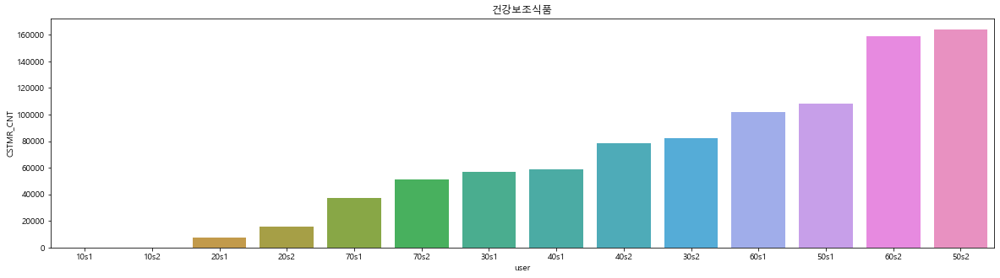

In [18]:
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = [20, 5] # [width, height] (inches)
sns.barplot(x="user", y="CSTMR_CNT", data=train_clssuser,capsize=.2).set_title("건강보조식품")

Text(0.5, 1.0, '한식 음식점업')

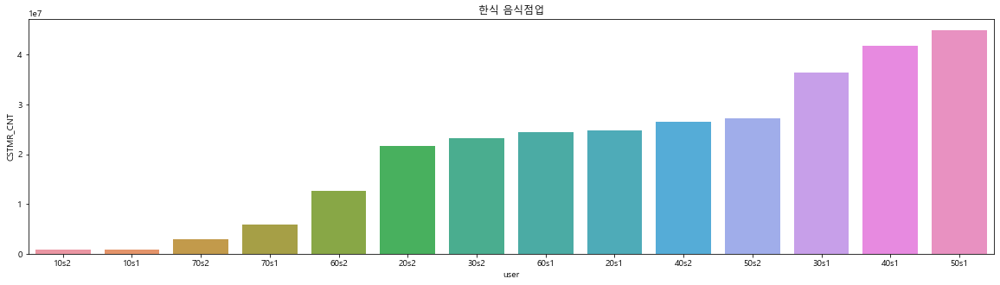

In [19]:
train_clssuser=train_user.loc["한식 음식점업"].sort_values("CSTMR_CNT")
train_clssuser.reset_index()

train_clssuser['user'] = train_clssuser.index
train_clssuser

plt.rcParams['figure.figsize'] = [20, 5] # [width, height] (inches)
sns.barplot(x="user", y="CSTMR_CNT", data=train_clssuser,capsize=.2).set_title("한식 음식점업")

Text(0.5, 1.0, '체인화 편의점')

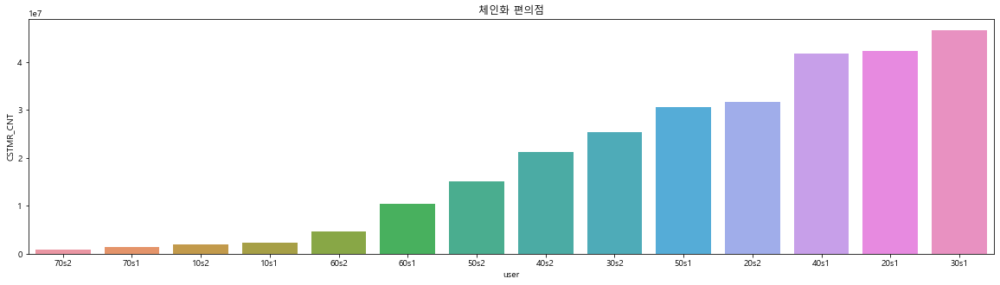

In [20]:
train_clssuser=train_user.loc["체인화 편의점"].sort_values("CSTMR_CNT")
train_clssuser.reset_index()

train_clssuser['user'] = train_clssuser.index
train_clssuser

plt.rcParams['figure.figsize'] = [20, 5] # [width, height] (inches)
sns.barplot(x="user", y="CSTMR_CNT", data=train_clssuser,capsize=.2).set_title("체인화 편의점")

Text(0.5, 1.0, '슈퍼마켓')

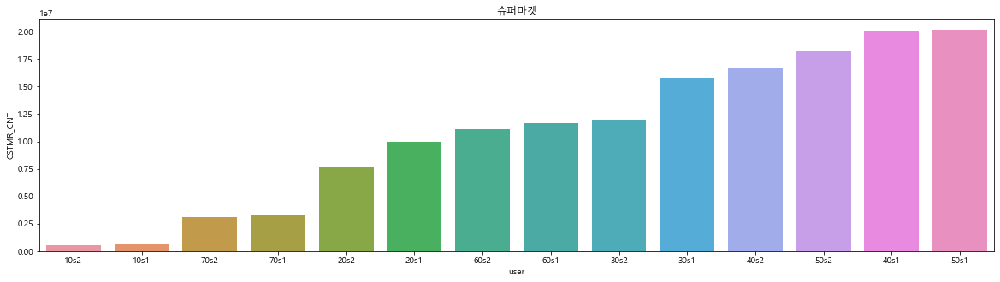

In [21]:
train_clssuser=train_user.loc["슈퍼마켓"].sort_values("CSTMR_CNT")
train_clssuser.reset_index()

train_clssuser['user'] = train_clssuser.index
train_clssuser

plt.rcParams['figure.figsize'] = [20, 5] # [width, height] (inches)
sns.barplot(x="user", y="CSTMR_CNT", data=train_clssuser,capsize=.2).set_title("슈퍼마켓")

Text(0.5, 1.0, '차량용 주유소 운영업')

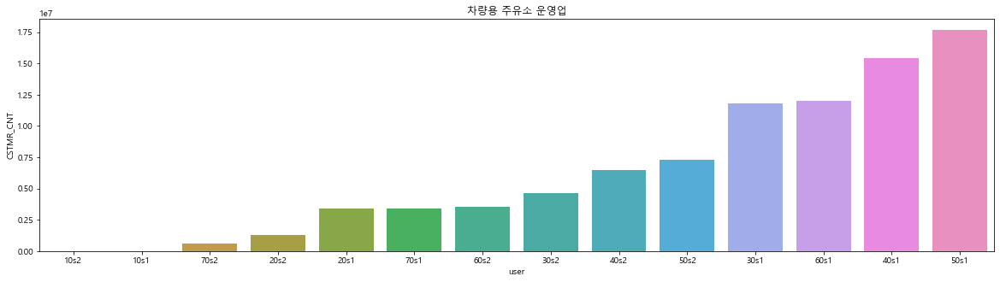

In [22]:
train_clssuser=train_user.loc["차량용 주유소 운영업"].sort_values("CSTMR_CNT")
train_clssuser.reset_index()

train_clssuser['user'] = train_clssuser.index
train_clssuser

plt.rcParams['figure.figsize'] = [20, 5] # [width, height] (inches)
sns.barplot(x="user", y="CSTMR_CNT", data=train_clssuser,capsize=.2).set_title("차량용 주유소 운영업")

Text(0.5, 1.0, '택시 운송업')

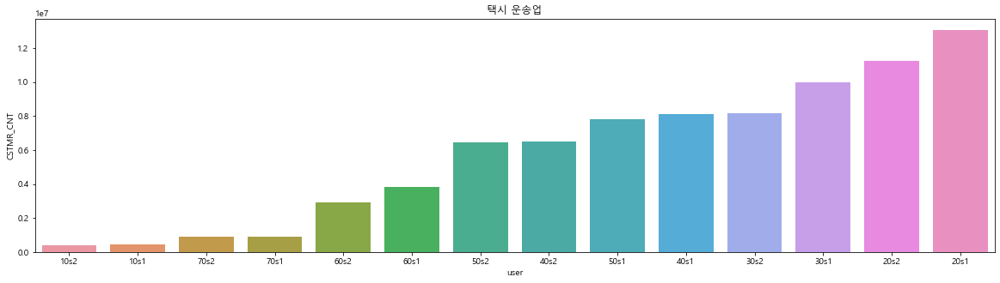

In [23]:
train_clssuser=train_user.loc["택시 운송업"].sort_values("CSTMR_CNT")
train_clssuser.reset_index()

train_clssuser['user'] = train_clssuser.index
train_clssuser

plt.rcParams['figure.figsize'] = [20, 5] # [width, height] (inches)
sns.barplot(x="user", y="CSTMR_CNT", data=train_clssuser,capsize=.2).set_title("택시 운송업")

In [134]:
sido_clss_amt_sum = train.groupby(['CARD_SIDO_NM','STD_CLSS_NM'])['AMT'].sum()
sido_clss_amt_sum = pd.DataFrame(sido_clss_amt_sum)
sido_clss_amt_sum 

AMT
CARD_SIDO_NM STD_CLSS_NM                        
강원           건강보조식품 소매업               1820824382
             골프장 운영업                 51290887138
             과실 및 채소 소매업             16675489268
             관광 민예품 및 선물용품 소매업         457212008
             그외 기타 분류안된 오락관련 서비스업         177000
...                                          ...
충북           피자 햄버거 샌드위치 및 유사 음식점업   21294163365
             한식 음식점업                327145423793
             호텔업                       530914357
             화장품 및 방향제 소매업            9175488855
             휴양콘도 운영업                 2414736980

[650 rows x 1 columns]

### 분석결과

[건강보조식품업]
50대 이상의 비율 압도적

[한식음식점업] 
50대 남성 

[체인화편의점] 
남성의 비율 높음

[슈퍼마켓]
50대 비율 압도적, 40,30대 남성 순

[차량용 주유소]
50대 남성,60대 남성

## 시간에 따른 업종별 AMT 변화

In [33]:
std_class_amt_sum=train[['REG_YYMM','STD_CLSS_NM','AMT']].groupby(['STD_CLSS_NM','REG_YYMM']).sum()

C:\Users\noeul\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
C:\Users\noeul\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
C:\Users\noeul\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplo

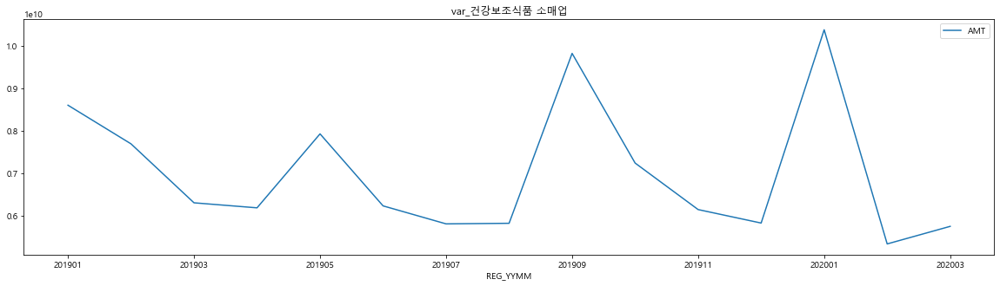

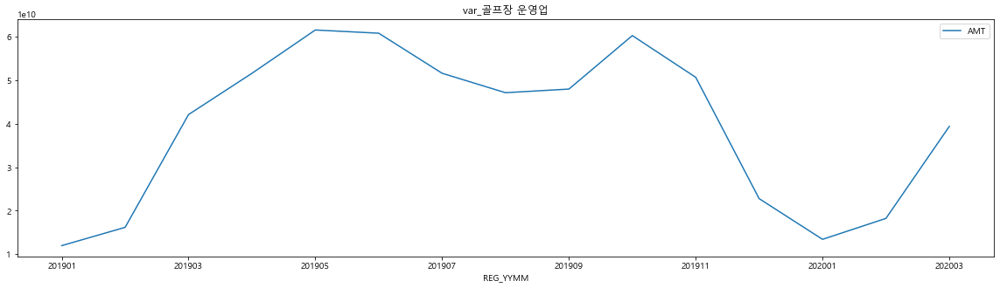

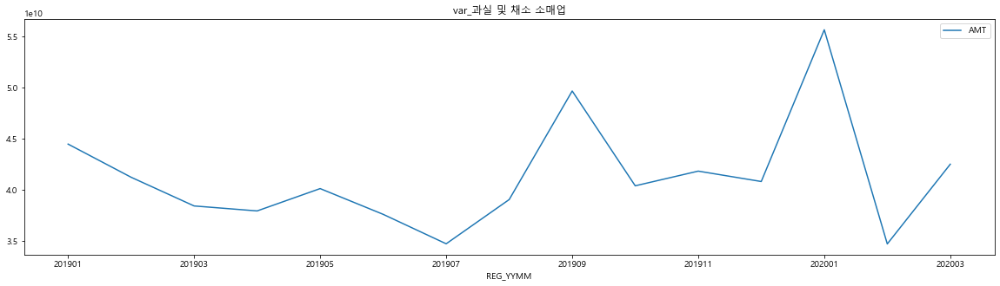

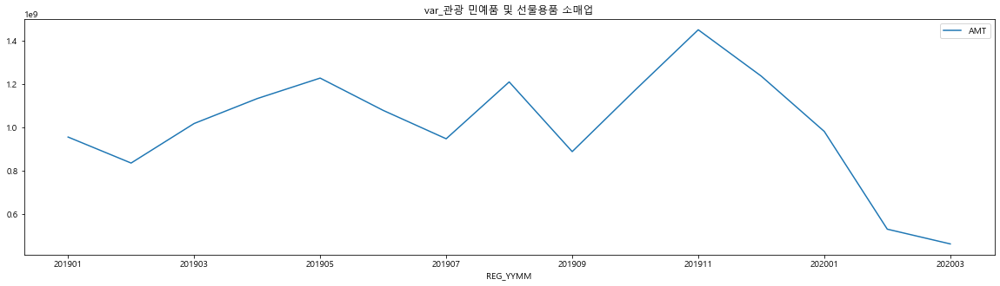

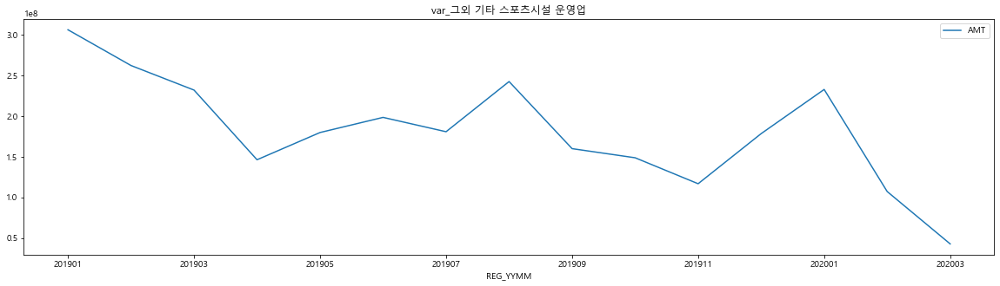

...

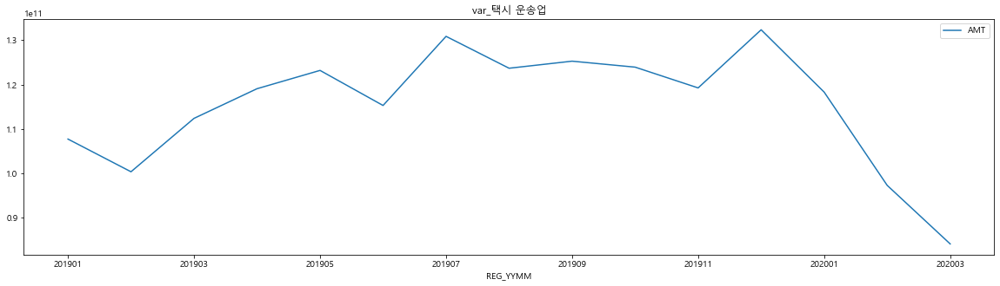

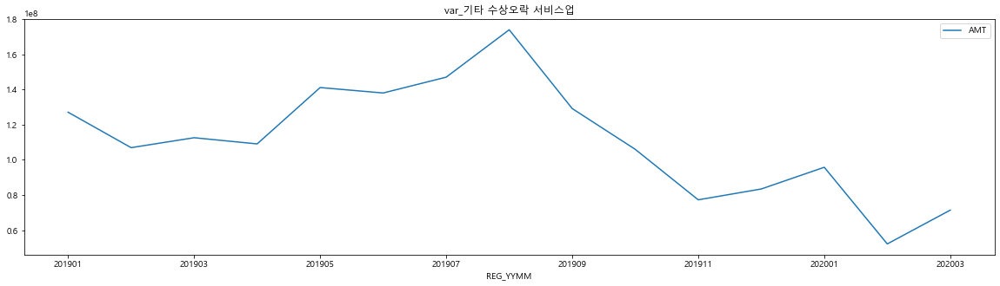

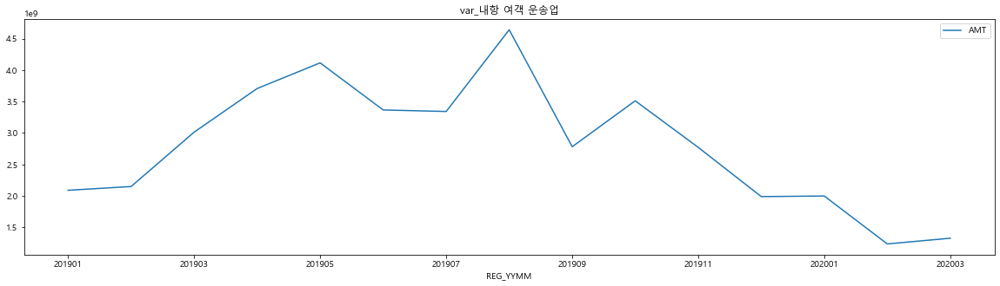

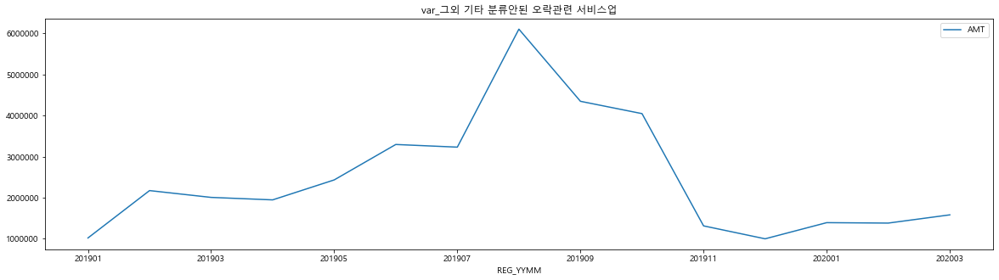

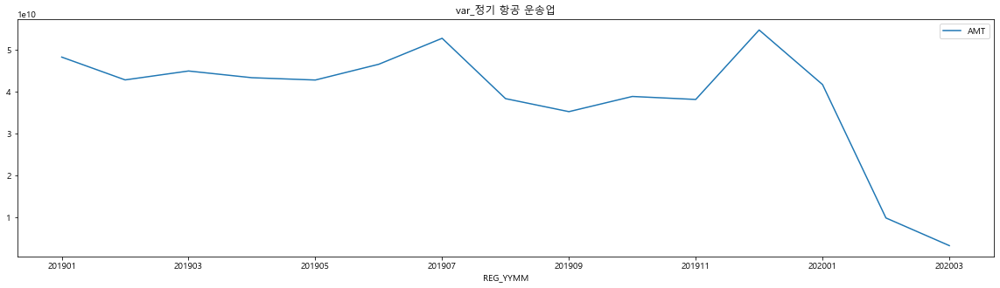

In [34]:
a=[]
b=[]
for i in CLSS_NM_uniq :
#     print('var_{}'.format(i))
    a.append('var_{}'.format(i))
    b.append('var_{}'.format(i))

for i in range(len(CLSS_NM_uniq)) :
    c=b[i]    
    a[i]=std_class_amt_sum.loc[CLSS_NM_uniq[i]]
    
    
    a[i].plot(kind='line')
    
    plt.title(c)

In [36]:
# std_class_amt_mean=train[['REG_YYMM','STD_CLSS_NM','AMT']].groupby(['STD_CLSS_NM','REG_YYMM']).mean()

C:\Users\noeul\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
C:\Users\noeul\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
C:\Users\noeul\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplo

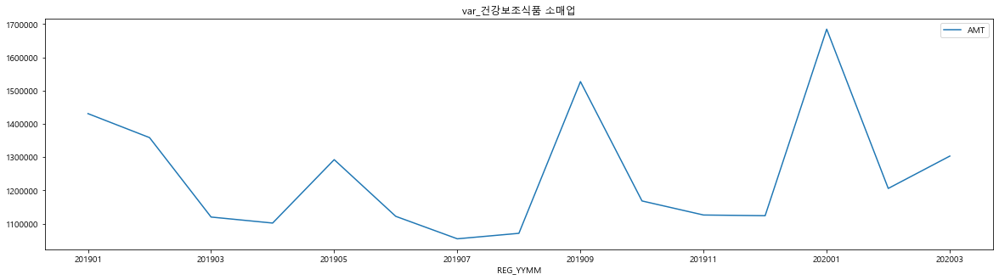

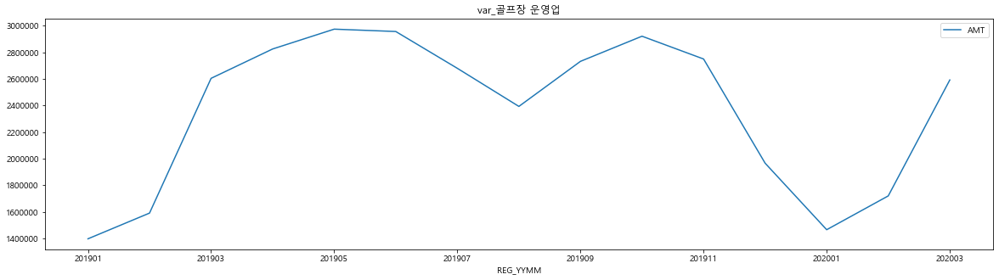

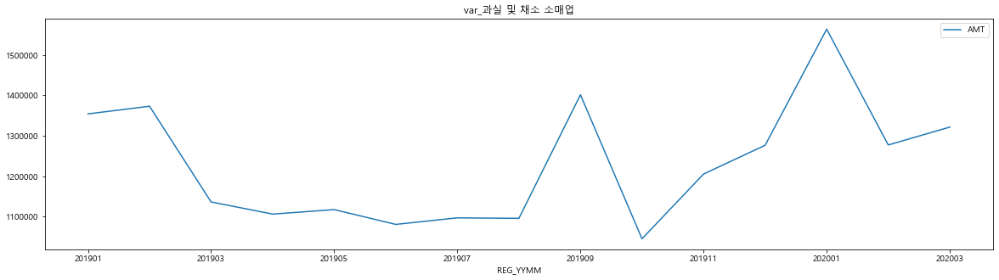

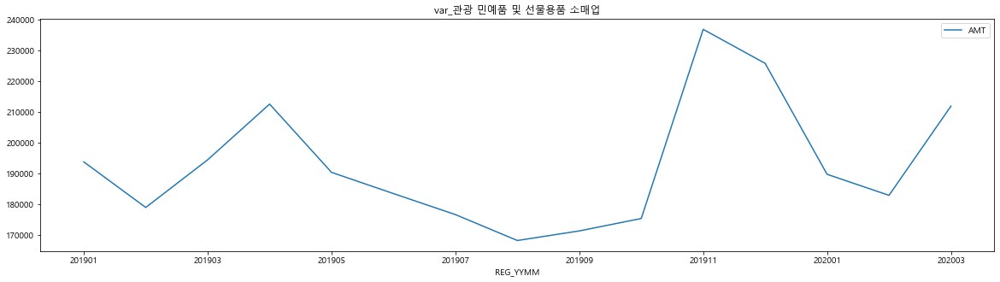

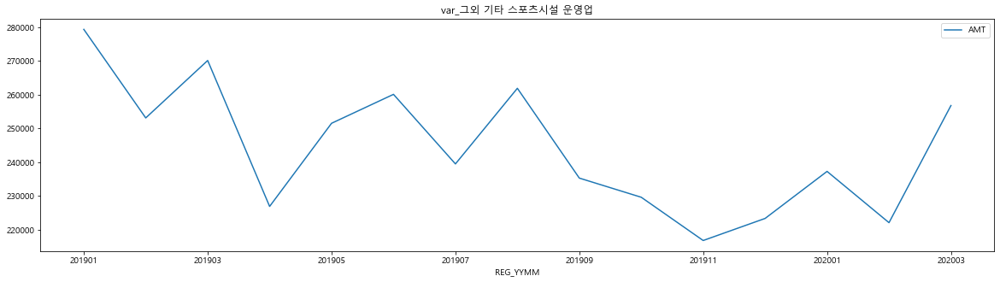

...

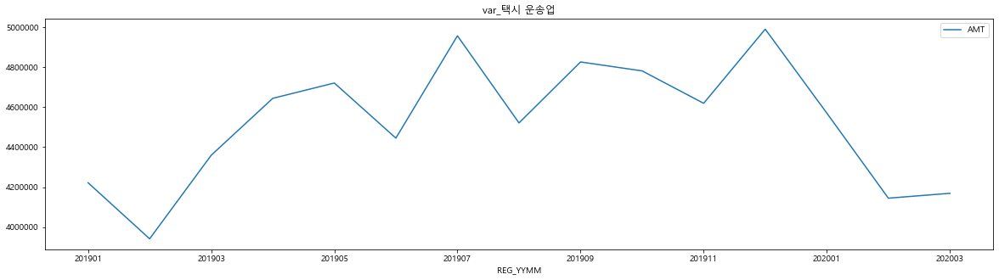

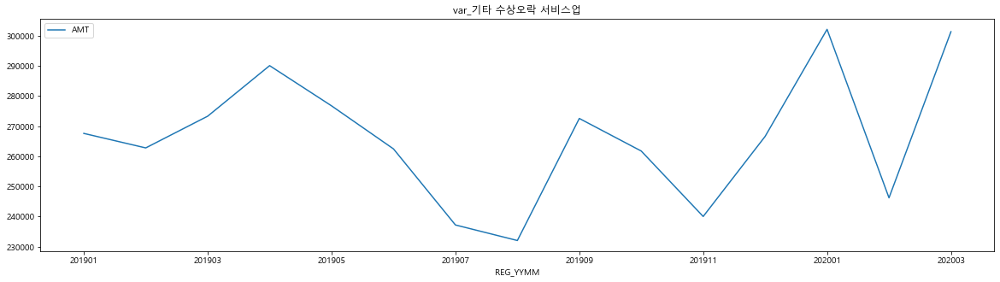

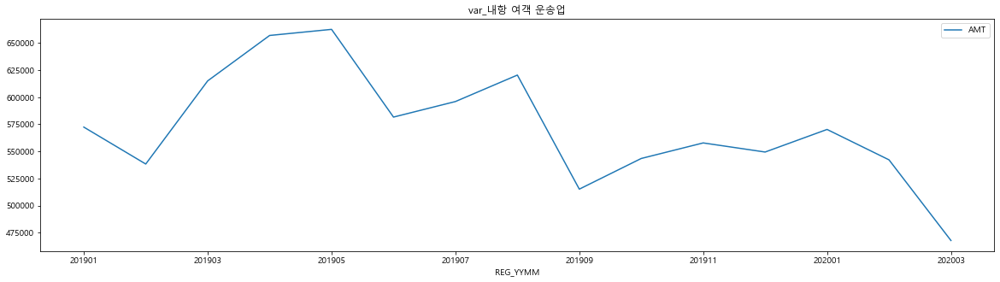

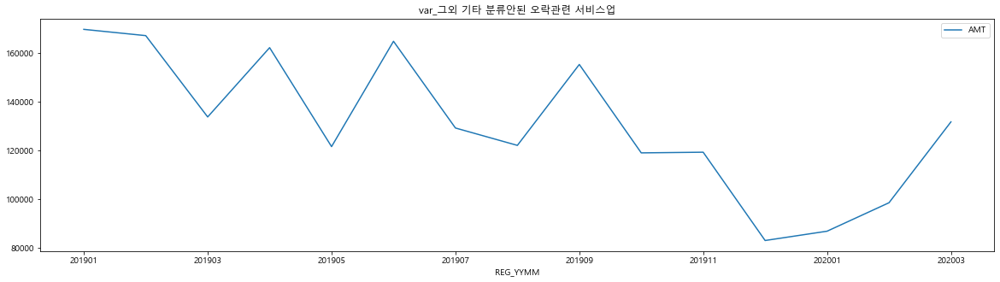

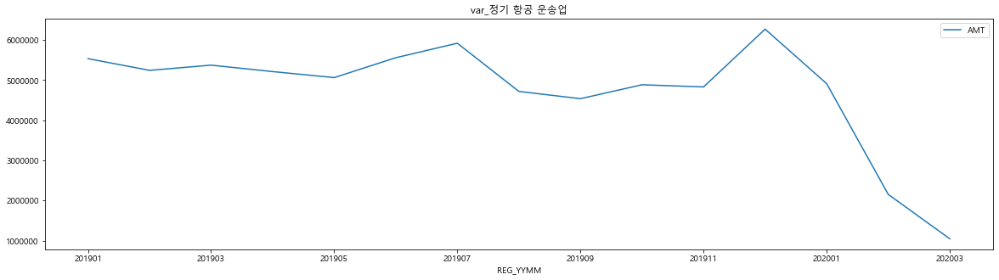

In [37]:
# a=[]
# b=[]
# for i in CLSS_NM_uniq :
# #     print('var_{}'.format(i))
#     a.append('var_{}'.format(i))
#     b.append('var_{}'.format(i))

# for i in range(len(CLSS_NM_uniq)) :
#     c=b[i]    
#     a[i]=std_class_amt_mean.loc[CLSS_NM_uniq[i]]
    
    
#     a[i].plot(kind='line')
    
#     plt.title(c)

## USER과 시계열 관계

In [3]:
train.head()

,Unnamed: 0,REG_YYMM,CARD_SIDO_NM,CARD_CCG_NM,STD_CLSS_NM,HOM_SIDO_NM,HOM_CCG_NM,AGE,SEX_CTGO_CD,FLC,CSTMR_CNT,AMT,CNT,user
0,0,201901,강원,강릉시,건강보조식품 소매업,강원,강릉시,20s,1,1,4,311200,4,20s1
1,1,201901,강원,강릉시,건강보조식품 소매업,강원,강릉시,30s,1,2,7,1374500,8,30s1
2,2,201901,강원,강릉시,건강보조식품 소매업,강원,강릉시,30s,2,2,6,818700,6,30s2
3,3,201901,강원,강릉시,건강보조식품 소매업,강원,강릉시,40s,1,3,4,1717000,5,40s1
4,4,201901,강원,강릉시,건강보조식품 소매업,강원,강릉시,40s,1,4,3,1047300,3,40s1


In [13]:
train["REG_YYMM"] = train["REG_YYMM"].astype(str)

## 남,여 별 업종별 AMT. SUM 시계열 추이

In [46]:

train_clss_s=train[["STD_CLSS_NM", "SEX_CTGO_CD", "REG_YYMM", "AMT"]].groupby(["STD_CLSS_NM", "SEX_CTGO_CD","REG_YYMM"]).sum()
train_clss_s

AMT
STD_CLSS_NM SEX_CTGO_CD REG_YYMM            
건강보조식품 소매업  1           201901    3707985410
                        201902    3516818496
                        201903    2552242773
                        201904    2418978715
                        201905    3183647517
...                                      ...
휴양콘도 운영업    2           201911    1223659899
                        201912    1785752041
                        202001    3030771861
                        202002    1126197511
                        202003     353484542

[1229 rows x 1 columns]

In [48]:
train_clss_s.loc["체인화 편의점"].loc[1]

,AMT
REG_YYMM,
201901,213444472812
201902,190608437593
201903,229492332013
201904,229594368135
201905,254172755618
201906,255055807925
201907,264058708927
201908,268944296376
201909,256889840550


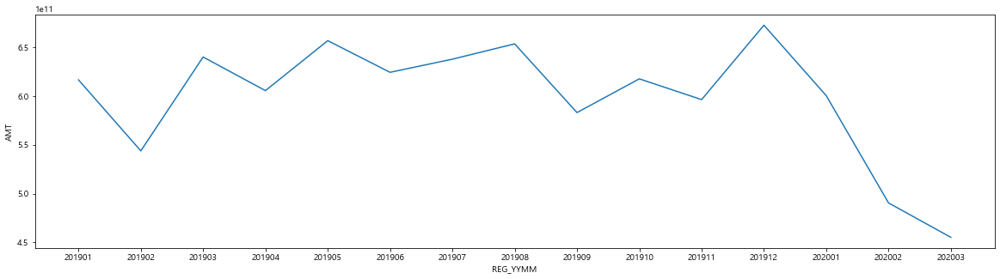

In [15]:
q = train_clss_s.loc["한식 음식점업"].loc[1]
plt.figure(figsize = (20,5))
b = sns.lineplot(data= q, x= q.index, y= 'AMT')

C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figu

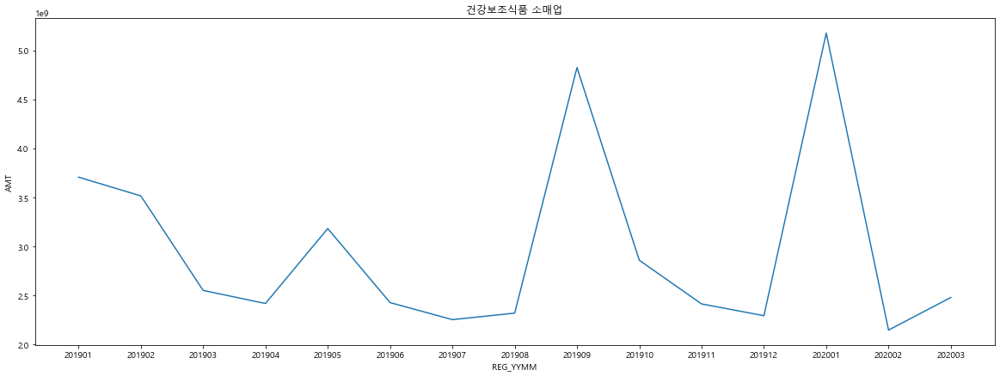

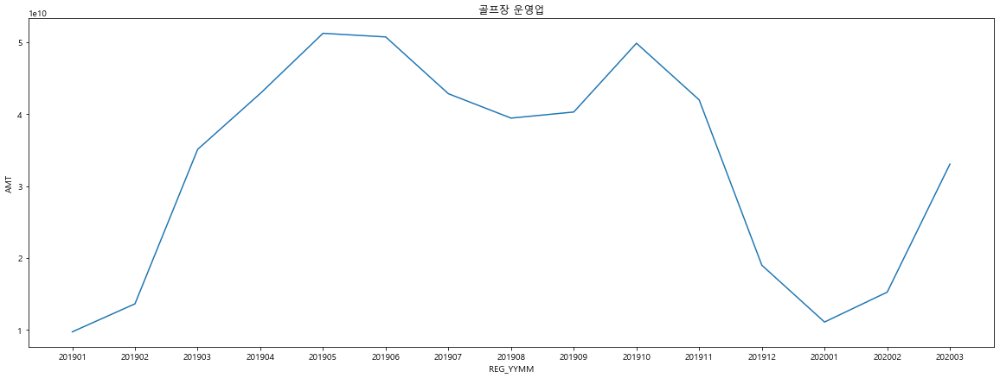

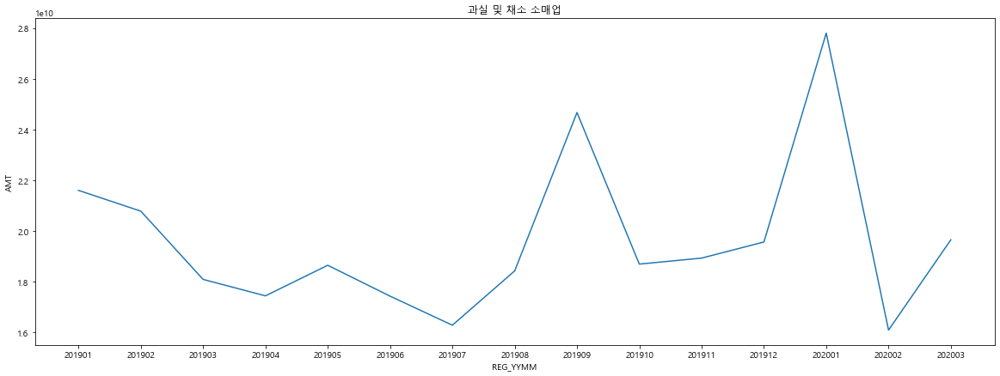

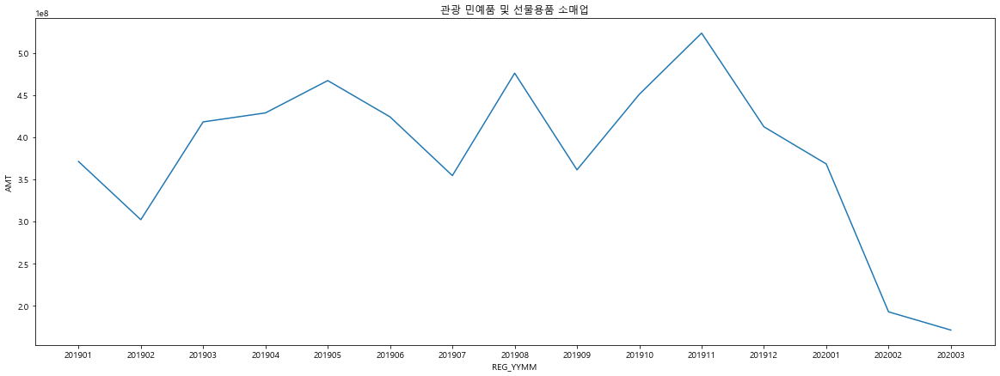

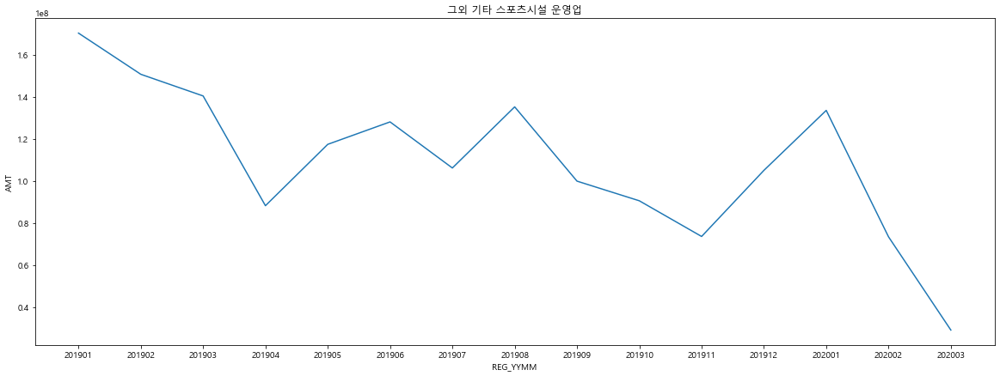

...

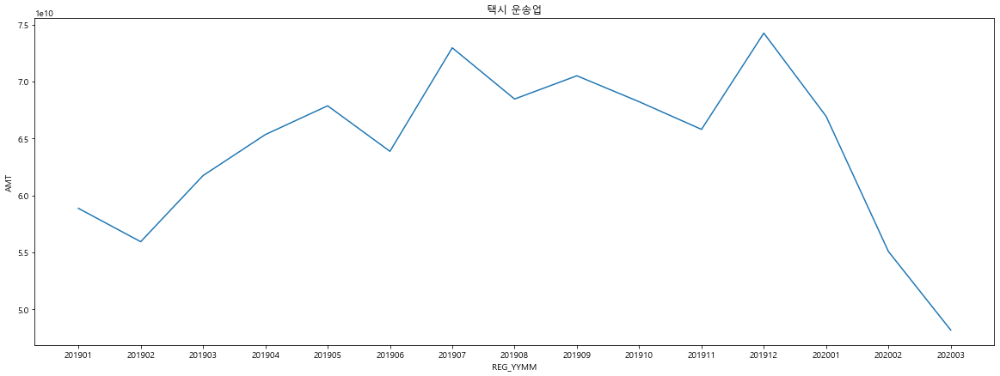

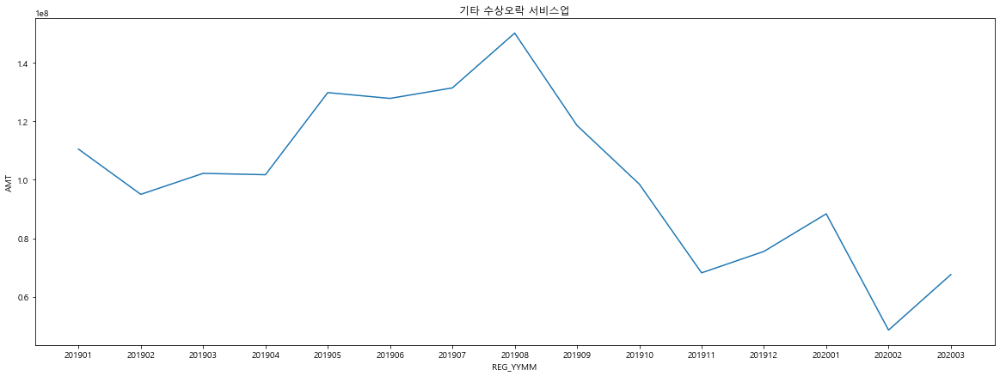

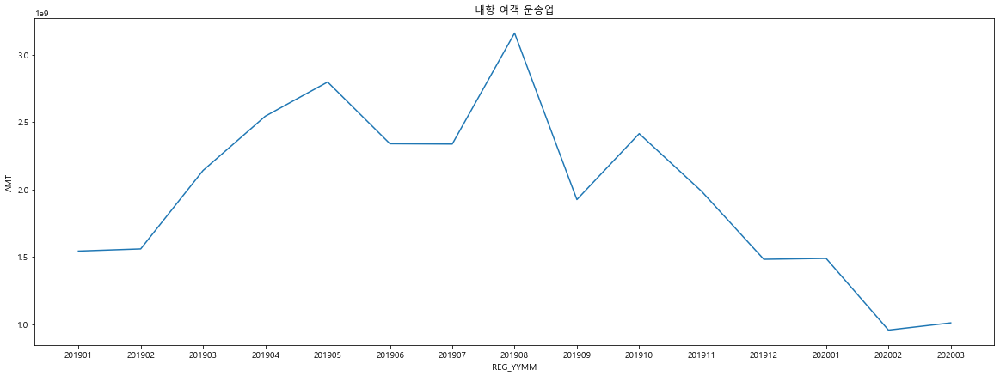

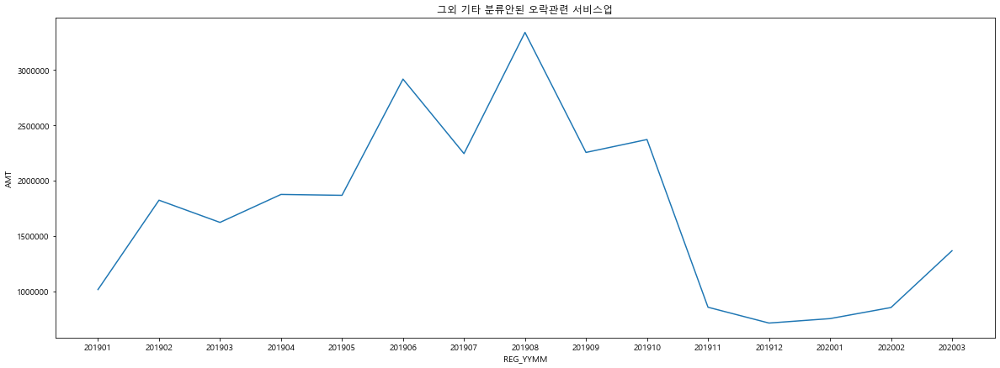

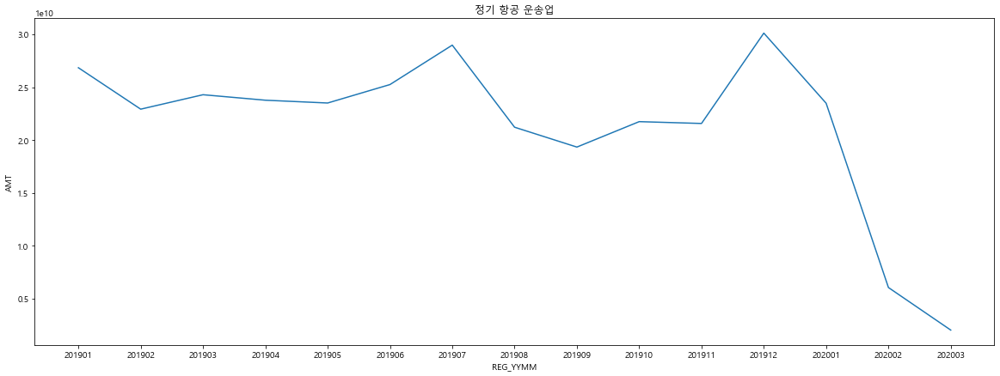

In [17]:
a = 0

for i in  CLSS_NM_uniq :
    q = train_clss_s.loc[i].loc[1]
    plt.figure(figsize = (20,7))
    sns.lineplot(data= q, x= q.index, y= 'AMT')
    plt.title(i)
    a+=1    

C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figu

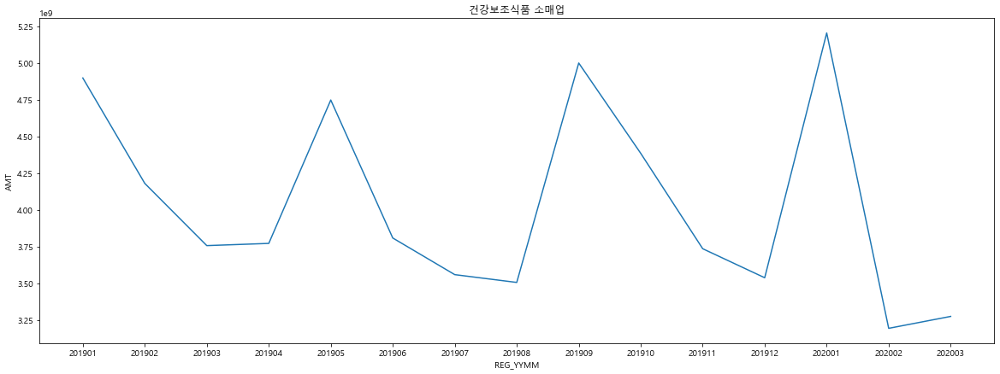

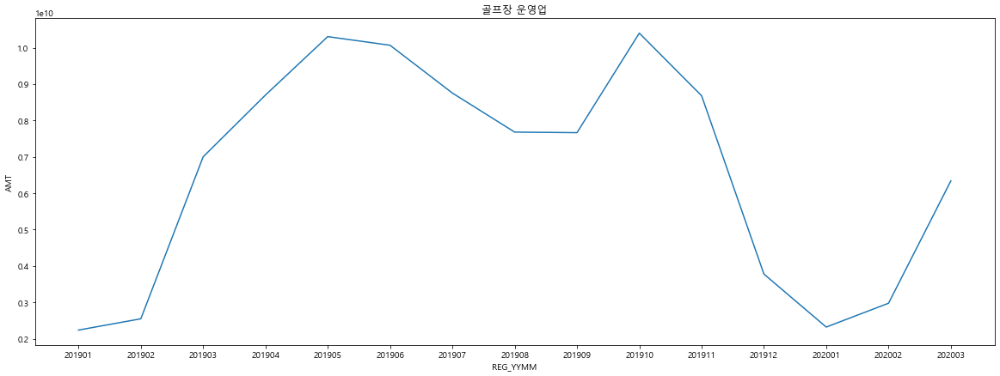

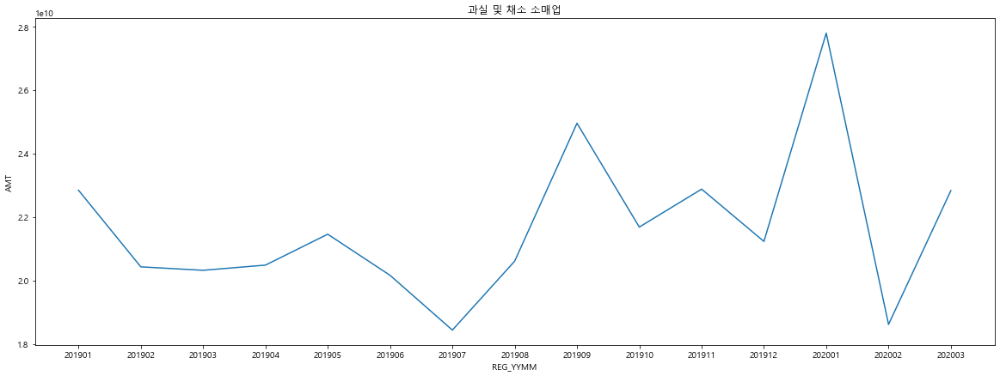

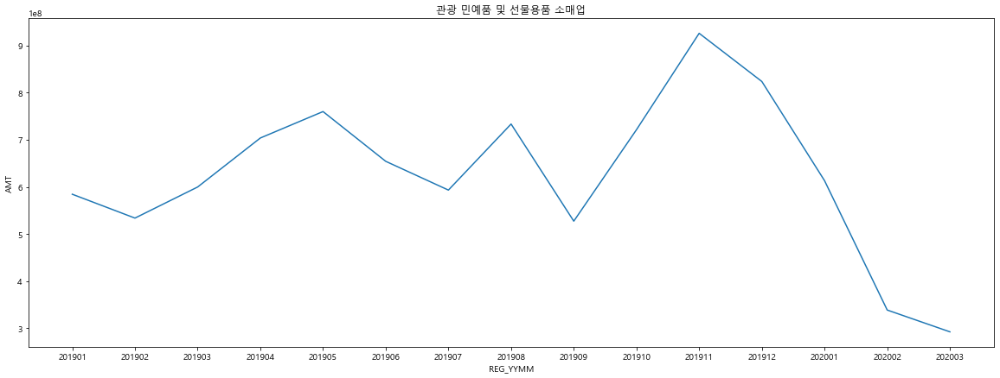

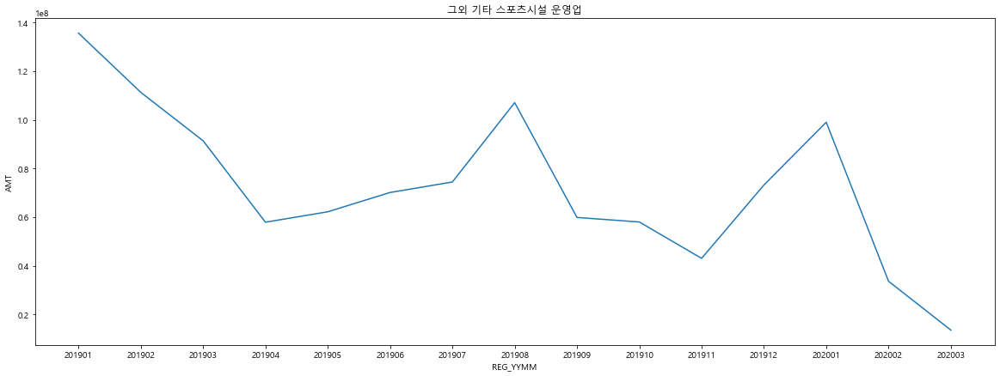

...

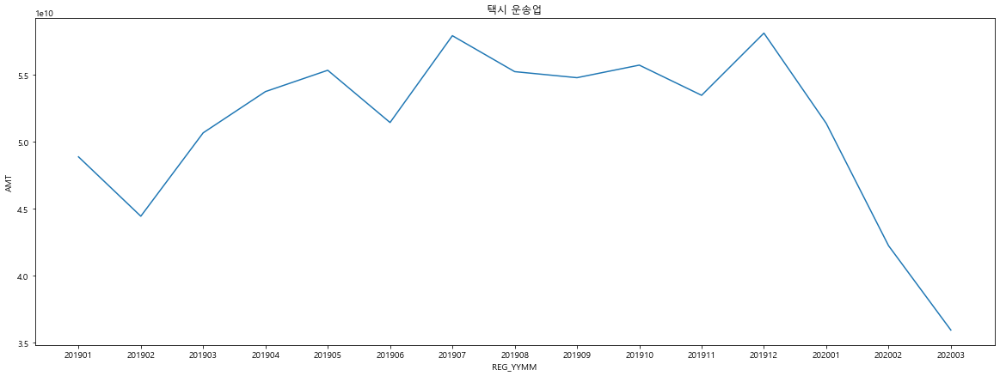

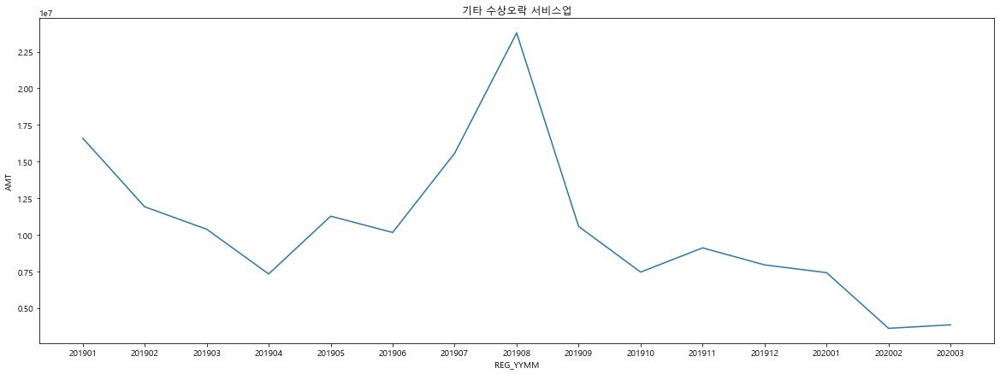

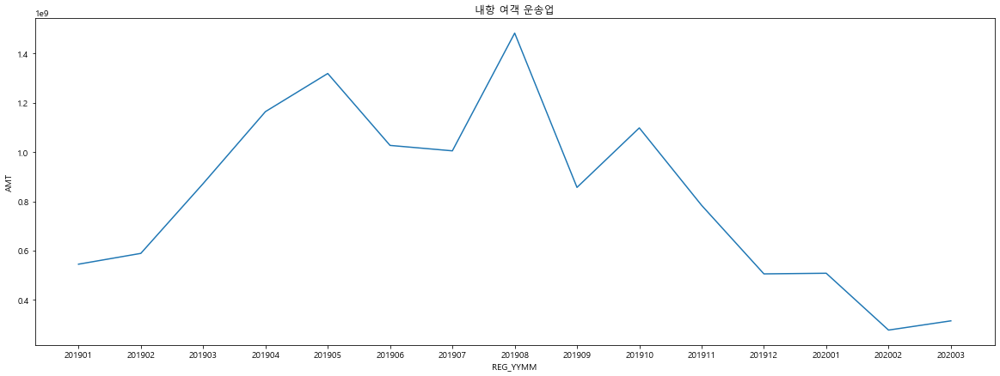

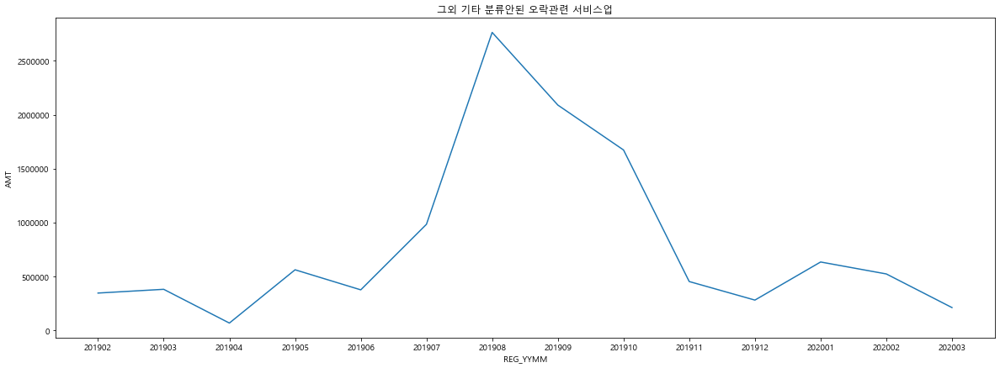

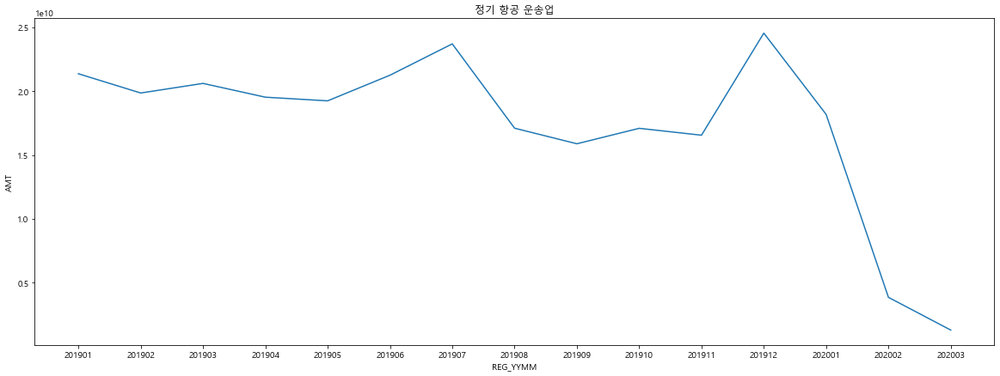

In [18]:
a = 0

for i in  CLSS_NM_uniq :
    q = train_clss_s.loc[i].loc[2]
    plt.figure(figsize = (20,7))
    sns.lineplot(data= q, x= q.index, y= 'AMT')
    plt.title(i)
    a+=1    

## 연령별 업종별 시계열 AMT. SUM추이

In [19]:

train_clss_a=train[["STD_CLSS_NM", "AGE", "REG_YYMM", "AMT"]].groupby(["STD_CLSS_NM", "AGE","REG_YYMM"]).sum()
train_clss_a

AMT
STD_CLSS_NM AGE REG_YYMM           
건강보조식품 소매업  10s 201901        31050
                201902        18100
                201903       625000
                201904       436300
                201905       361100
...                             ...
휴양콘도 운영업    70s 201911     59321540
                201912     61220540
                202001    149073630
                202002     19699030
                202003     12054285

[4182 rows x 1 columns]

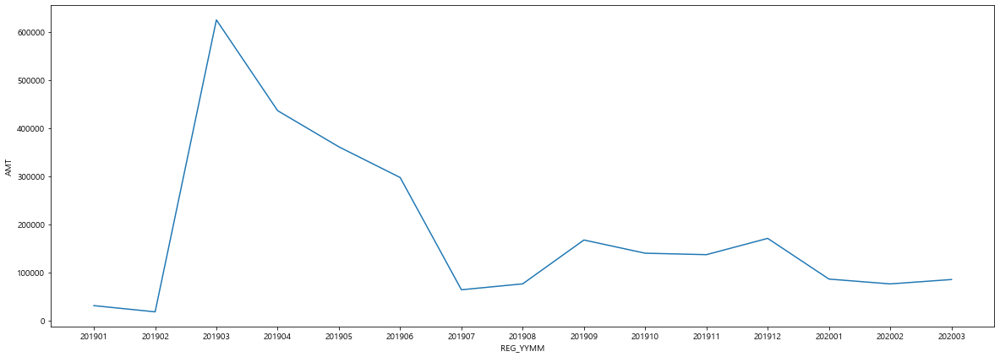

In [25]:
q = train_clss_a.loc["건강보조식품 소매업"].loc["10s"]
plt.figure(figsize = (20,7))
sns.lineplot(data= q, x= q.index, y= 'AMT')

C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figu

KeyError: '10s'

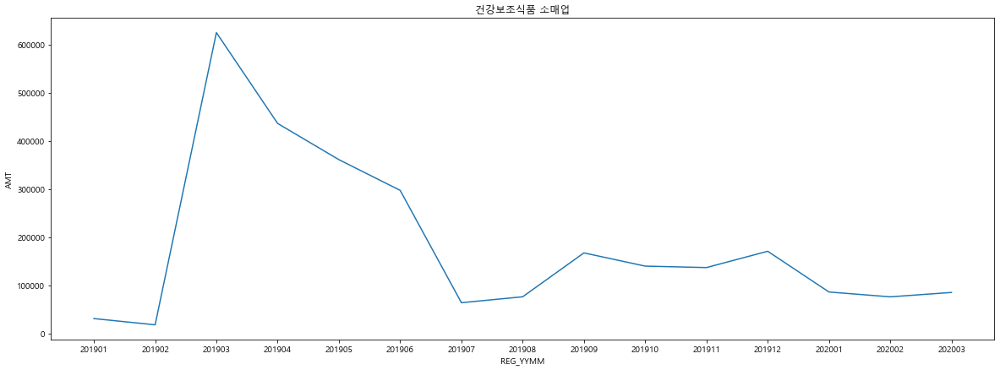

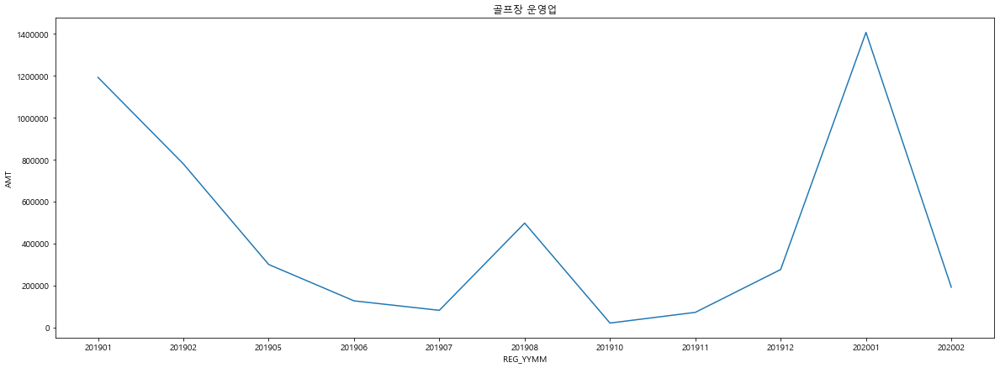

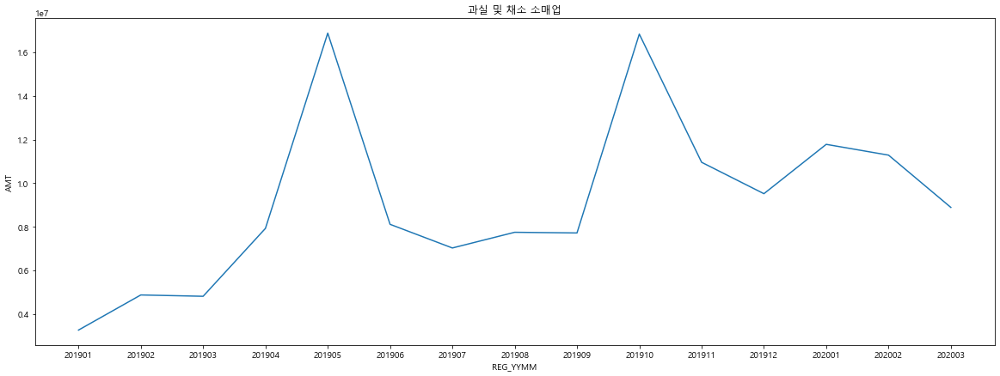

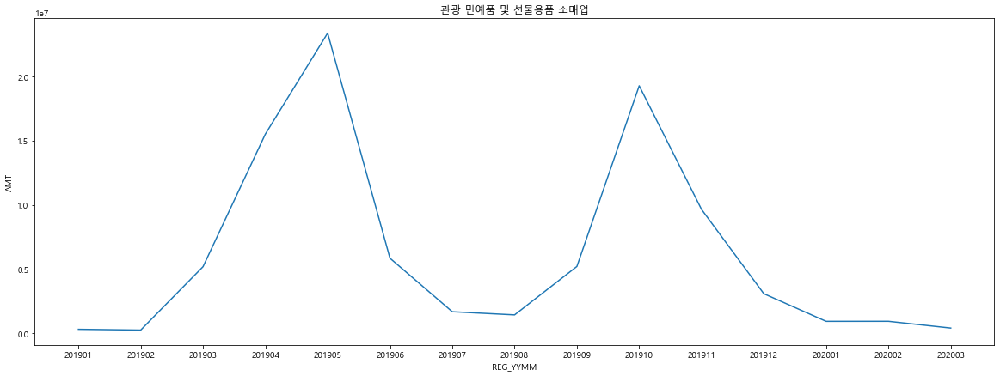

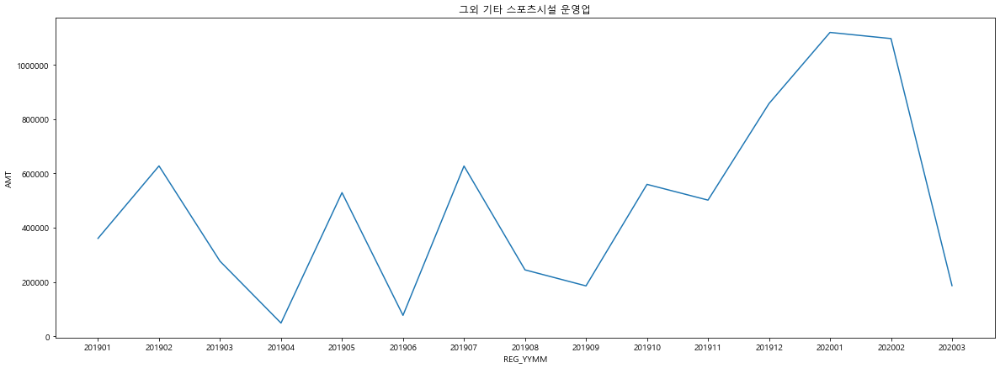

...

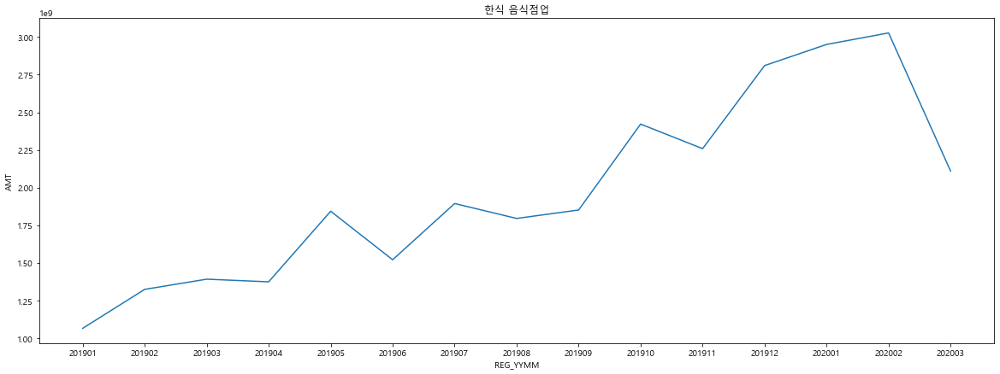

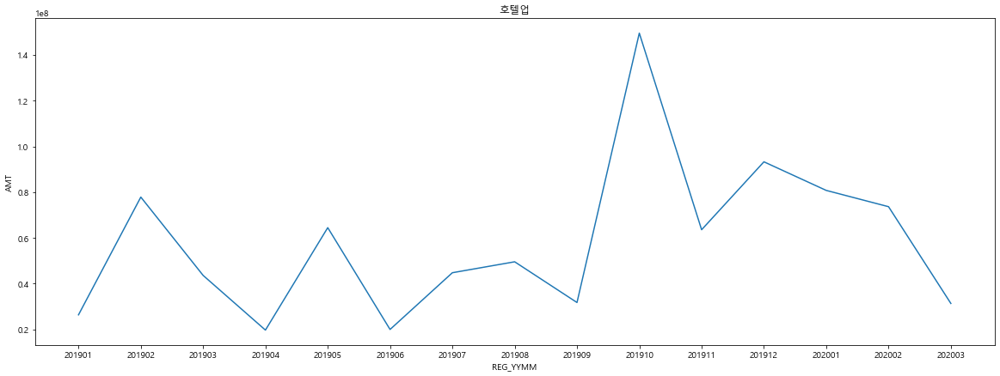

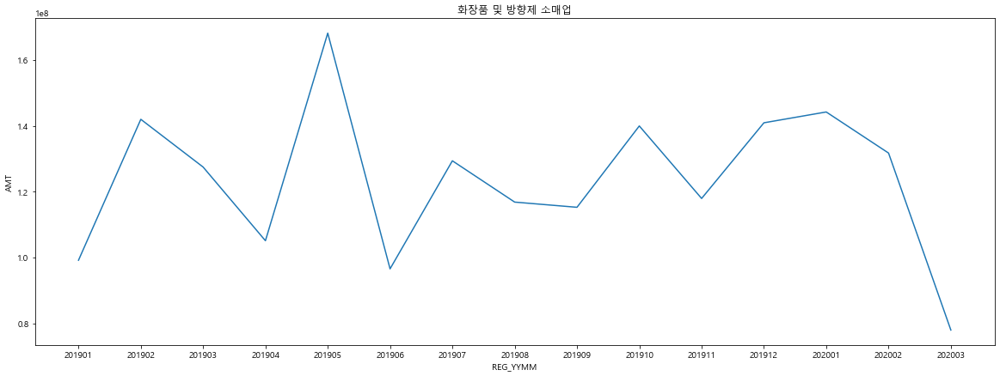

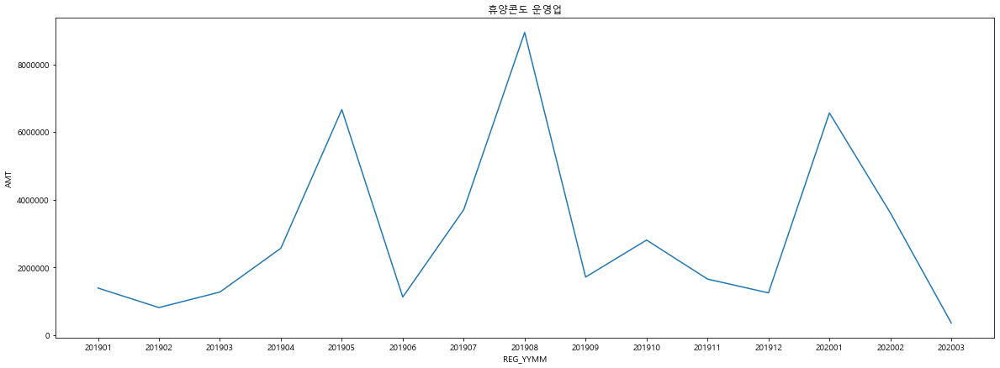

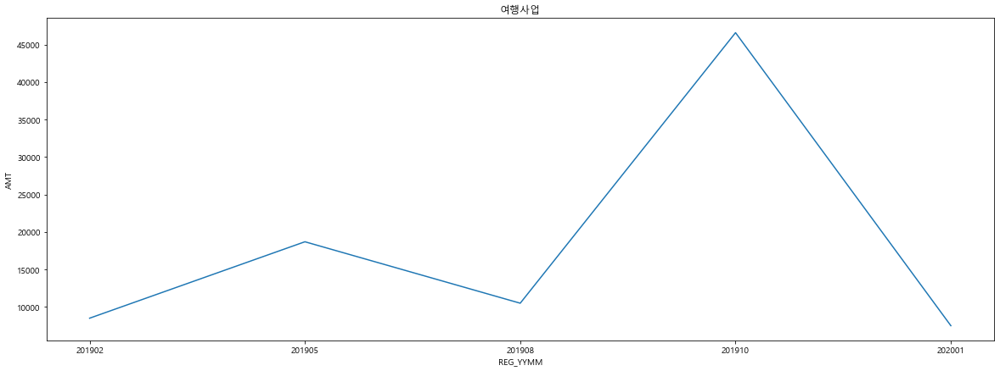

In [26]:
a = 0

for i in  CLSS_NM_uniq :
    q = train_clss_a.loc[i].loc["10s"]
    plt.figure(figsize = (20,7))
    sns.lineplot(data= q, x= q.index, y= 'AMT')
    plt.title(i)
    a+=1    

C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figu

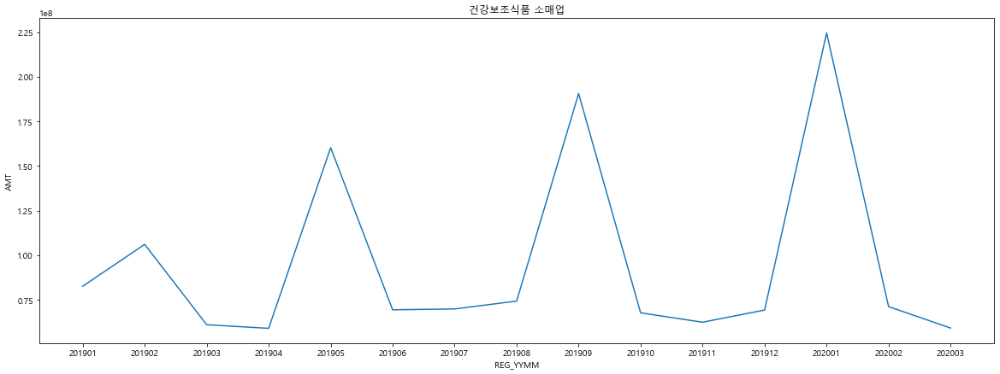

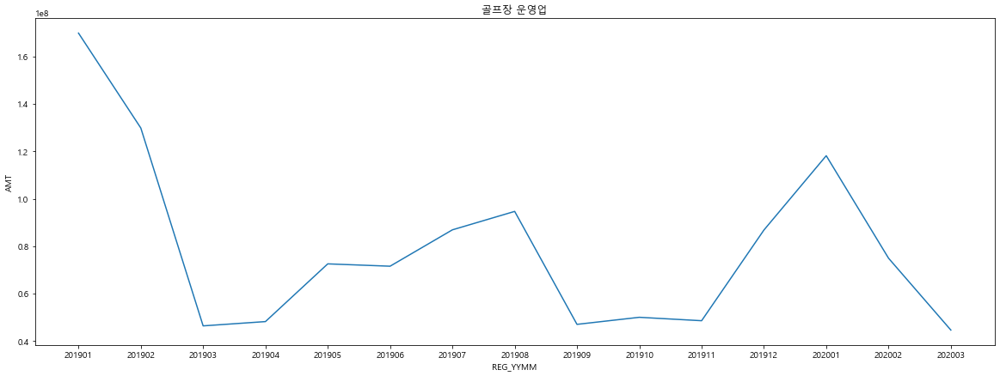

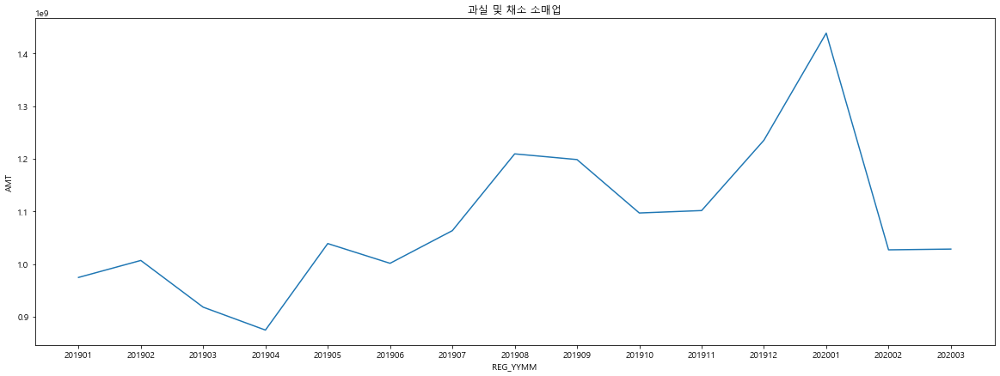

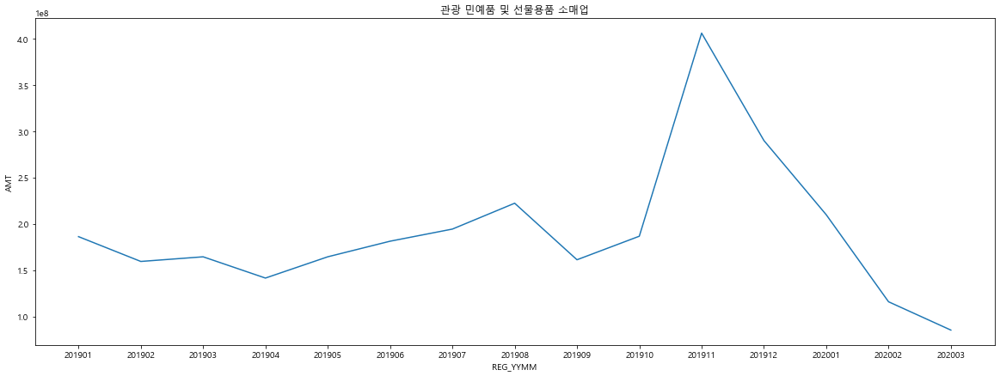

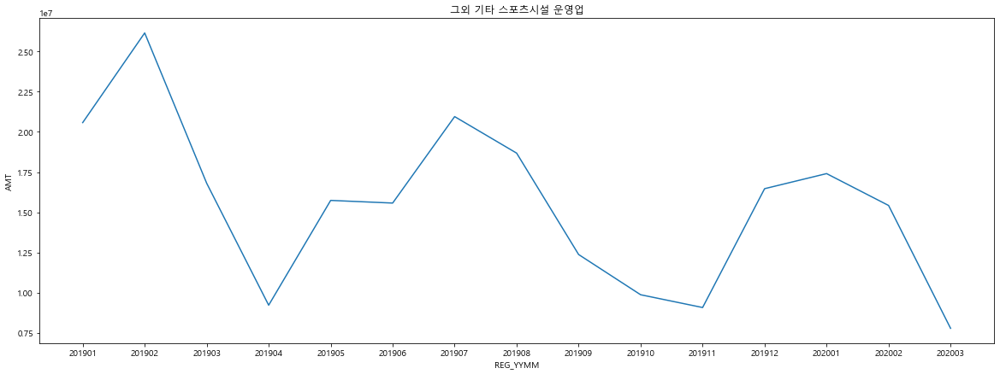

...

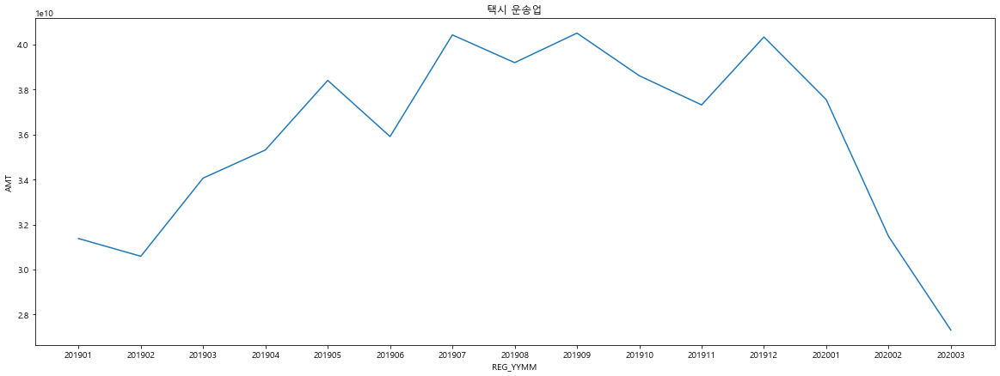

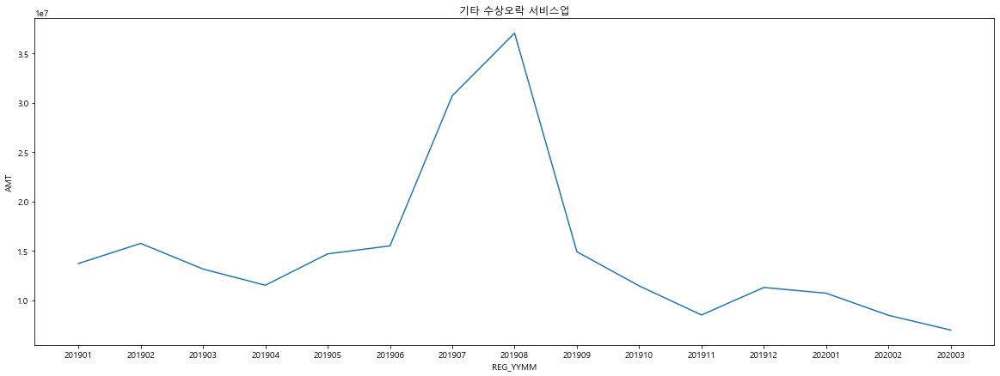

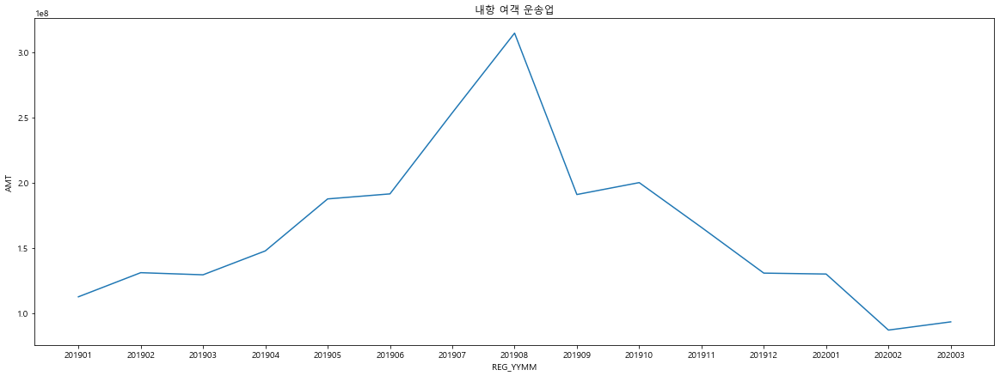

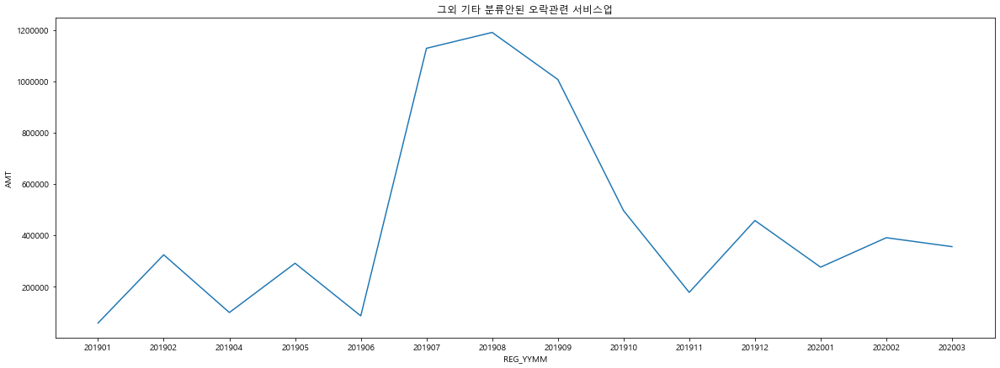

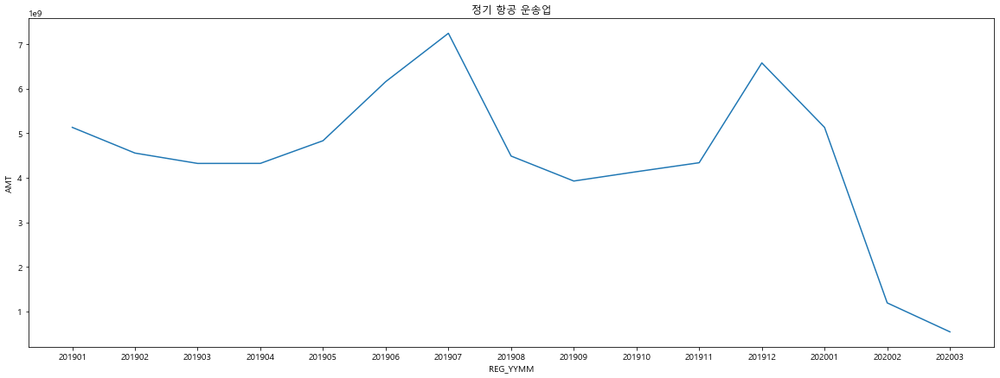

In [27]:
a = 0

for i in  CLSS_NM_uniq :
    q = train_clss_a.loc[i].loc["20s"]
    plt.figure(figsize = (20,7))
    sns.lineplot(data= q, x= q.index, y= 'AMT')
    plt.title(i)
    a+=1    

C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figu

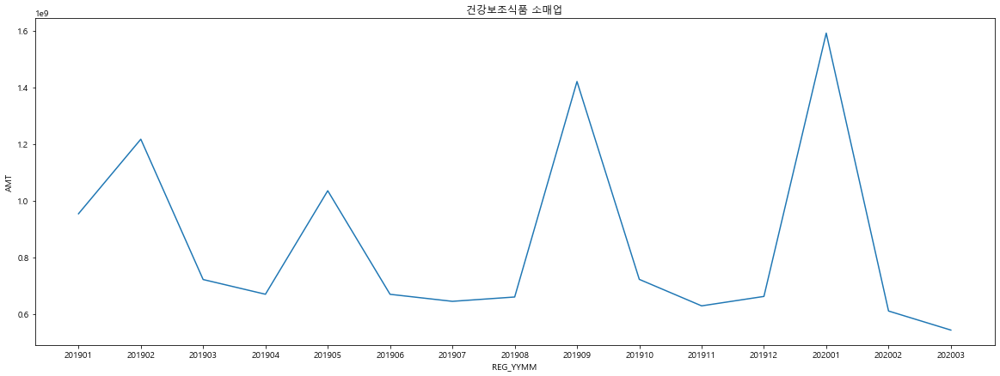

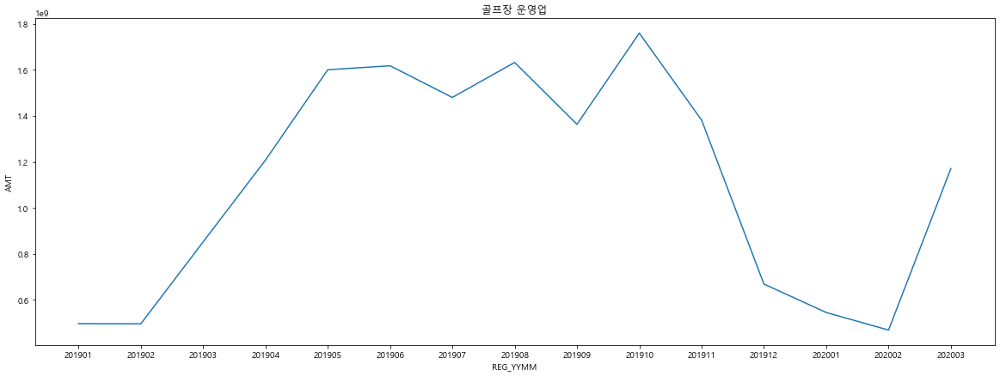

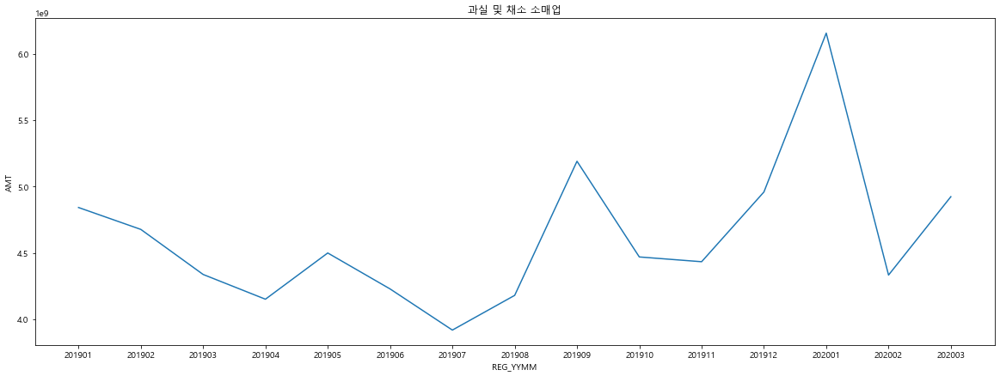

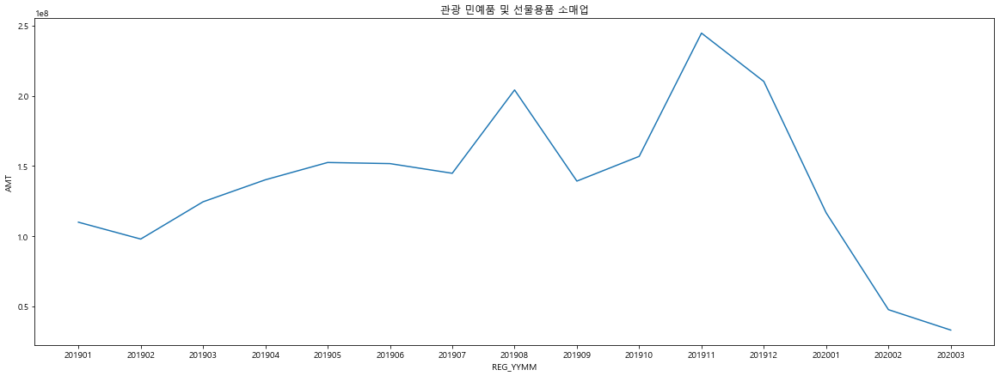

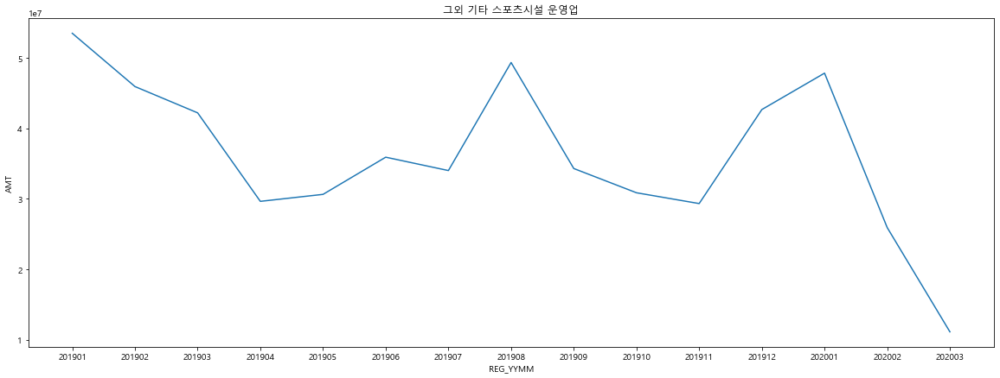

...

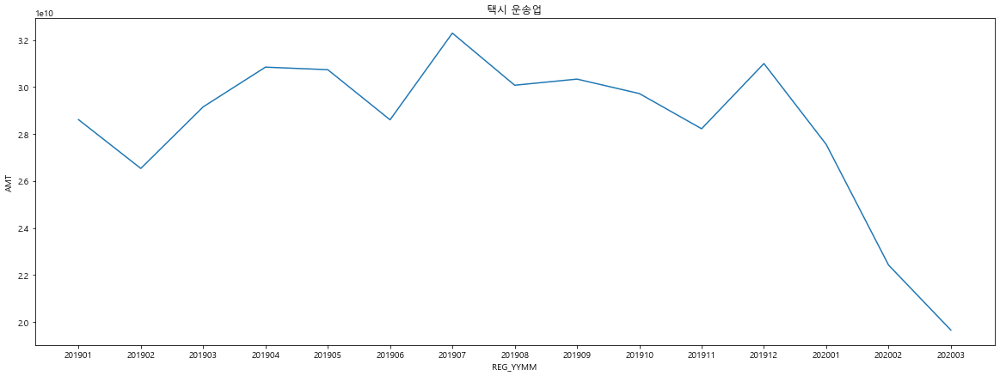

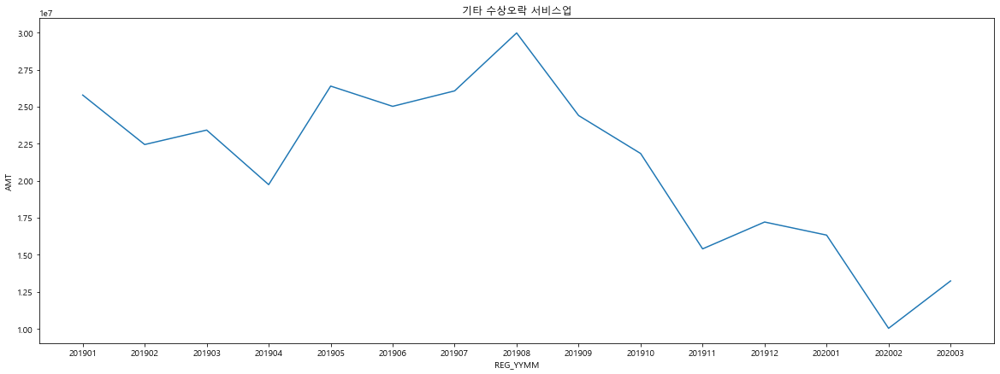

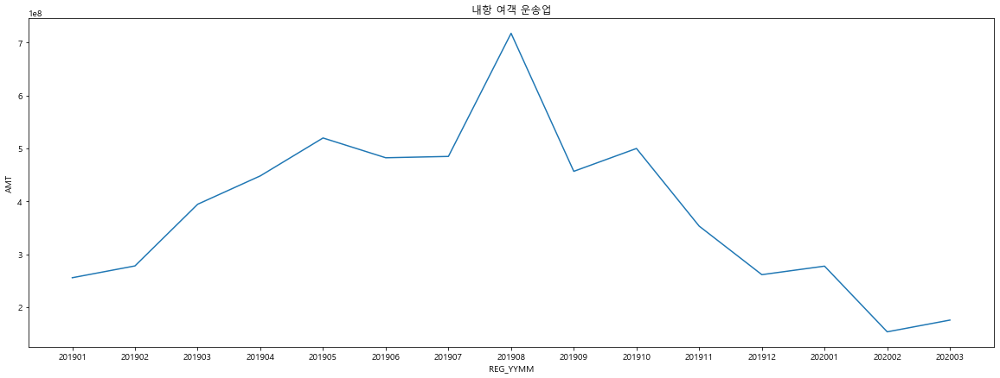

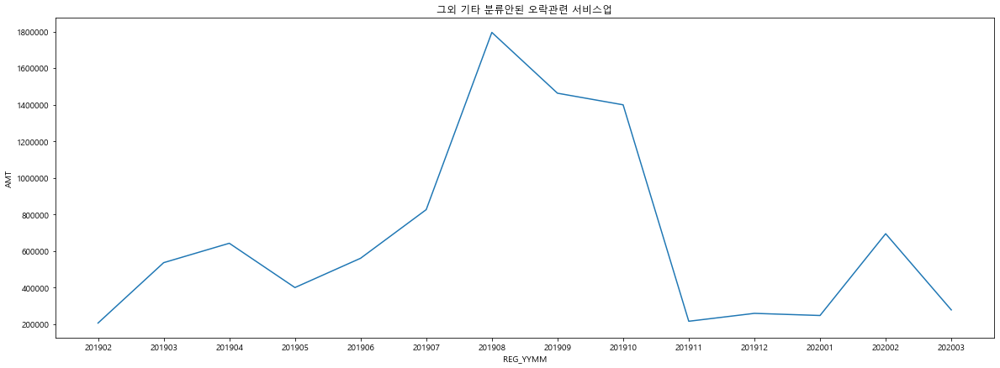

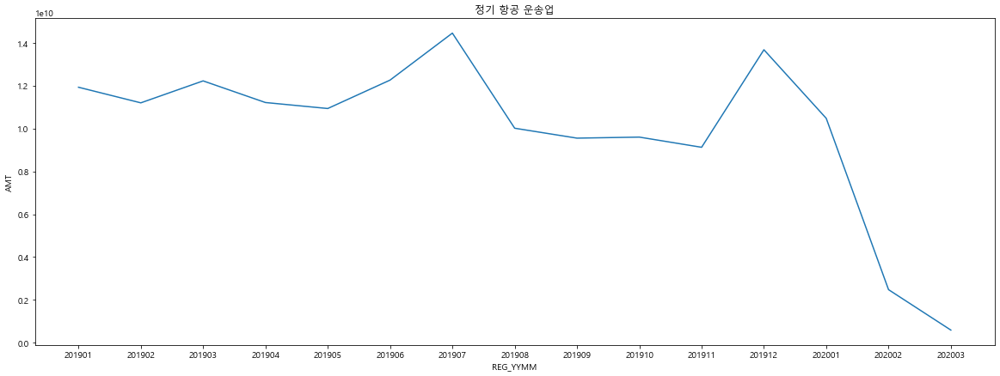

In [21]:
a = 0

for i in  CLSS_NM_uniq :
    q = train_clss_a.loc[i].loc["30s"]
    plt.figure(figsize = (20,7))
    sns.lineplot(data= q, x= q.index, y= 'AMT')
    plt.title(i)
    a+=1    

C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figu

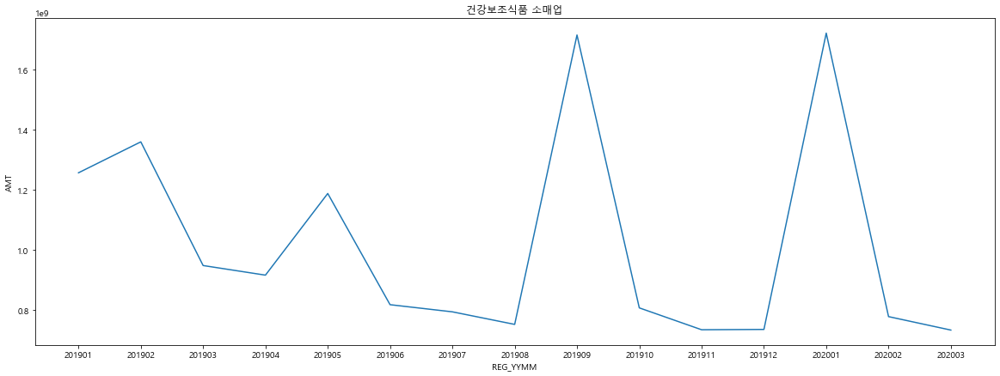

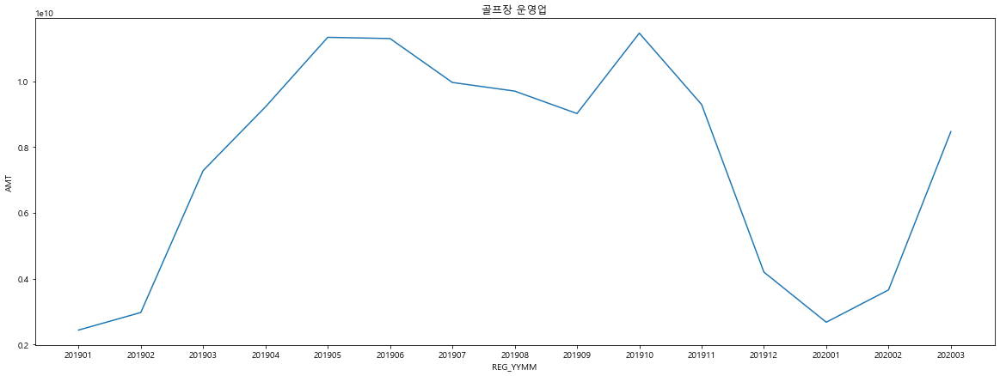

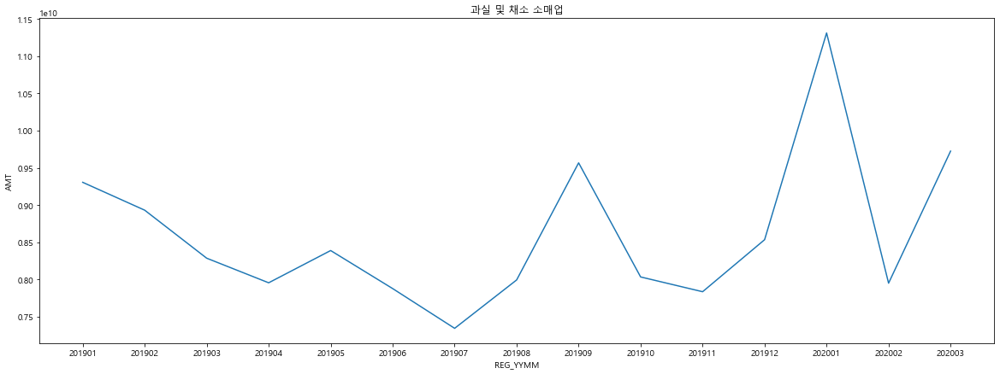

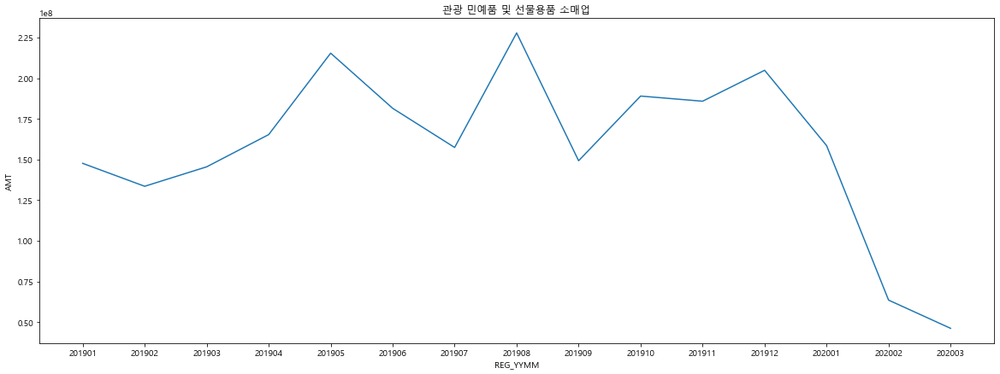

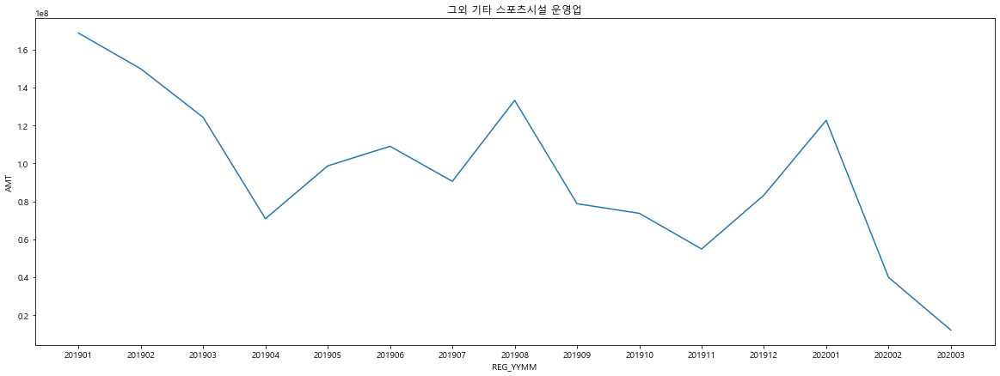

...

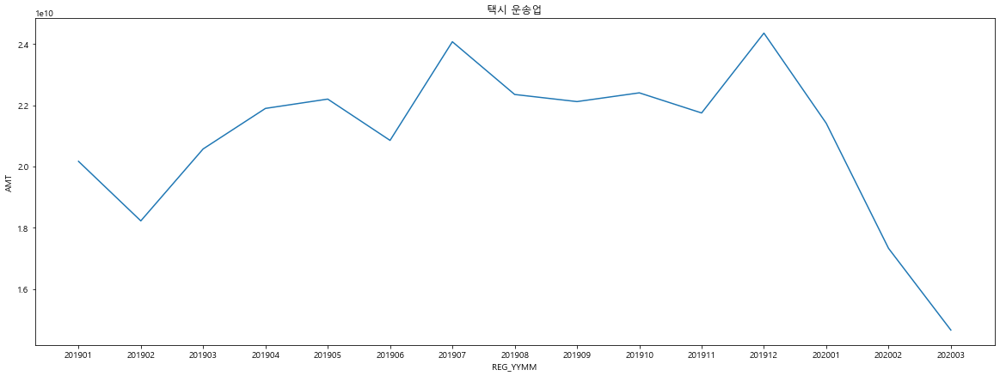

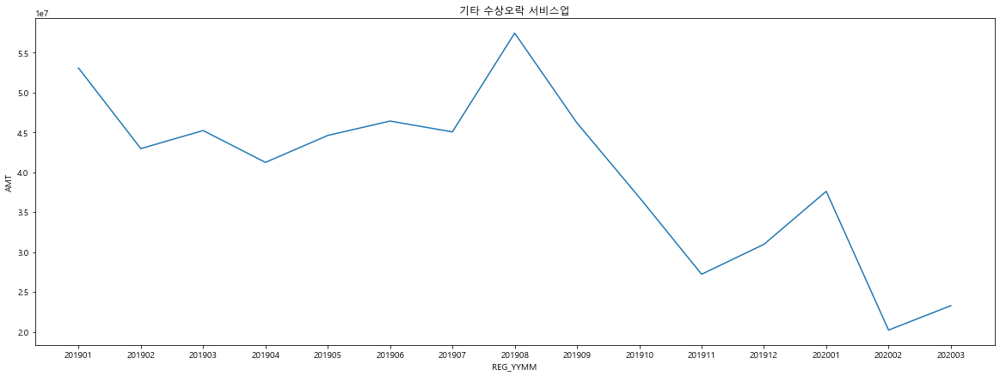

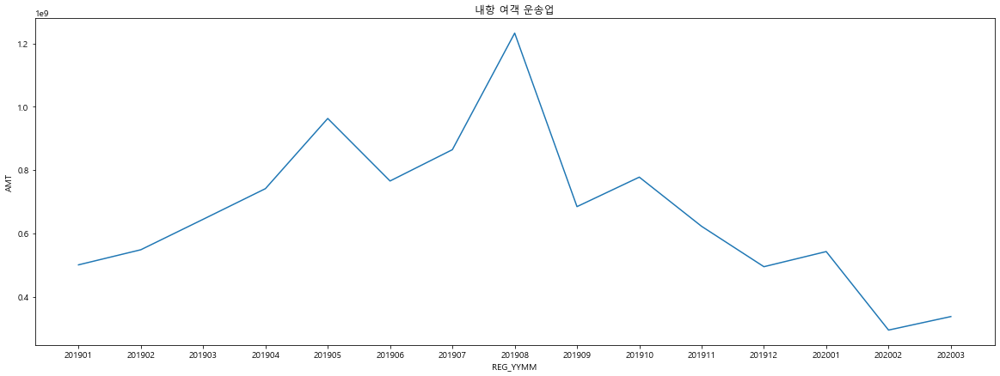

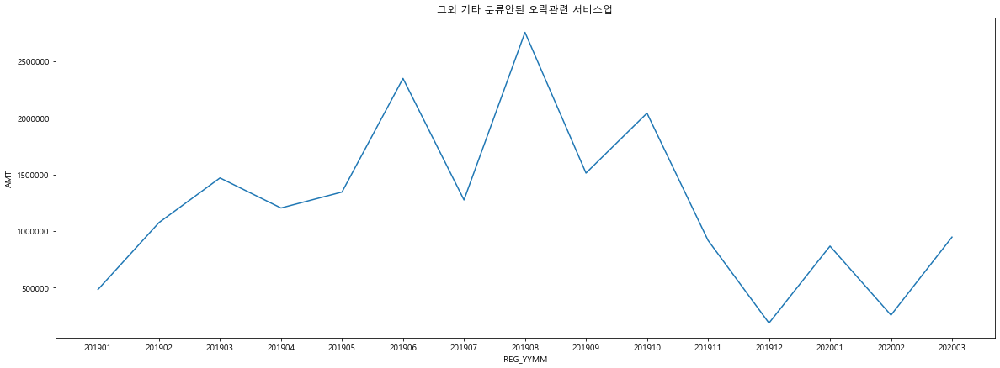

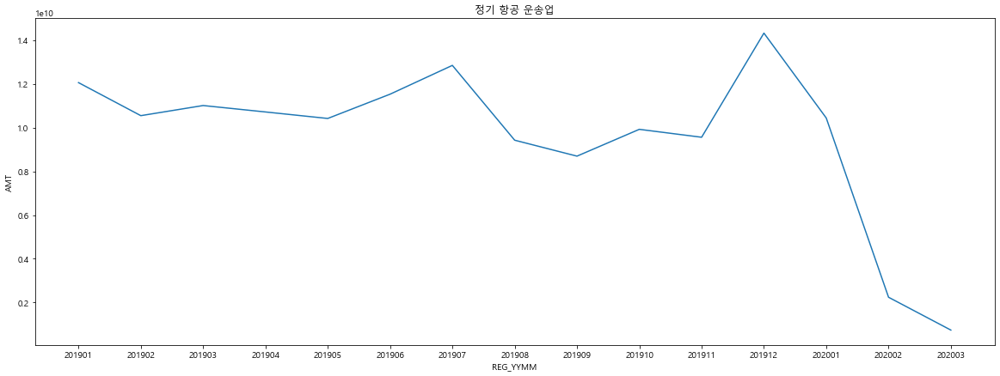

In [22]:
a = 0

for i in  CLSS_NM_uniq :
    q = train_clss_a.loc[i].loc["40s"]
    plt.figure(figsize = (20,7))
    sns.lineplot(data= q, x= q.index, y= 'AMT')
    plt.title(i)
    a+=1    

C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figu

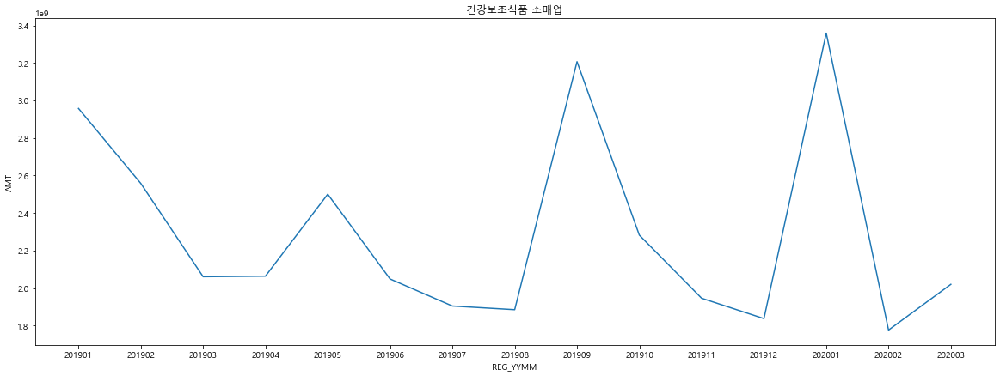

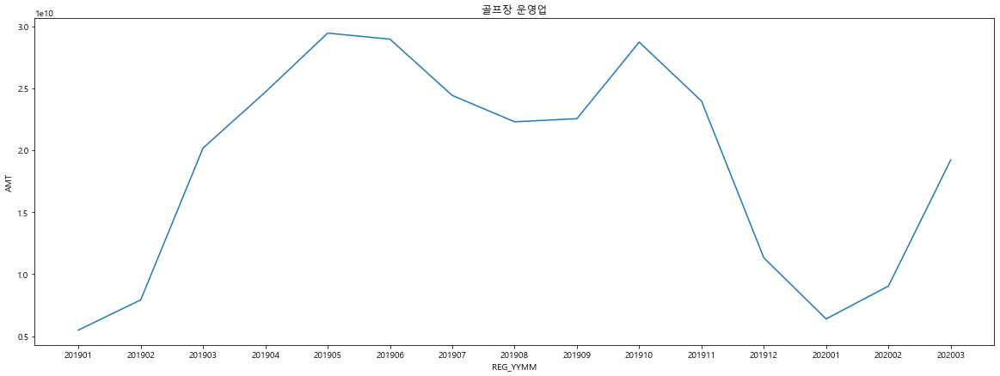

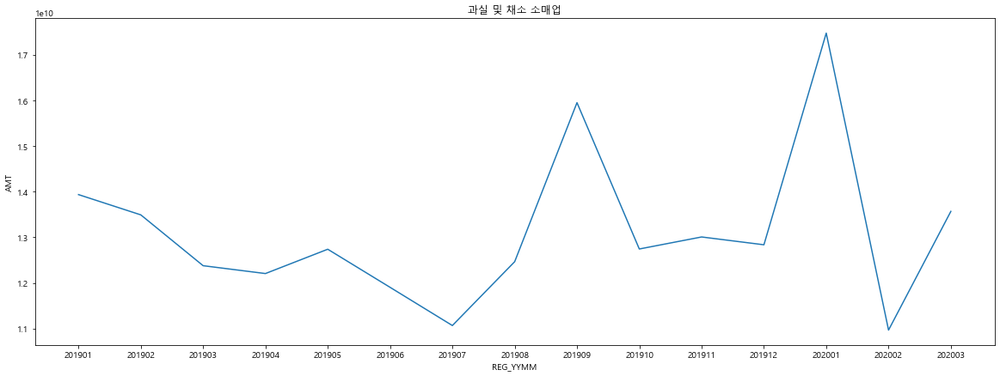

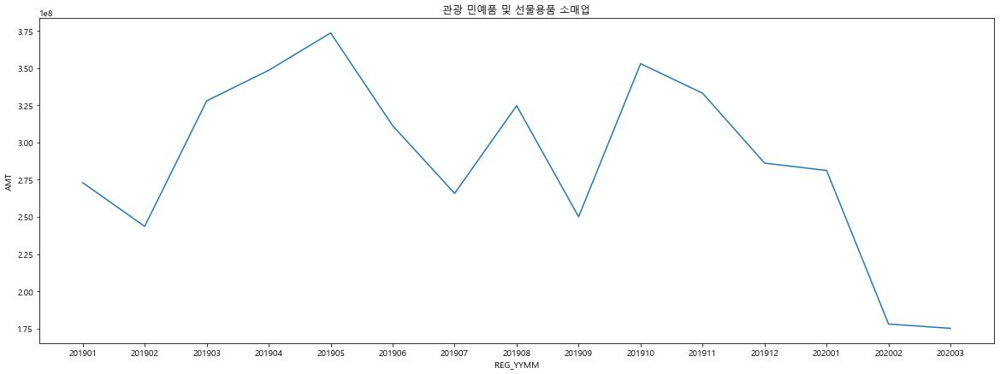

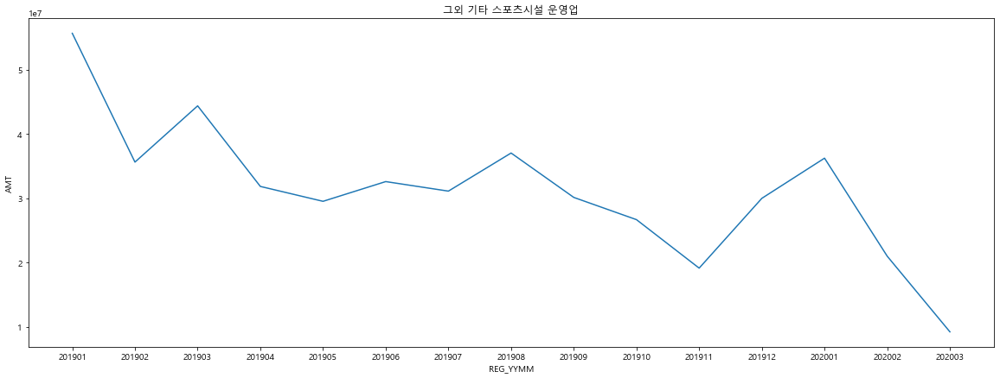

...

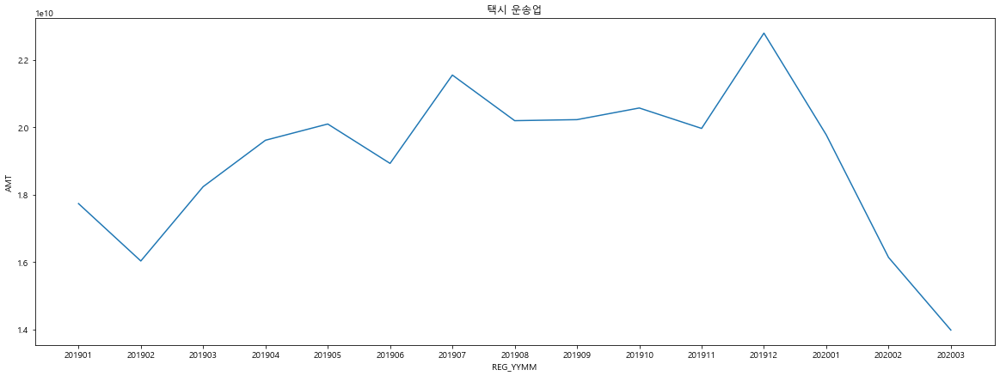

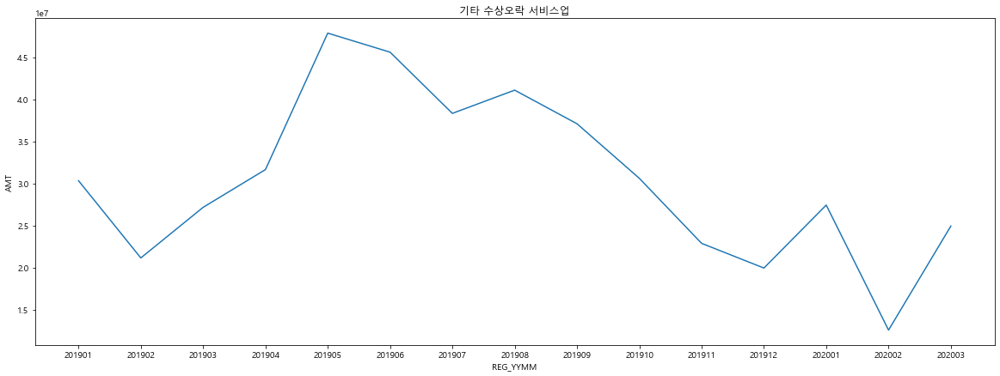

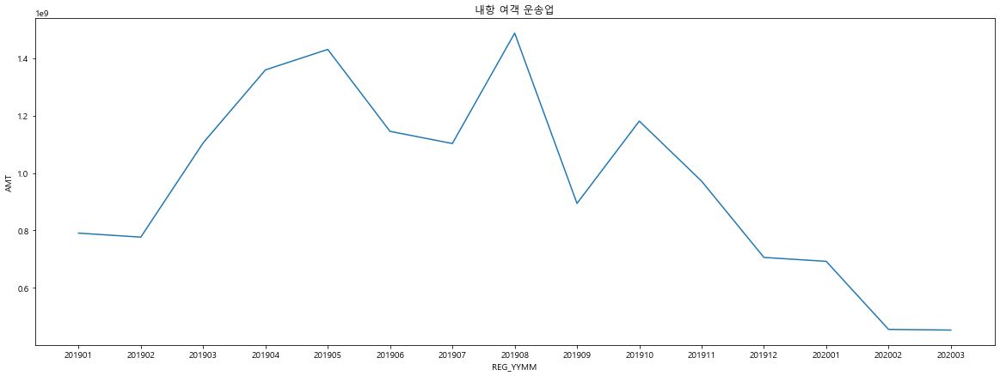

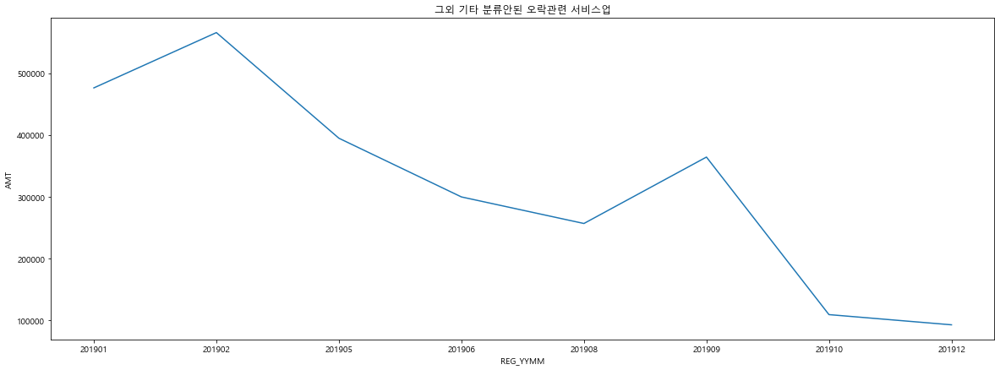

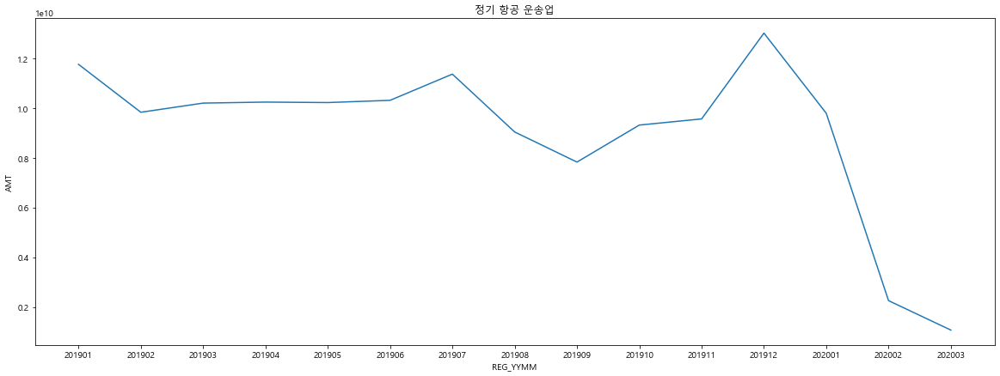

In [23]:
a = 0

for i in  CLSS_NM_uniq :
    q = train_clss_a.loc[i].loc["50s"]
    plt.figure(figsize = (20,7))
    sns.lineplot(data= q, x= q.index, y= 'AMT')
    plt.title(i)
    a+=1    

C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figu

KeyError: '60s'

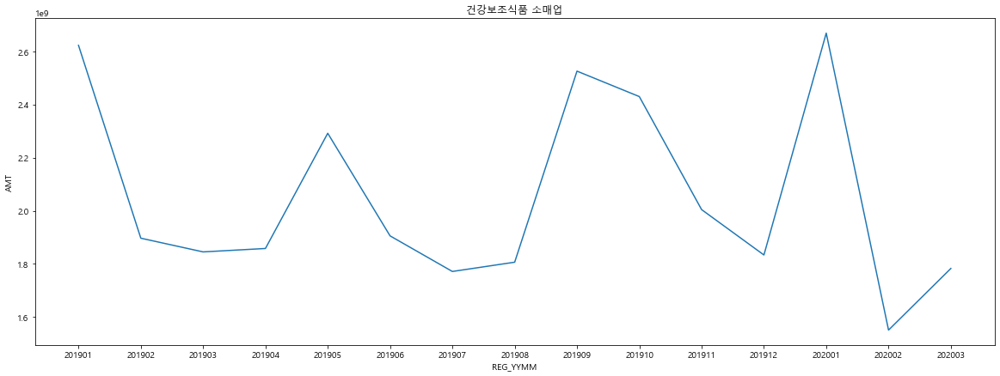

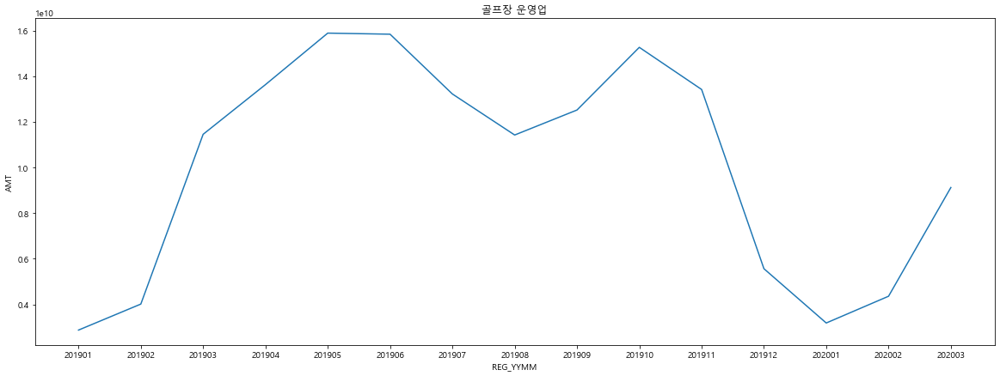

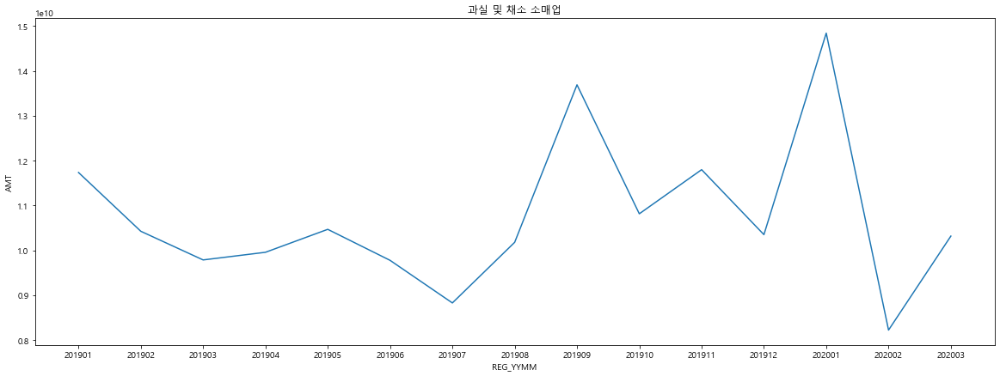

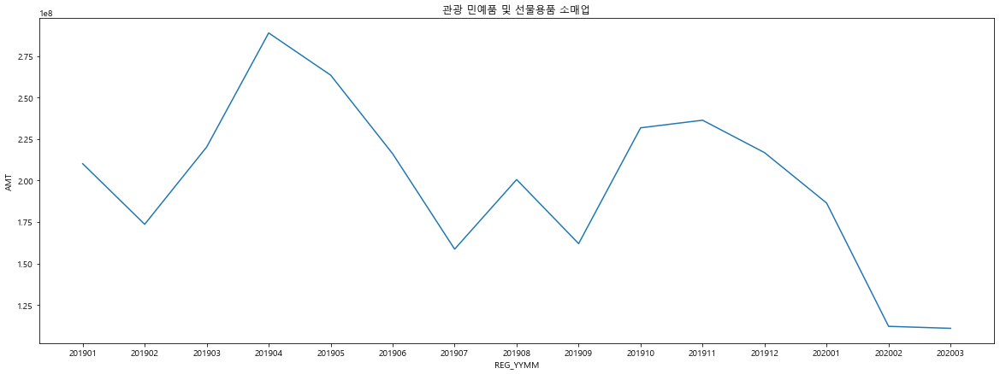

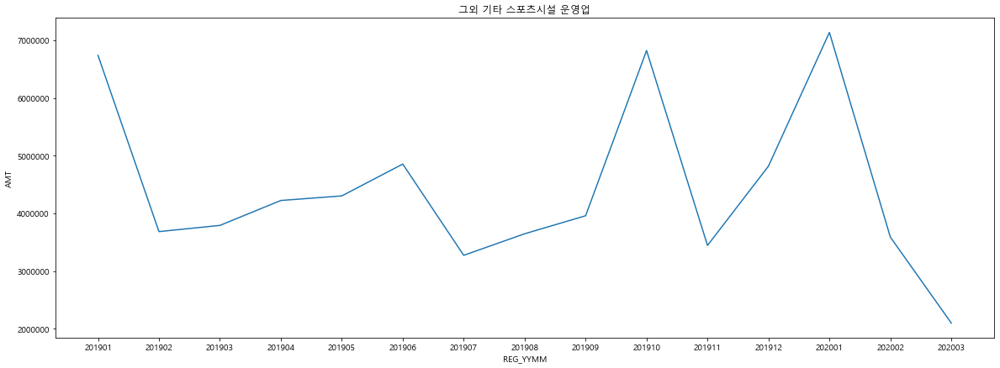

...

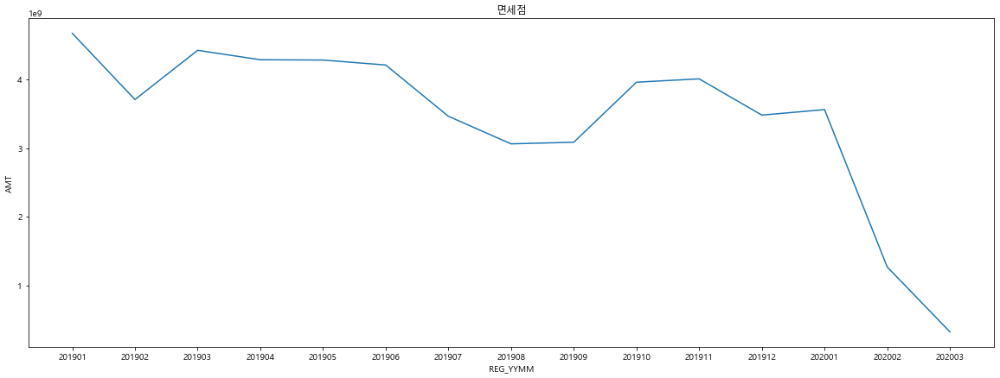

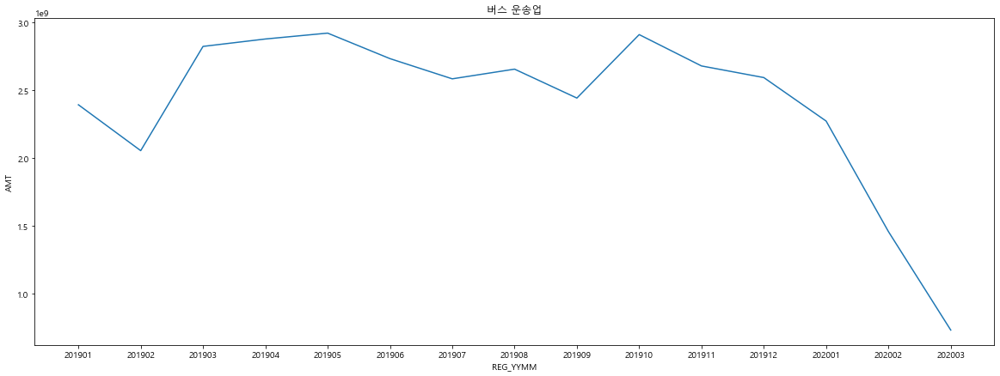

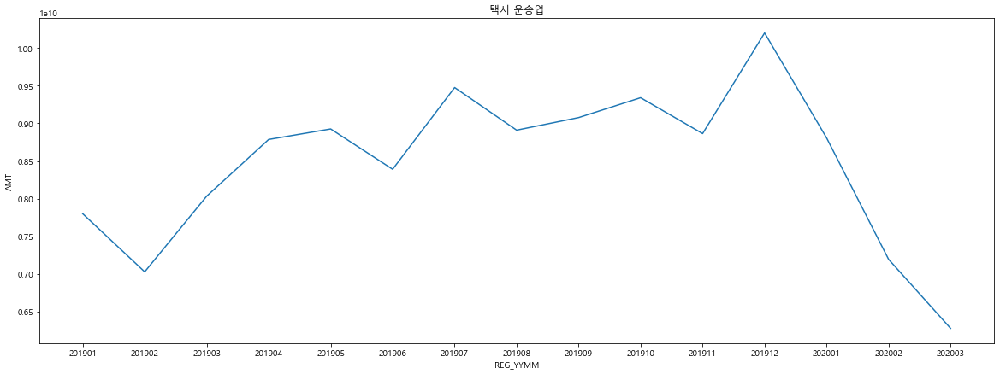

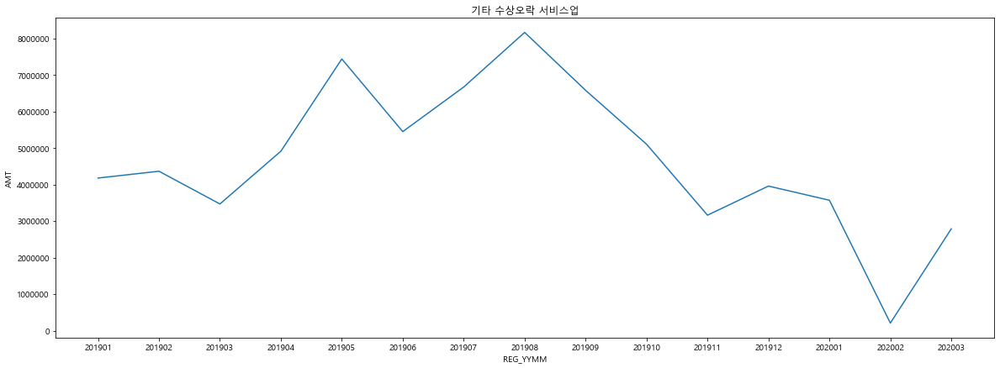

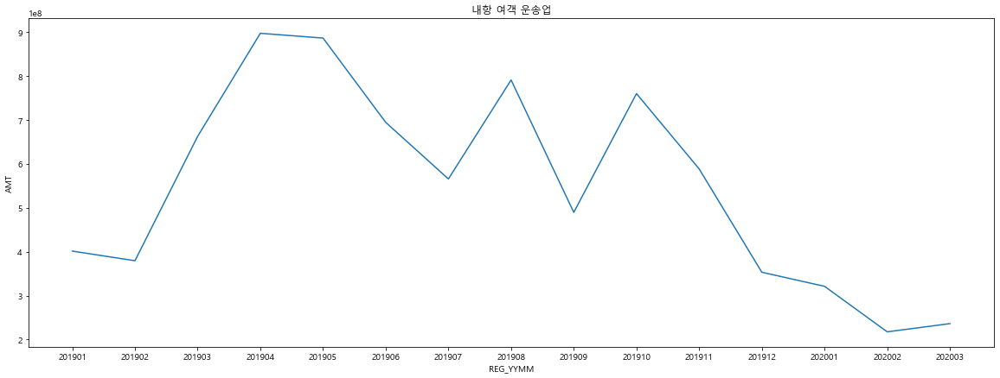

In [24]:
a = 0

for i in  CLSS_NM_uniq :
    q = train_clss_a.loc[i].loc["60s"]
    plt.figure(figsize = (20,7))
    sns.lineplot(data= q, x= q.index, y= 'AMT')
    plt.title(i)
    a+=1    

C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """
C:\Users\noeul\anaconda3\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figu

KeyError: '70s'

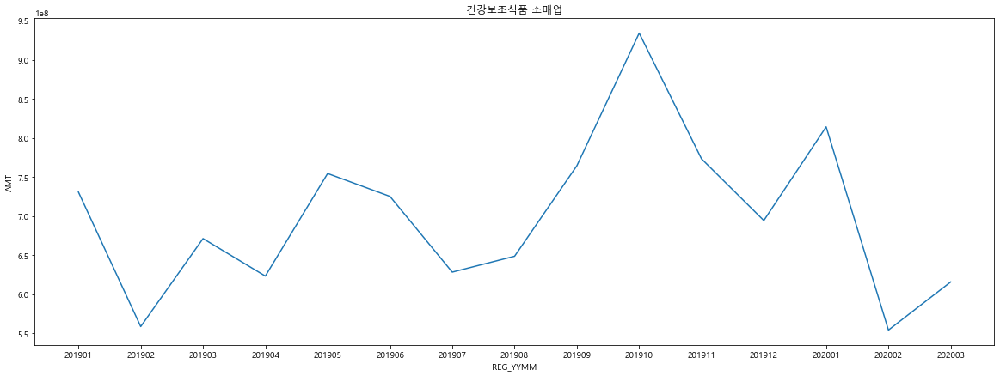

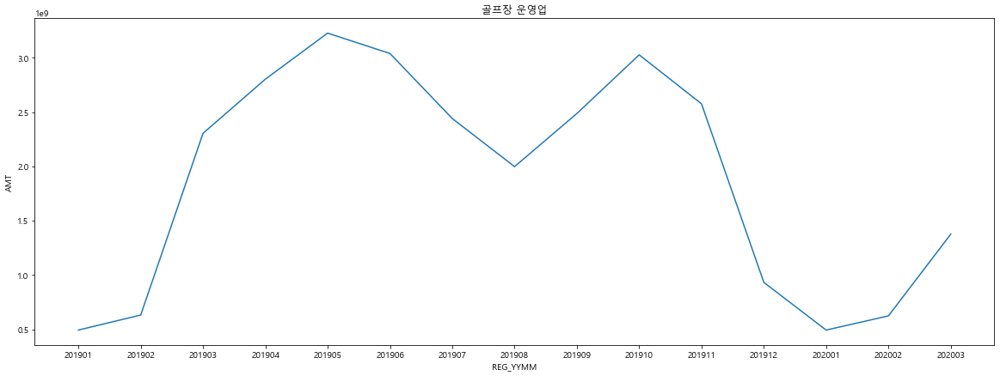

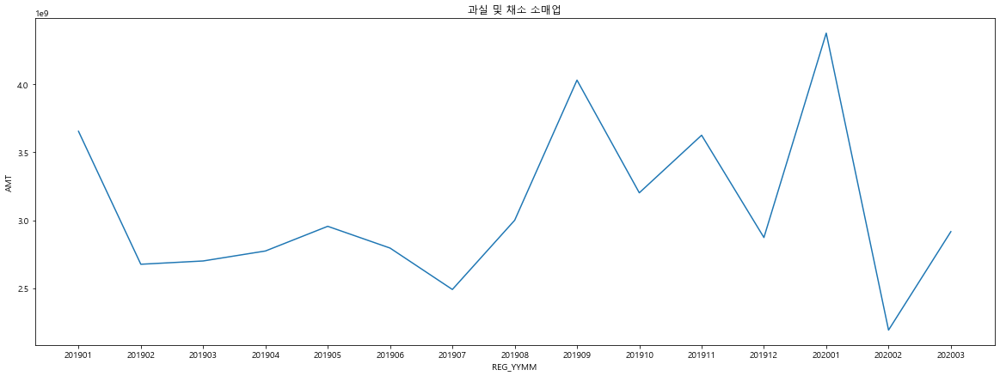

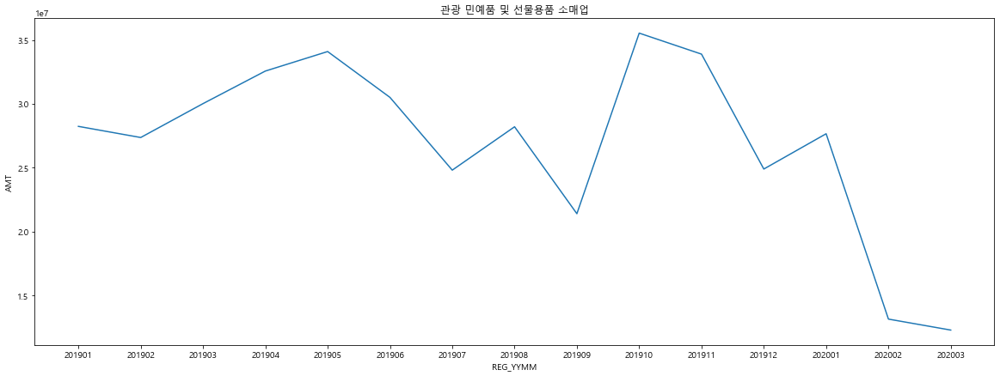

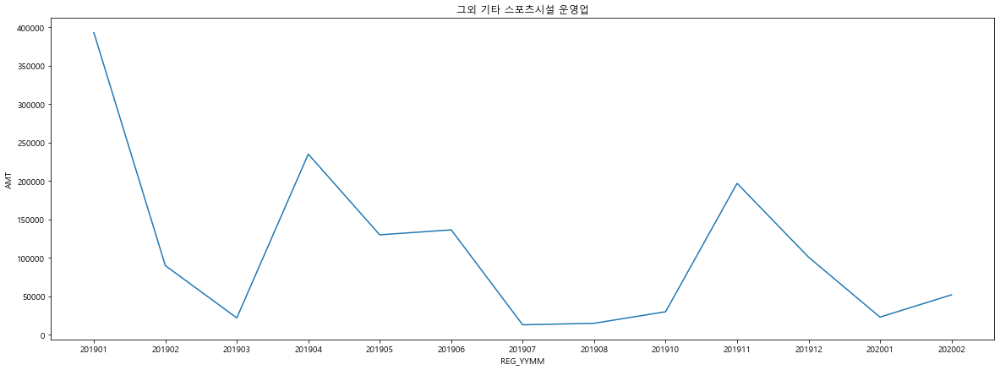

...

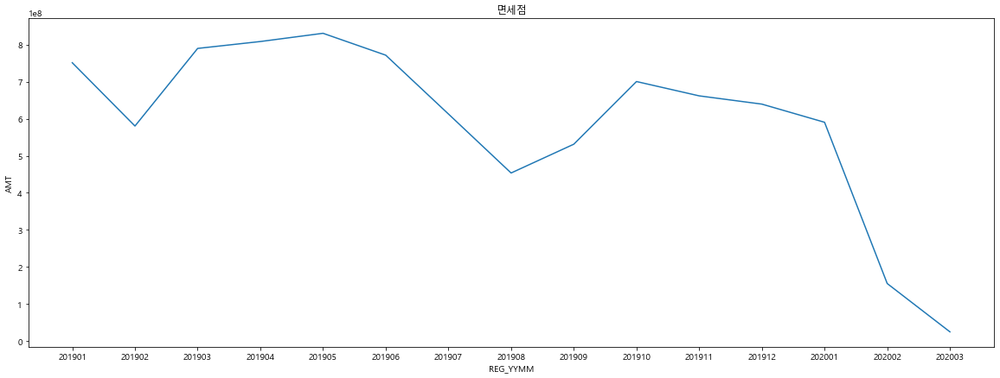

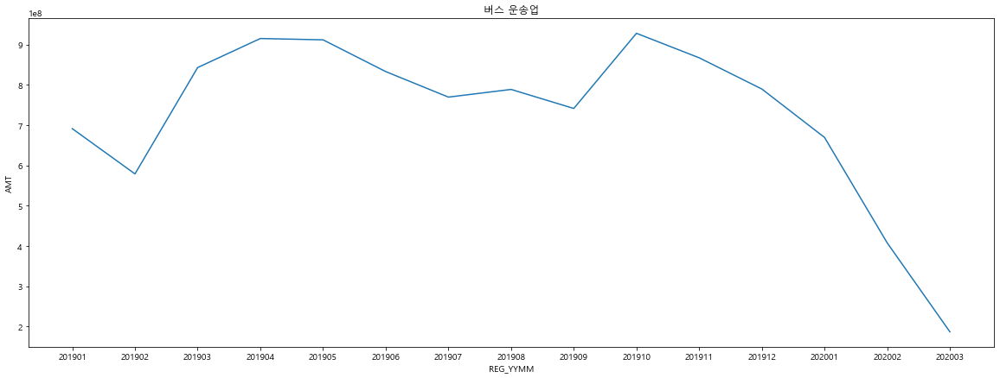

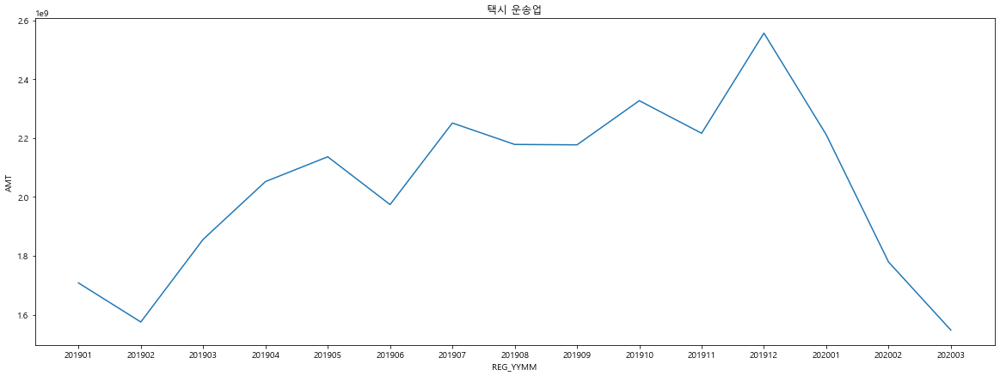

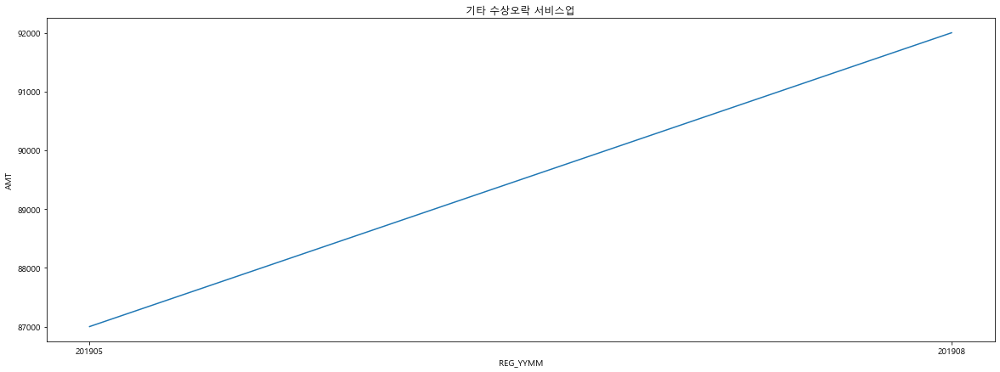

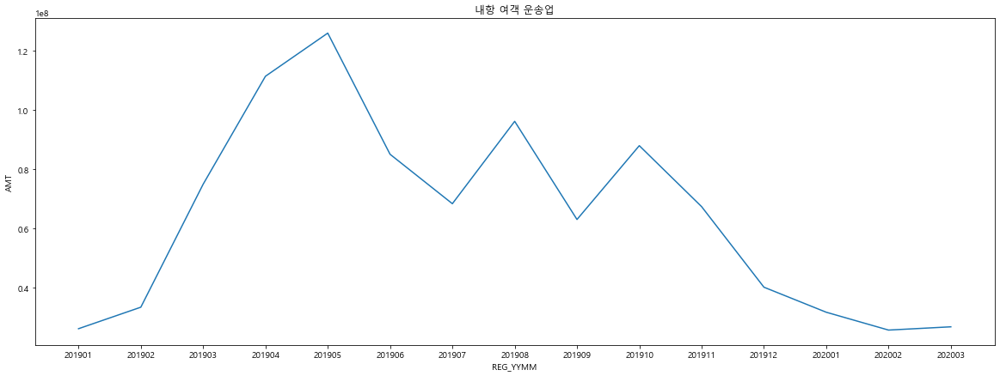

In [28]:
a = 0

for i in  CLSS_NM_uniq :
    q = train_clss_a.loc[i].loc["70s"]
    plt.figure(figsize = (20,7))
    sns.lineplot(data= q, x= q.index, y= 'AMT')
    plt.title(i)
    a+=1    

##  업종별 사용자 AMT. SUM시계열 추이

In [43]:

train_clss_user=train[["STD_CLSS_NM", "user", "REG_YYMM", "AMT"]].groupby(["STD_CLSS_NM", "user","REG_YYMM"]).sum()
train_clss_user


AMT
STD_CLSS_NM user REG_YYMM          
건강보조식품 소매업  10s1 201901       12450
                 201903      489450
                 201904      383000
                 201905      290350
                 201906      244950
...                             ...
휴양콘도 운영업    70s2 201911    17936170
                 201912    20015530
                 202001    20029180
                 202002     5406400
                 202003     2635300

[8262 rows x 1 columns]

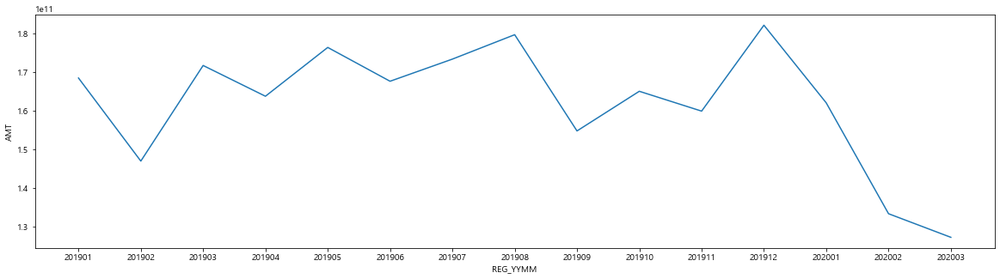

In [30]:
# 필요한 애들만 변수 바꿔서 확인하기

p = train_clss_user.loc["한식 음식점업"].loc["50s1"]
plt.rcParams['figure.figsize'] = [20, 5] # [width, height] (inches)

sns.lineplot(data=p , x=p.index , y="AMT" )

### 박동민

In [49]:
# df_g=df.loc["강원"]
# df_g=  df_g.reset_index()

In [50]:
# df_g["STD_CLSS_NM"].unique()

In [51]:
# df2 = df1.reset_index()
# # df2 = df1['REG_YYMM'].values()
# df2

In [52]:
# df3 = df2["REG_YYMM"].values
# df3

In [53]:
# len(df3)

In [54]:
# list1 = df1["AMT"].values
# list1

In [55]:
# list1[0]
# list1[1]
# list1[2]

# list1[12]
# list1[13]
# list1[14]

In [56]:
# # 1,2,3 월 전체 변화


# a = ((200612662 +176459558+179229457) / (197458766 + 175758111 + 209598246)) * 100
# print("1,2,3월 변화량 : ",a)

# # 1월 변화량
# b = ( ( 200612662-197458766)/ 197458766  )*100
# print("1월 변화량 : ",b)

# # 1월 변화량
# b = ( 176459558/ 175758111) *100
# print("2월 변화량 : ",b)
# # 1월 변화량
# c = ( 179229457/ 209598246) *100
# print("3월 변화량 : ",c)

In [57]:
# a=[]
# for i in SIDO_NM_uniq :
#     dfg=train.loc[train["CARD_SIDO_NM"]==i]
#     STD_CLSS_NM_uniq = dfg['STD_CLSS_NM'].unique()
#     a.append(STD_CLSS_NM_uniq) 
    
#     for k in range(len(a)):
#         for j in a[k]:
#             print(i)
#             df1 = df.loc[SIDO_NM_uniq[k]].loc[j]
#             df2 = df.loc[SIDO_NM_uniq[k]].loc[j]
#             df2 = df2.reset_index()
#             df3 = df2['REG_YYMM'].values
#             list1 = df1["AMT"].values
#             if len(df3) == 15:
#                 v1 = ((list1[12]+list1[13]+list1[14])-(list1[0]+list1[1]+list1[2]))/(list1[0]+list1[1]+list1[2]) * 100
#                 print(j, "1,2,3월 변화량 : ",v1)

In [58]:
# a=[]
# for i in SIDO_NM_uniq :
#     dfg=train.loc[train["CARD_SIDO_NM"]==i]
#     STD_CLSS_NM_uniq = dfg['STD_CLSS_NM'].unique()
#     a.append(STD_CLSS_NM_uniq)   
# a    

In [60]:
#len(a)

In [5]:
t_a = train[["AGE","STD_CLSS_NM","AMT"]].groupby(["AGE","STD_CLSS_NM"]).sum()
t_a

AMT
AGE STD_CLSS_NM                        
10s 건강보조식품 소매업                  2772250
    골프장 운영업                     4949200
    과실 및 채소 소매업               137605354
    관광 민예품 및 선물용품 소매업          93268215
    그외 기타 분류안된 오락관련 서비스업         143500
...                                 ...
70s 피자 햄버거 샌드위치 및 유사 음식점업    8698003885
    한식 음식점업                433206158407
    호텔업                     12619524494
    화장품 및 방향제 소매업           27639914964
    휴양콘도 운영업                 1140058833

[284 rows x 1 columns]

In [11]:
t_a.loc["10s"].sort_values(by="AMT",ascending=False)

,AMT
STD_CLSS_NM,
체인화 편의점,41699855755
한식 음식점업,29647144459
피자 햄버거 샌드위치 및 유사 음식점업,13408177177
비알콜 음료점업,12404421733
택시 운송업,11346429424
슈퍼마켓,11030535401
기타 대형 종합 소매업,9825848745
서양식 음식점업,9068353709
빵 및 과자류 소매업,3452522395


In [25]:
t_a10 = t_a.loc["10s"].reset_index()
len(t_a10["STD_CLSS_NM"])

40

In [37]:
CLSS_NM_uniq

array(['건강보조식품 소매업', '골프장 운영업', '과실 및 채소 소매업', '관광 민예품 및 선물용품 소매업',
       '그외 기타 스포츠시설 운영업', '그외 기타 종합 소매업', '기타 대형 종합 소매업', '기타 외국식 음식점업',
       '기타 주점업', '기타음식료품위주종합소매업', '마사지업', '비알콜 음료점업', '빵 및 과자류 소매업',
       '서양식 음식점업', '수산물 소매업', '슈퍼마켓', '스포츠 및 레크레이션 용품 임대업', '여관업', '욕탕업',
       '육류 소매업', '일반유흥 주점업', '일식 음식점업', '전시 및 행사 대행업', '중식 음식점업',
       '차량용 가스 충전업', '차량용 주유소 운영업', '체인화 편의점', '피자 햄버거 샌드위치 및 유사 음식점업',
       '한식 음식점업', '호텔업', '화장품 및 방향제 소매업', '휴양콘도 운영업', '여행사업', '자동차 임대업',
       '면세점', '버스 운송업', '택시 운송업', '기타 수상오락 서비스업', '내항 여객 운송업',
       '그외 기타 분류안된 오락관련 서비스업', '정기 항공 운송업'], dtype=object)

In [40]:
set(CLSS_NM_uniq)-set(t_a10["STD_CLSS_NM"])

{'자동차 임대업'}

In [26]:
t_a20 = t_a.loc["20s"].reset_index()
len(t_a20["STD_CLSS_NM"])

41

In [27]:
t_a30 = t_a.loc["30s"].reset_index()
len(t_a30["STD_CLSS_NM"])

41

In [28]:
t_a40 = t_a.loc["40s"].reset_index()
len(t_a40["STD_CLSS_NM"])

41

In [29]:
t_a50 = t_a.loc["50s"].reset_index()
len(t_a50["STD_CLSS_NM"])

41

In [30]:
t_a60 = t_a.loc["60s"].reset_index()
len(t_a60["STD_CLSS_NM"])

40

In [41]:
set(CLSS_NM_uniq)-set(t_a60["STD_CLSS_NM"])

{'그외 기타 분류안된 오락관련 서비스업'}

In [31]:
t_a70 = t_a.loc["70s"].reset_index()
len(t_a70["STD_CLSS_NM"])

40

In [42]:
set(CLSS_NM_uniq)-set(t_a70["STD_CLSS_NM"])

{'그외 기타 분류안된 오락관련 서비스업'}

In [17]:
t_a.loc["70s"].sort_values(by="AMT",ascending=False)

,AMT
STD_CLSS_NM,
한식 음식점업,433206158407
차량용 주유소 운영업,400723409302
슈퍼마켓,323579907821
기타 대형 종합 소매업,268489193962
기타음식료품위주종합소매업,111807275812
육류 소매업,91259157433
그외 기타 종합 소매업,53633678695
스포츠 및 레크레이션 용품 임대업,52986904872
과실 및 채소 소매업,46278338691


In [18]:
t_s = train[["SEX_CTGO_CD","STD_CLSS_NM","AMT"]].groupby(["SEX_CTGO_CD","STD_CLSS_NM"]).sum()
t_s

AMT
SEX_CTGO_CD STD_CLSS_NM                         
1           건강보조식품 소매업               44582426343
            골프장 운영업                 496254723804
            과실 및 채소 소매업             294159486590
            관광 민예품 및 선물용품 소매업         5722159777
            그외 기타 분류안된 오락관련 서비스업        25886300
...                                          ...
2           피자 햄버거 샌드위치 및 유사 음식점업   482247607489
            한식 음식점업                4743391631592
            호텔업                      82524927601
            화장품 및 방향제 소매업           467074149998
            휴양콘도 운영업                 28844517654

[82 rows x 1 columns]

In [20]:
t_s.loc[2].sort_values(by="AMT",ascending=False)

,AMT
STD_CLSS_NM,
한식 음식점업,4743391631592
기타 대형 종합 소매업,3862506042239
슈퍼마켓,3272628994707
체인화 편의점,1709646928657
차량용 주유소 운영업,1704873949614
서양식 음식점업,869480017633
택시 운송업,769378477855
기타음식료품위주종합소매업,623767681160
비알콜 음료점업,609738649998


In [32]:
t_s1 = t_s.loc[1].reset_index()
len(t_s1["STD_CLSS_NM"])

41

In [34]:
t_s2 = t_s.loc[2].reset_index()
len(t_s2["STD_CLSS_NM"])

41

In [7]:

train_clss_age_cnt=train[["AGE",  "CNT"]].groupby(["AGE"]).sum()
train_clss_age_cnt.sort_values(by="CNT", ascending=False)


,CNT
AGE,
40s,715232857
30s,692649627
20s,654274182
50s,639678584
60s,308611244
70s,74854982
10s,27731042


In [8]:

train_clss_user_cnt=train[["user",  "CNT"]].groupby(["user"]).sum()
train_clss_user_cnt.sort_values(by="CNT", ascending=False)


,CNT
user,
40s1,418944604
30s1,416207263
20s1,374213815
50s1,373060922
40s2,296288253
20s2,280060367
30s2,276442364
50s2,266617662
60s1,181860973


In [3]:

train_clss_user_amt=train[["user",  "AMT"]].groupby(["user"]).sum()
train_clss_user_amt.sort_values(by="AMT", ascending=False)


,AMT
user,
50s1,9695710427724
40s1,9064874458542
30s1,6997919172435
50s2,6127202030817
40s2,5849532650837
60s1,5463590604979
30s2,4521430384037
20s1,3917928860231
60s2,3301433023375
